# Flats [Apr 2021] - Blue array

This reduction includes the data taken before the FIFI-LS series in April 2021

The method followed to obtain the flats is the following:

1. First, for each spaxel $i$, I obtain a median spectrum: $f_i (\lambda) $ using all the spexels $i, j$ with $j=0,15$.

2. Then, I obtain a median spectrum from all the spaxels  $f (\lambda)$ assuming a series of constant factors to scale the different spaxel spectra to a median spectrum. I call these factors spatial flats ($flat_{spat; i}$).

3. At this point, I go back to the original spexels and obtain the spectral relative response (or spectral flat)
using the ratios:   $flat_{spec; i, j} (\lambda) = f (\lambda) / f_{i, j} (\lambda)$.

4. At the end, I merge the spaxel spectral flat and spexels spectral flat to obtain a merged one.

In this way, I obtain a cube of spectral responses and an array of spatial flats.
The spectral responses should be computable from laboratory values. The spatial flats depend on the illumination of 
the array and, in principle, can vary between laboratory and sky.
Also, I obtain a spatial flat for each calibration series and only one spectral flat common to all the series.


In [21]:
# Used if in non-interactive mode to skip tests
Test = False
BadPixels = False

# Blue

## Step 0

Compute the spectra from the slopes.

In [22]:
%matplotlib inline
from matplotlib import rcParams
rcParams['font.family']='STIXGeneral'
rcParams['font.size']=18
rcParams['mathtext.fontset']='stix'
rcParams['legend.numpoints']=1
import matplotlib.pyplot as plt
from fifipy.io import readSlopeFits
from fifipy.spectra import computeMedianSpatialSpectra, computeSplineFits
import numpy as np

caldirs = [
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_03_2017/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2018/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2018/',    
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2018/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2020/',
    #'/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2020/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2021/'
          ]
signs = [-1, -1, 1, 1, -1, -1, -1,1, 1
        # 1
        ]
cfiles = [
    ['D105M1','D105M2','D130M1','D130M2'],
    ['D105M1_1','D105M1_2','D105M1_3','D105M2_1','D105M2_2','D130M1_1','D130M2_1','D130M2_2'],
    ['D105M1','D105M2','D130M1','D130M1_2','D130M2'],
    ['D105M1','D105M1_1','D105M2','D130M1','D130M1_1','D130M2'],
    ['D105M1_1','D105M2_1','D130M1_1','D130M2_1'],
    ['D105M1_1','D105M2_1','D105M2_2','D130M1_4','D130M2_1'],
    ['D105M1_1','D105M1_2','D105M2_1','D130M1_1','D130M2_1','D130M2_2','D130M2_3'],
    ['D105M1_1','D105M2_1','D130M1_1','D130M2_1'],
    #['D105M1_1','D105M2_1','D130M1_1','D130M2_1'],
    ['D105M1_1','D105M2_1','D105M2_2','D130M1_1','D130M2_1'],    
]
orders = [
    [1,2,1,2],
    [1,1,1,2,2,1,2,2],
    [1,2,1,1,2],
    [1,1,2,1,1,2],
    [1,2,1,2],
    [1,2,2,1,2],
    [1,1,2,1,2,2,2],
    [1,2,1,2],
    #[1,2,1,2],
    [1,2,2,1,2]
]
dichroics = [
    [105,105,130,130],
    [105,105,105,105,105,130,130,130],
    [105,105,130,130,130],
    [105,105,105,130,130,130],
    [105,105,130,130],
    [105,105,105,130,130],
    [105,105,105,130,130,130,130],
    [105,105,130,130],
    #[105,105,130,130],
    [105,105,105,130,130]
]

dates = [
        ['3/17']*4,
        ['2/18']*8,
        ['8/18']*5,
        ['10/18']*6,
        ['2/19']*4,
        ['4/19']*5,
        ['10/19']*7,
        ['2/20']*4,
        #['8/20']*4,
        ['4/21']*5
        ]

# To inspect badpixels
if BadPixels:
    cfiles = cfiles[-1:]
    caldirs = caldirs[-1:]
    signs = signs[-1:]
    dates = dates[-1:]
    orders = orders[-1:]
    dichroics = dichroics[-1:]

wmin = 80
wmax = 80
wmin2 = 60
wmax2 = 60
wmin1 = 80
wmax1 = 80
for files, caldir, order_ in zip(cfiles, caldirs, orders):
    for file, order in zip(files, order_):
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        wmin_ = np.nanmin(w); wmax_ = np.nanmax(w)
        if wmin_ < wmin: wmin = wmin_
        if wmax_ > wmax: wmax = wmax_
        if order == 1:
            if wmin_ < wmin1: wmin1 = wmin_
            if wmax_ > wmax1: wmax1 = wmax_
        else:
            if wmin_ < wmin2: wmin2 = wmin_
            if wmax_ > wmax2: wmax2 = wmax_      

print('w min ', wmin, ' w max ', wmax)
print('w min 1 ', wmin1, ' w max 1', wmax1)
print('w min 2 ', wmin2, ' w max 2', wmax2)
waves1 = []
spectra1 = []
waves2 = []
spectra2 = []
waves = []
spectra = []
# Compute wavelength grid
wave, spectrum = computeSplineFits(w,dw,s,'B1', wmin, wmax, delta=0.3)
for files, caldir, sign, order, dichroic in zip(cfiles, caldirs, signs, orders, dichroics):
    for file, o, d in zip(files, order, dichroic):
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        if o == 1:
            mode = 'B1'
            wmin_ = wmin1
            wmax_ = wmax1
        else:
            mode = 'B2'
            wmin_ = wmin2
            wmax_ = wmax2
        wave_, spectrum_ = computeSplineFits(w, dw, s, mode, wmin_, wmax_, delta=0.3)
        # Interpolate on grid
        spectrum = np.full([400,len(wave)], np.nan)
        idx, = np.where((wave > np.nanmin(wave_)) & (wave < np.nanmax(wave_)))
        for i in range(400):
            spectrum[i,idx] = np.interp(wave[idx], wave_, spectrum_[i,:])
                
        #print('length of wave ',len(wave))
        # Filter low signal parts
        if o == 1:
            if d == 105:
                idx = (wave < 65) | (wave > 100)
                spectrum[:,idx] = np.nan
            else:
                idx = (wave < 70)
                spectrum[:,idx] = np.nan                
        else:
            if d == 105:
                idx = (wave < 50) | (wave > 75)
                spectrum[:,idx] = np.nan
            else:
                #idx = ((wave > 53) & (wave < 58)) | (wave > 70)
                idx = wave > 70
                spectrum[:,idx] = np.nan
        waves.append(wave)
        spectra.append(spectrum * sign)
        if o == 1:
            waves1.append(wave_)
            spectra1.append(spectrum_ * sign)
        else:
            waves2.append(wave_)
            spectra2.append(spectrum_ * sign)
            
spectra = np.array(spectra)
spectra1 = np.array(spectra1)
spectra2 = np.array(spectra2)

spatspectra = []
for spectrum in spectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

spatspectra1 = []
for spectrum in spectra1:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra1.append(spatspectrum)
spatspectra1 = np.array(spatspectra1)
spatspectra2 = []
for spectrum in spectra2:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra2.append(spatspectrum)
spatspectra2 = np.array(spatspectra2)


# Concatenate
orders = np.concatenate(orders)
dichroics = np.concatenate(dichroics)
dates = np.concatenate(dates)

idx = orders == 1
dichroics1 = dichroics[idx]
dichroics2 = dichroics[~idx]
dates1 = dates[idx]
dates2 = dates[~idx]

w min  47.83287801650709  w max  130.8549127845024
w min 1  67.20362140570174  w max 1 130.8549127845024
w min 2  47.83287801650709  w max 2 74.40685812144815


/Users/dfadda/Python/fifipy/fifipy/spectra.py:87: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:80: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))


In [23]:
# Grab Christian's flats
chrisdir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/Christian/flats/'
wch = np.arange(52,117,1)
nw_ = np.size(wch)
f105 = np.ones((nw_,25,16))
f130 = np.ones((nw_,25,16))
ff105 = np.ones((nw_,25))
ff130 = np.ones((nw_,25))

nw = range(nw_)
for w,i in zip(wch,nw):
    wstr = str(w)
    try:
        f = np.loadtxt(chrisdir+wstr+'/flat.txt')
        f105[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'/flatfield.txt')
        ff105[i,:] = f
    except:
        pass
    try:
        f = np.loadtxt(chrisdir+wstr+'_D130/flat.txt')
        f130[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'_D130/flatfield.txt')
        ff130[i,:] = f
    except:
        pass
print(np.shape(f130))

(65, 25, 16)


# Step 1

Compute illumination pattern (spatial flat).

In the comparison with Christian's flats, the difference comes from the fact that I excluded a few spaxels (badly illuminated) when computing the median spectrum while he included all the spaxels.


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

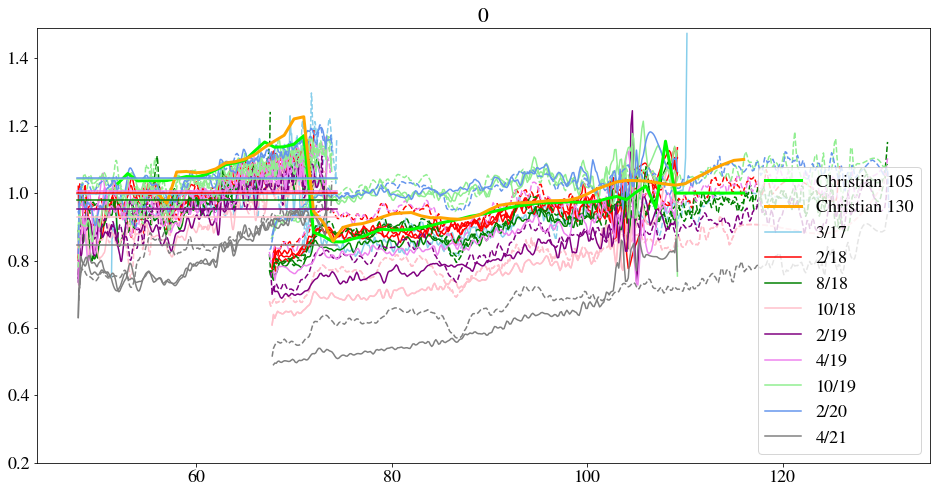

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

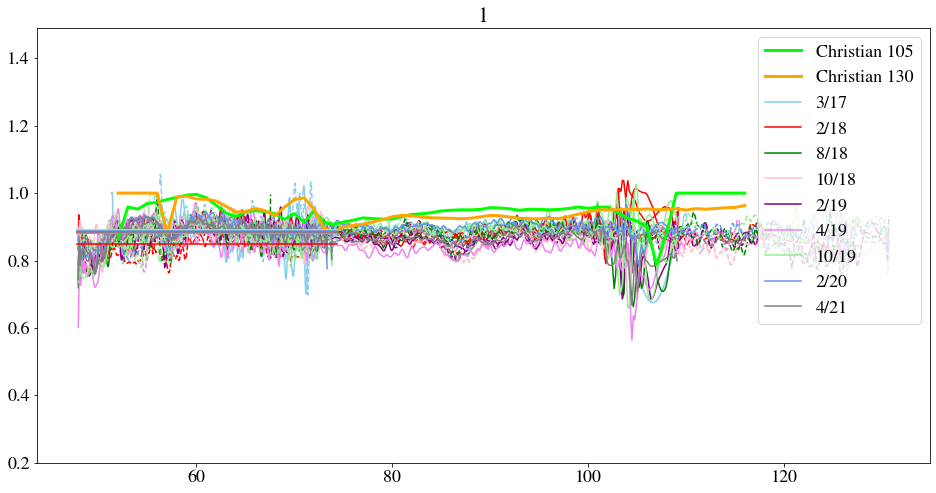

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

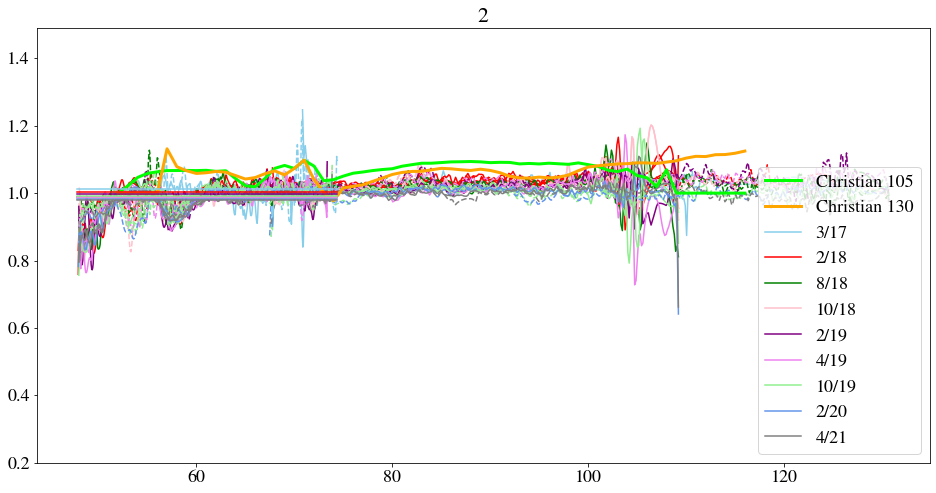

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

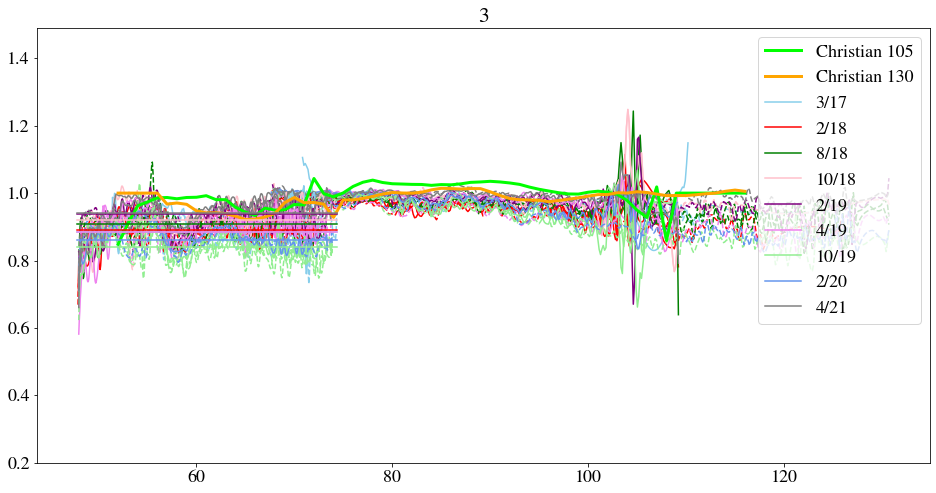

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

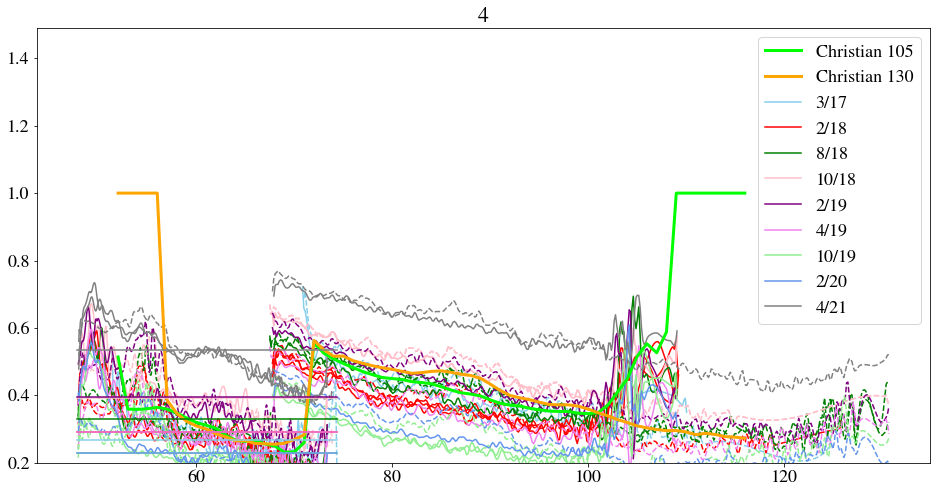

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

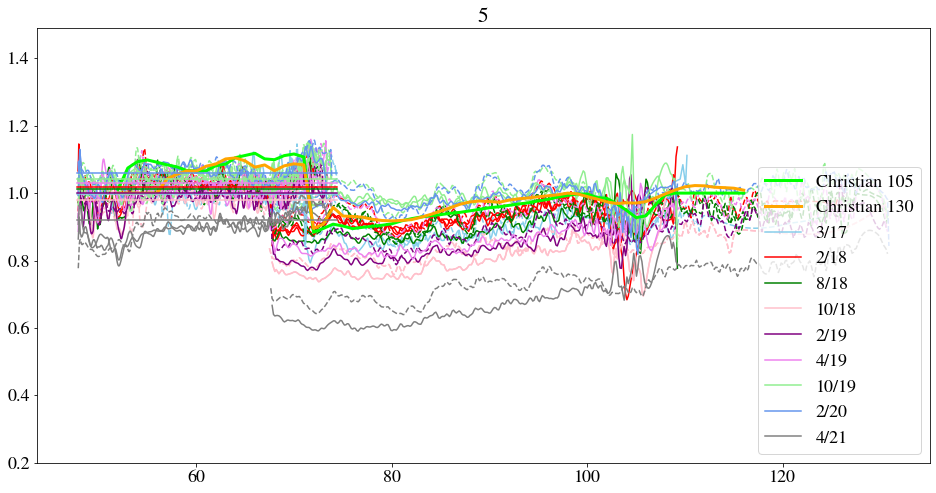

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

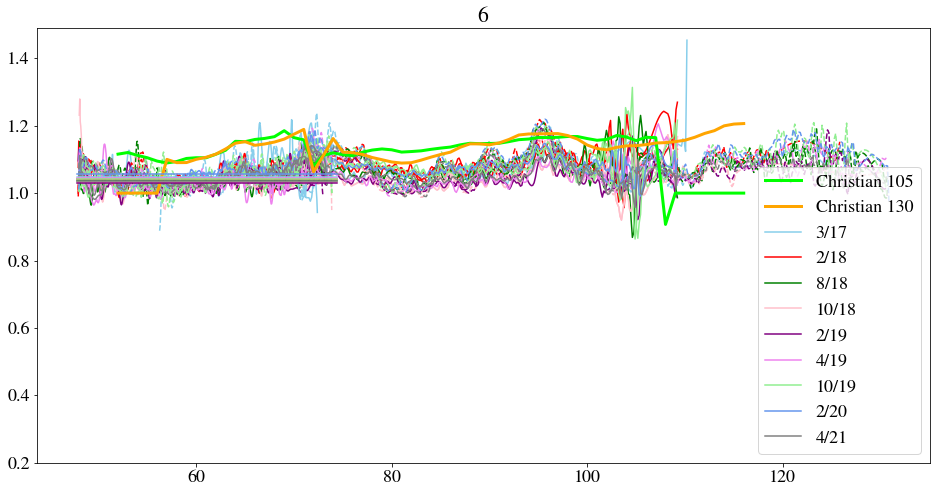

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

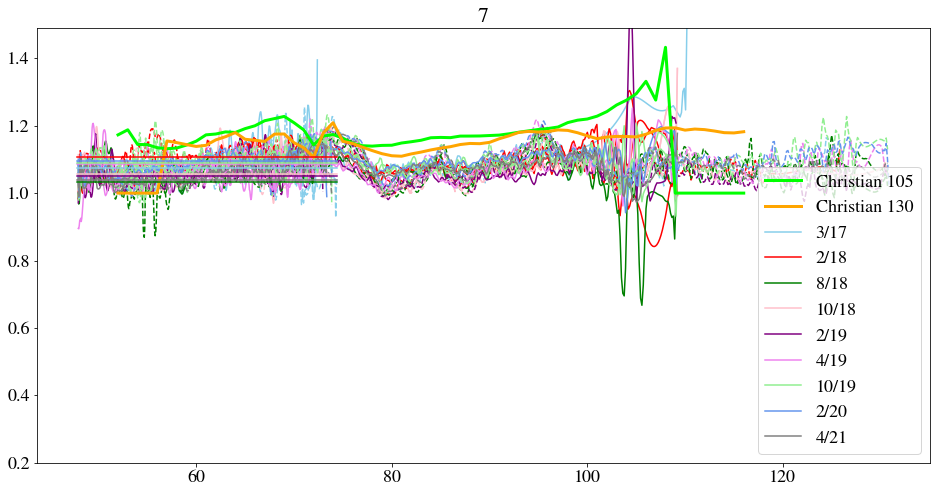

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

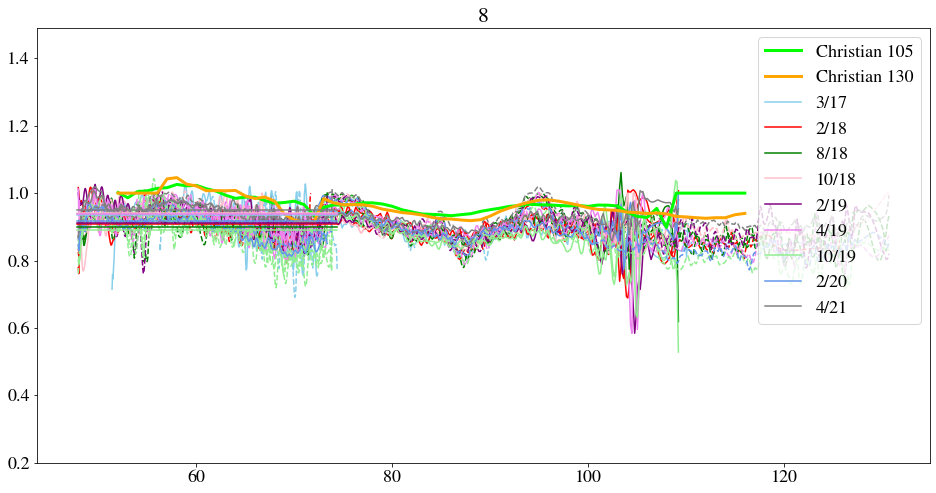

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

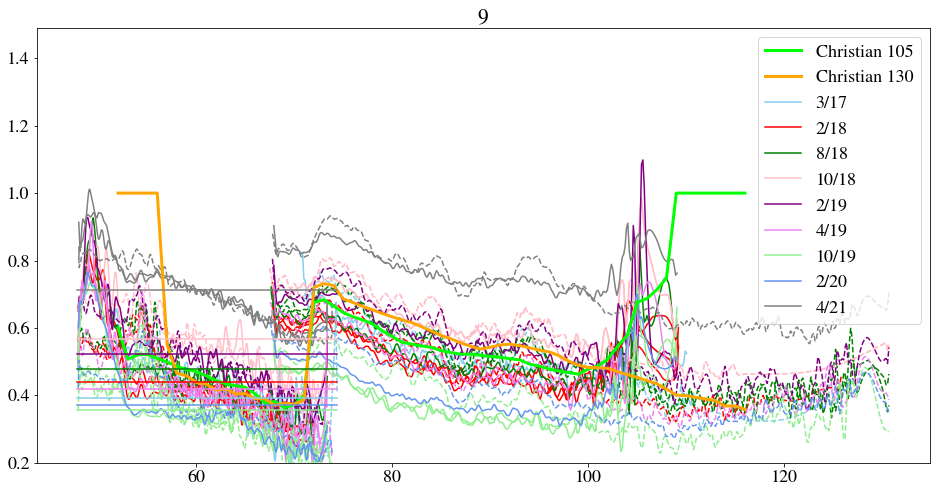

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

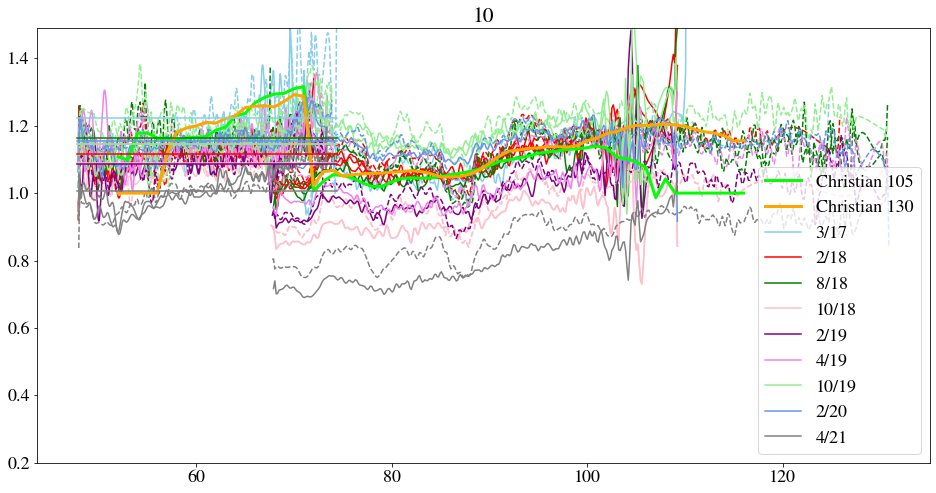

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

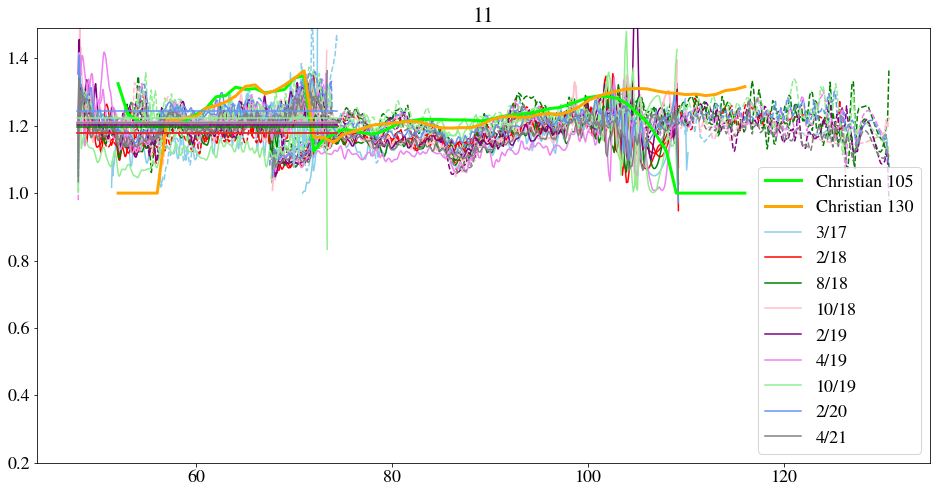

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

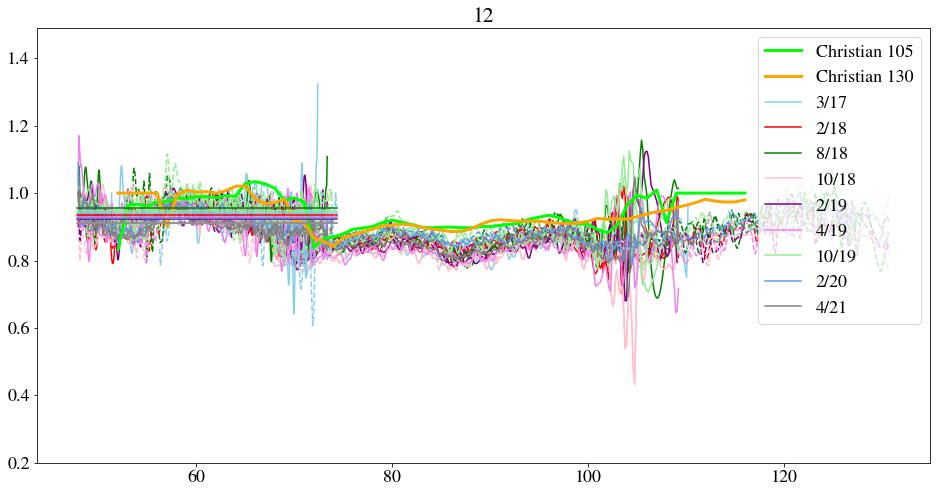

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

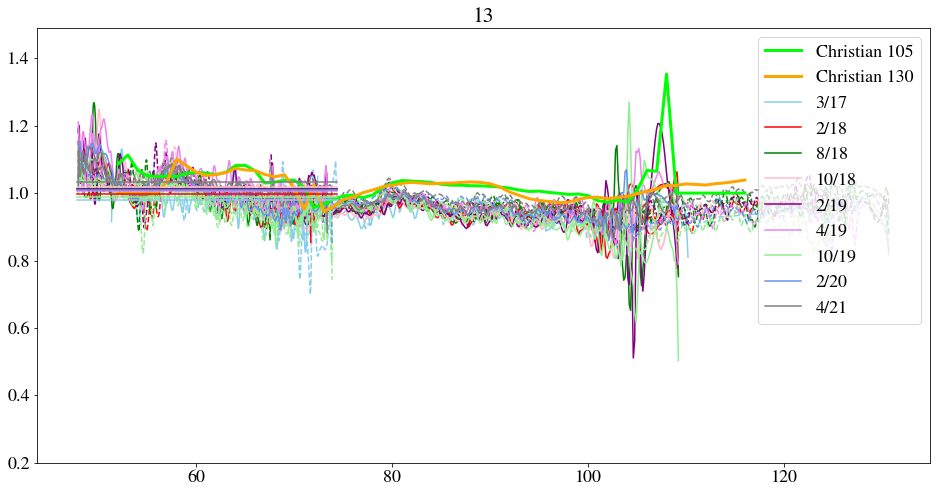

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

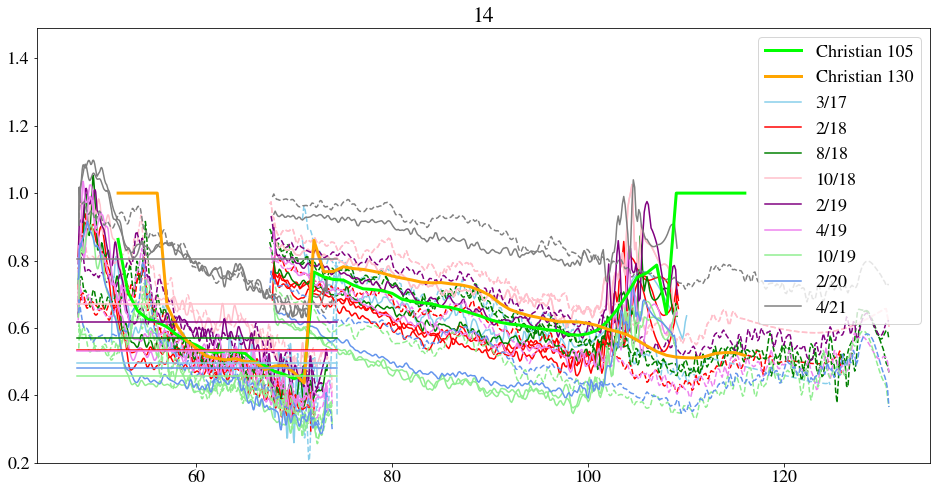

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

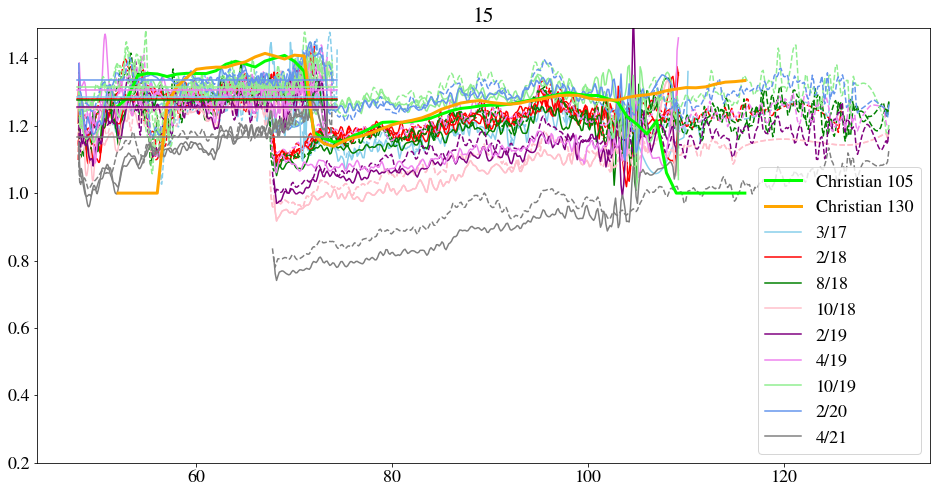

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

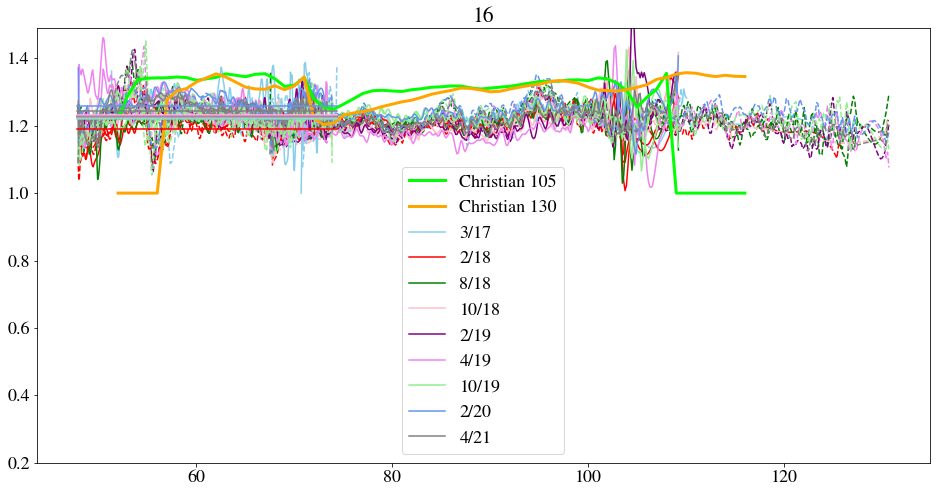

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

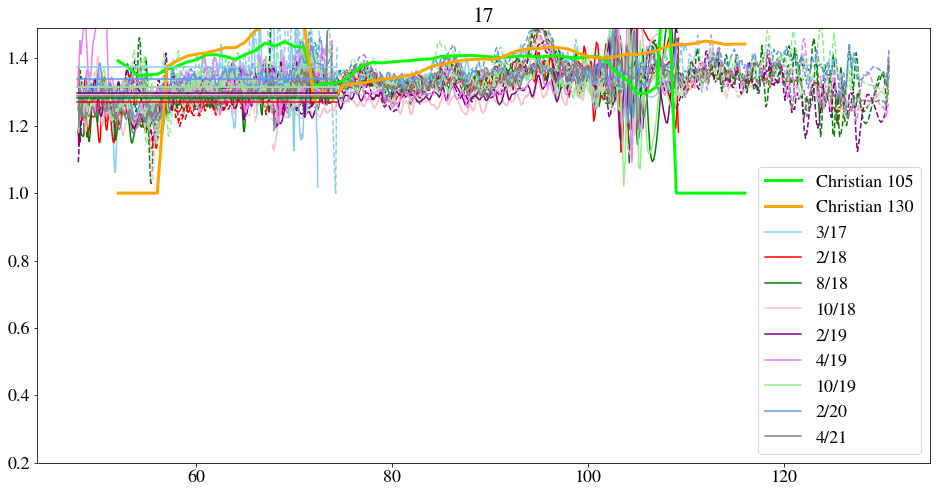

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

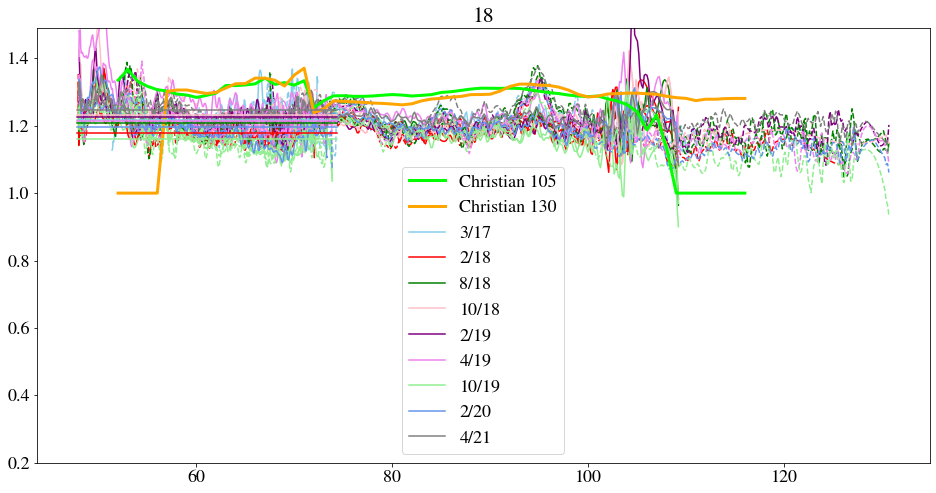

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

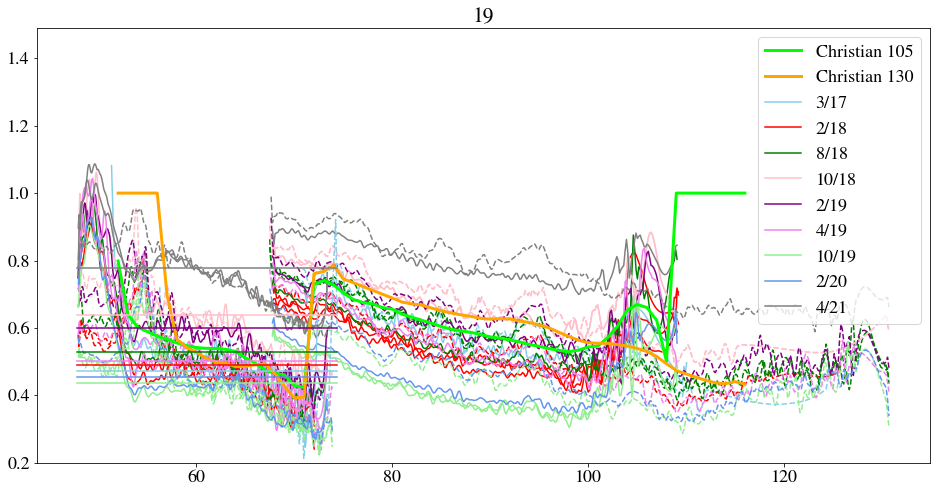

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

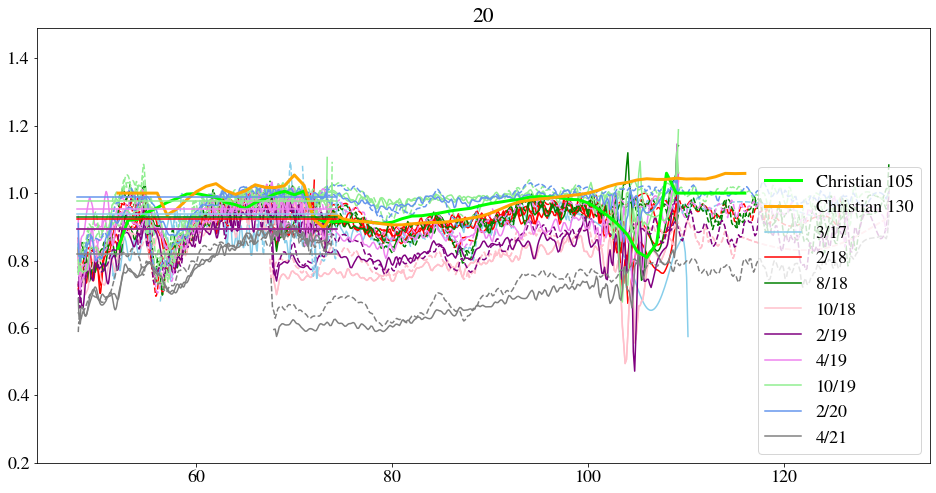

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

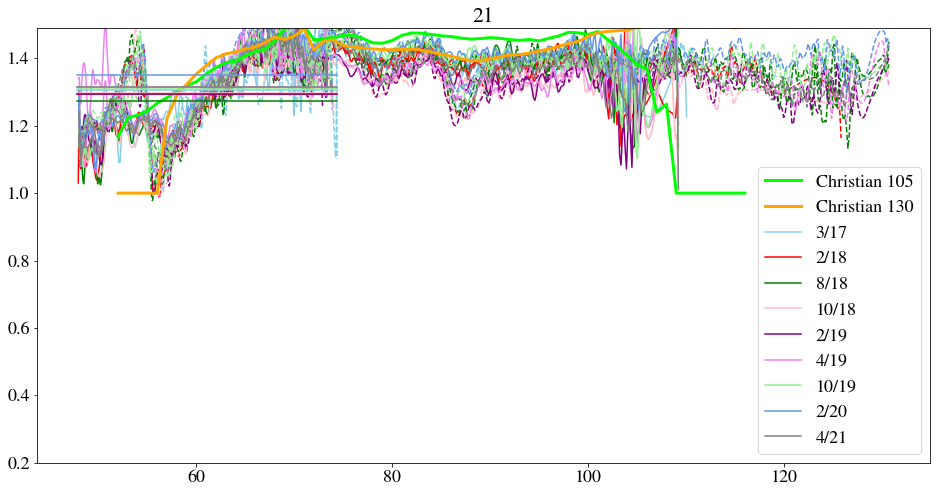

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

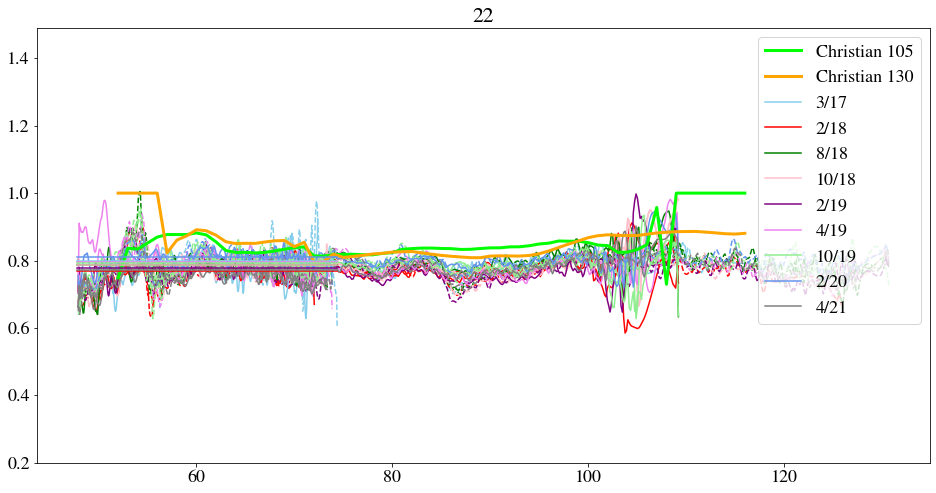

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

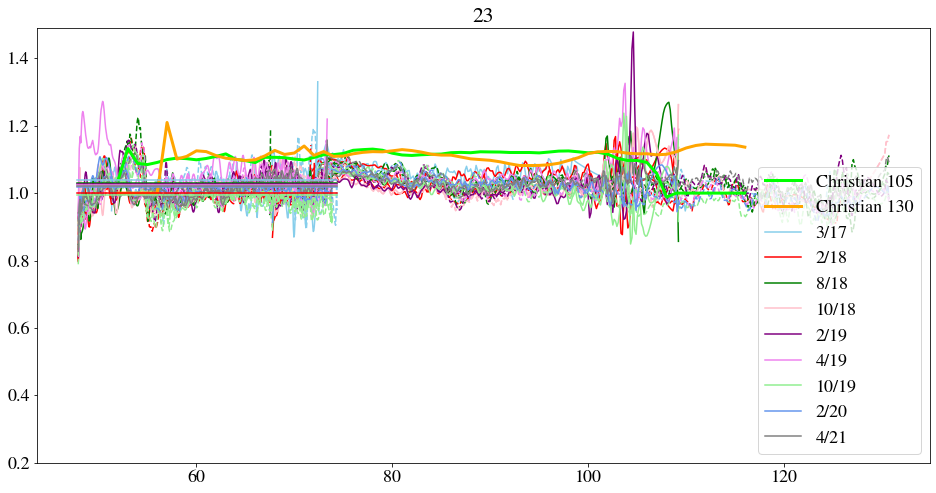

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

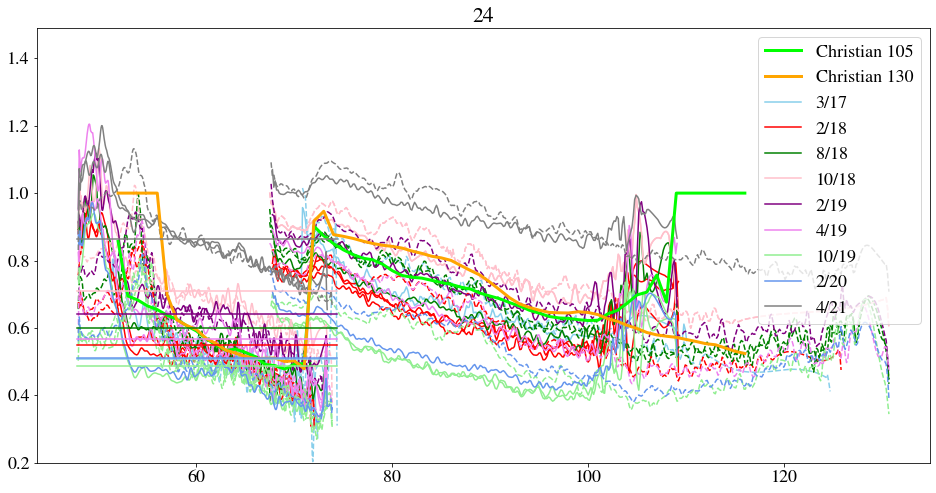

In [32]:
# Plot of  median spaxel spectra over median total spectra (except bad illuminated column)
from fifipy.stats import biweight

colors = ['skyblue','red','green','pink','purple','violet','lightgreen','cornflowerblue','gray','black']
_, idx = np.unique(dates, return_index=True)  # Ordered as original
udates = dates[np.sort(idx)]

ndates = len(udates)
ssi = []
for i in range(ndates):
    ssi.append(np.ones(25))

#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,2,3,6,7,8,11,12,13,16,17,20,21,22]
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    mm = []
    for i in range(ndates):
        mm.append([])
    for w, s, d, dic in zip(waves1, spatspectra1, dates1, dichroics1):
        meds,sigs = biweight(s[mask,:], axis = 0)
        idw = (w > 70) & (w < 85)
        m,sigs = biweight(s[ispax,idw]/meds[idw]) 
        for ud, mi, c in zip(udates, mm, colors):
            if d == ud:
                color = c
                #if dic == 105:
                #    mi.append(m)
        if dic == 105:
            line = '-'
        else:
            line = '--'
        ax.plot(w, s[ispax,:]/meds, line, color=color)
    for w, s, d, dic in zip(waves2, spatspectra2, dates2, dichroics2):
        meds,sigs = biweight(s[mask,:], axis = 0)
        idw = (w > 50) & (w < 70)
        m,sigs = biweight(s[ispax,idw]/meds[idw])    
        for ud, mi, c in zip(udates, mm, colors):
            if d == ud:
                color = c
                if dic == 130:
                    mi.append(m)
        if dic == 105:
            line = '-'
        else:
            line = '--'
        ax.plot(w, s[ispax,:]/meds, line, color=color)
    ax.plot(wch, ff105[:,ispax],color='lime',label='Christian 105',linewidth=3)
    ax.plot(wch, ff130[:,ispax],color='orange',label='Christian 130',linewidth=3)
    ax.set_title(str(ispax))
    for m, col, s, ud in zip(mm,colors,ssi,udates):
        m = np.array(m)
        medm = np.nanmedian(m)
        if np.isfinite(medm):
            ax.set_ylim(medm-0.5, medm+0.5)
            ax.plot(w, np.full(len(w), medm), color=col, label = ud)
            s[ispax] = medm
        else:
            s[ispax] = 1.
    ax.set_ylim([0.2,1.49])
    ax.legend()
    plt.show()


## Step 2

Compute spectral flat which applies to the single spaxel.
This will depend on the order and dichroic, possibly because there is component of grating efficiency varying with order and different transmittance of the dichroic. 

We will get rid of this dependency to compute the "real" spectral flat inside each spaxel by using all dichroic and orders. "Real" means due only to the different response of the spexels, not to varying illumination at different wavelengths.

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

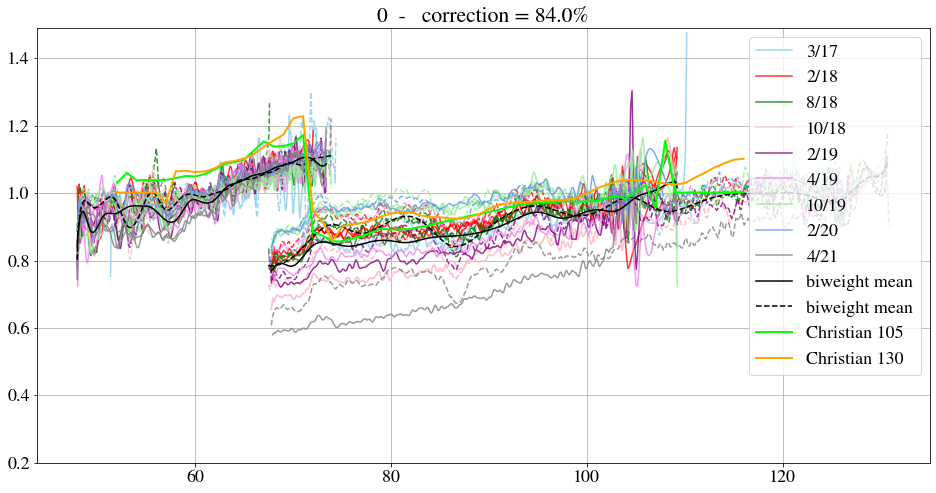

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

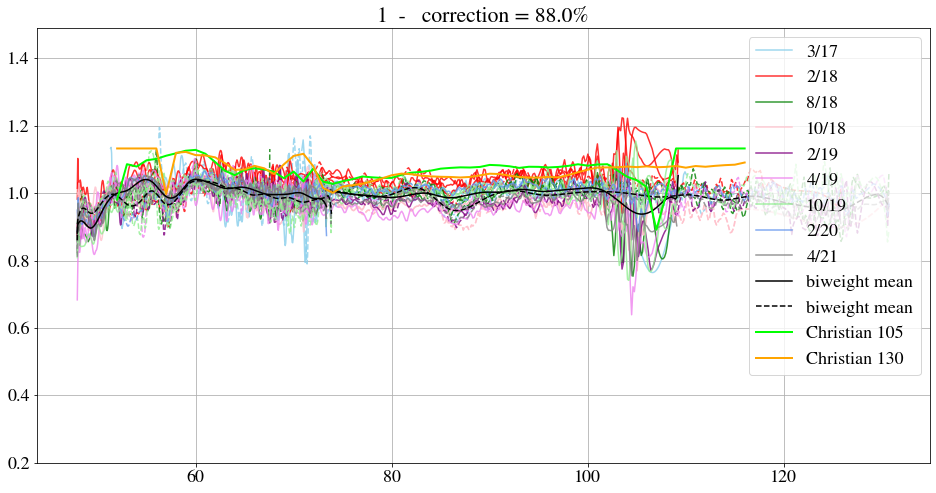

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

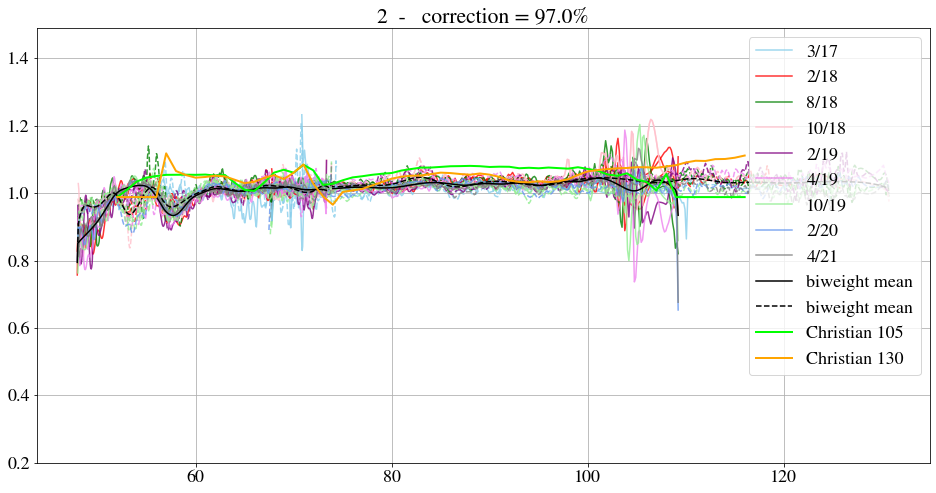

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

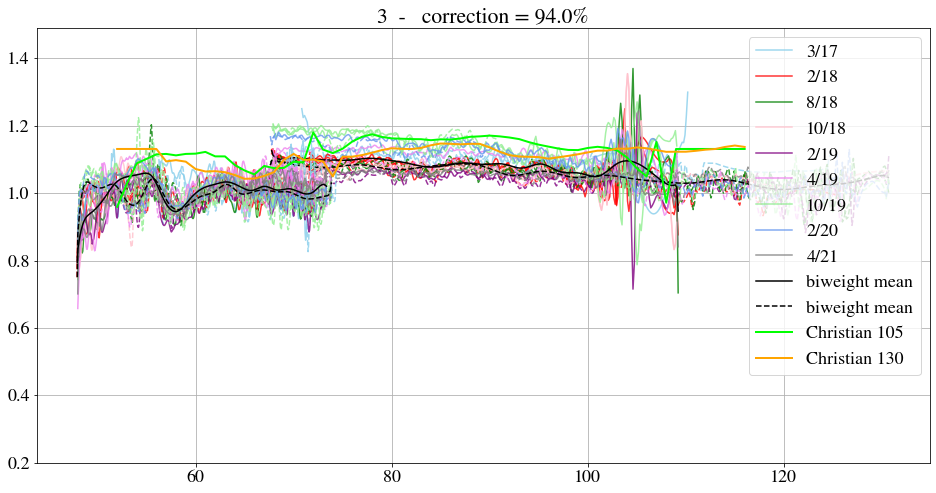

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

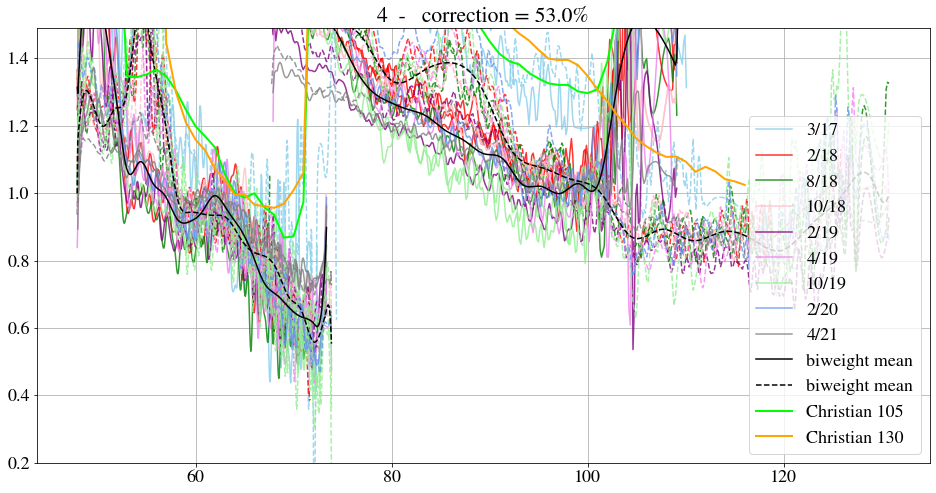

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

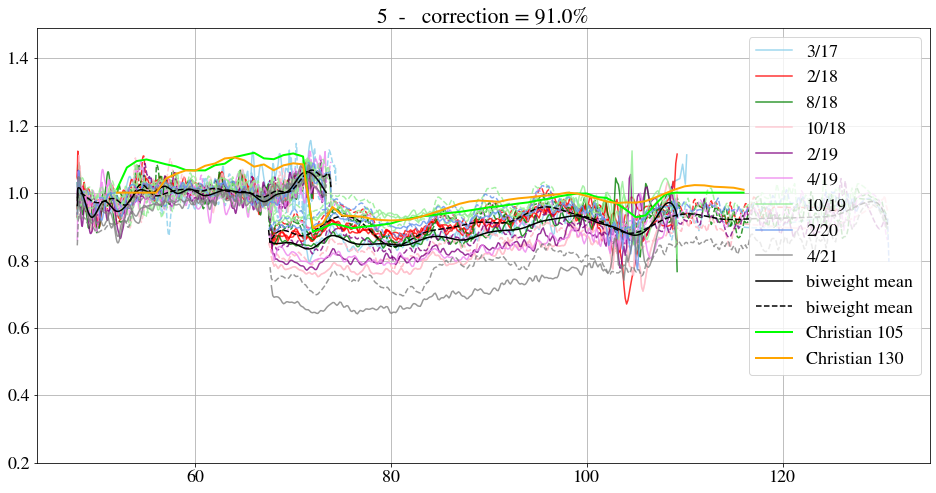

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

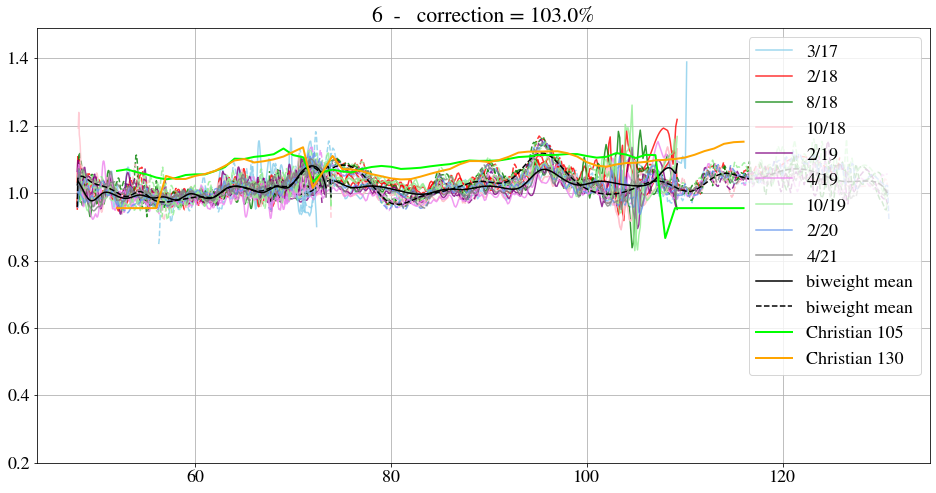

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

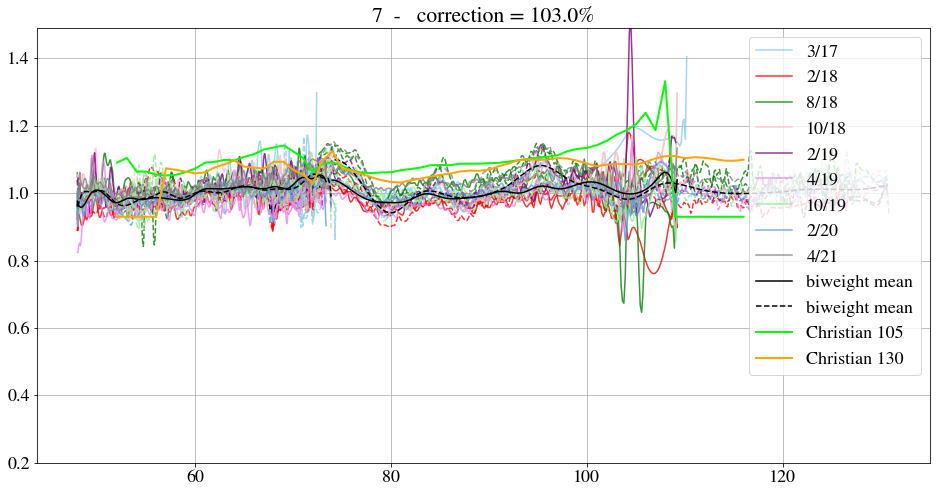

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

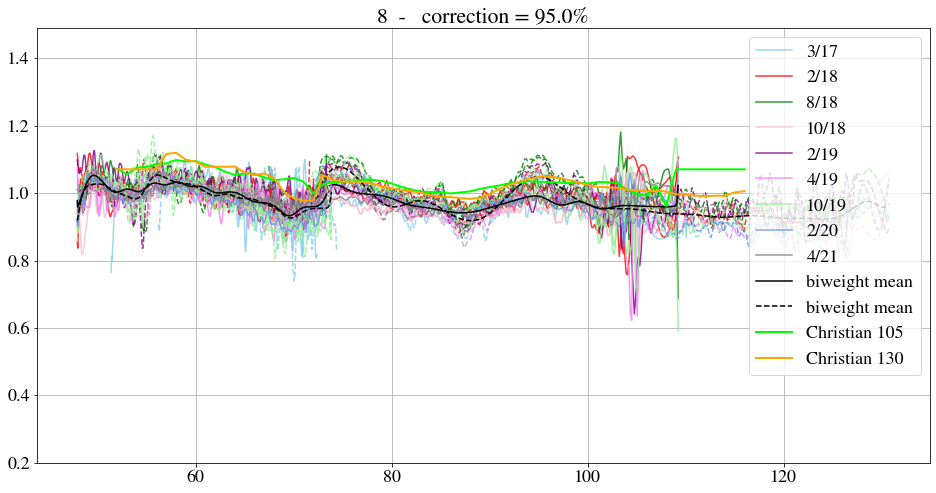

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

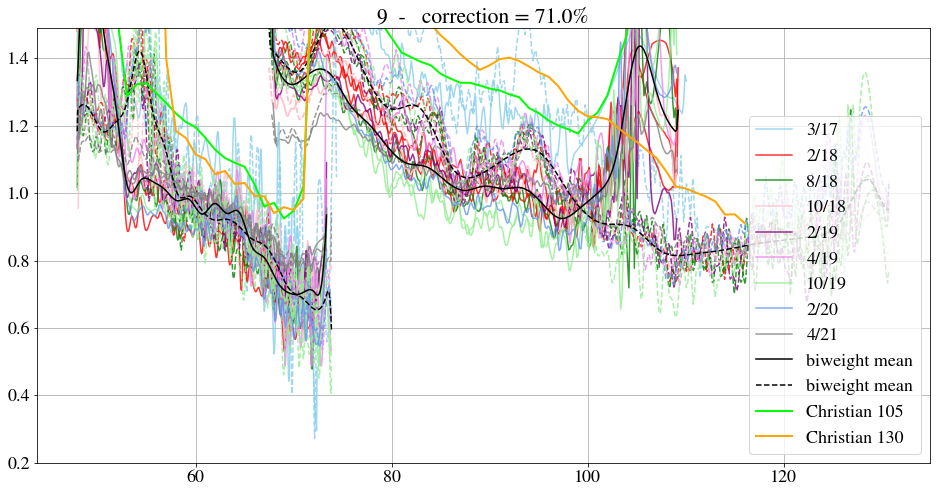

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

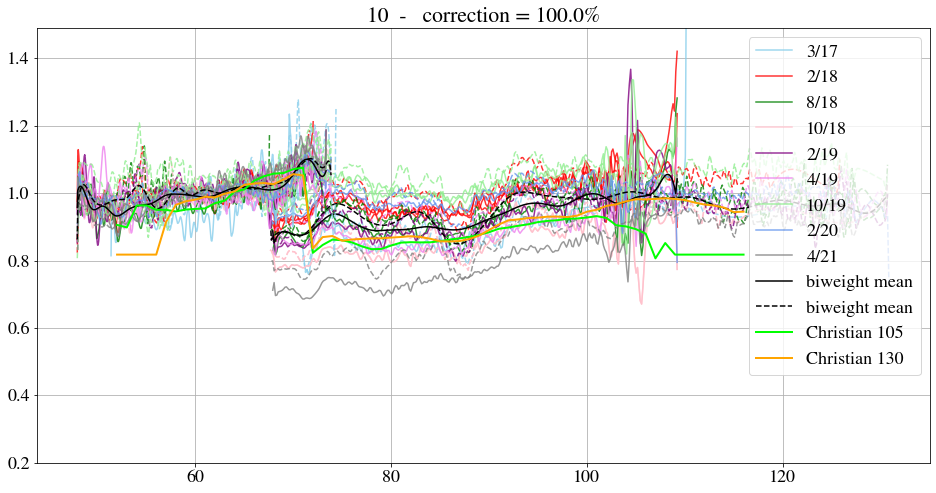

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

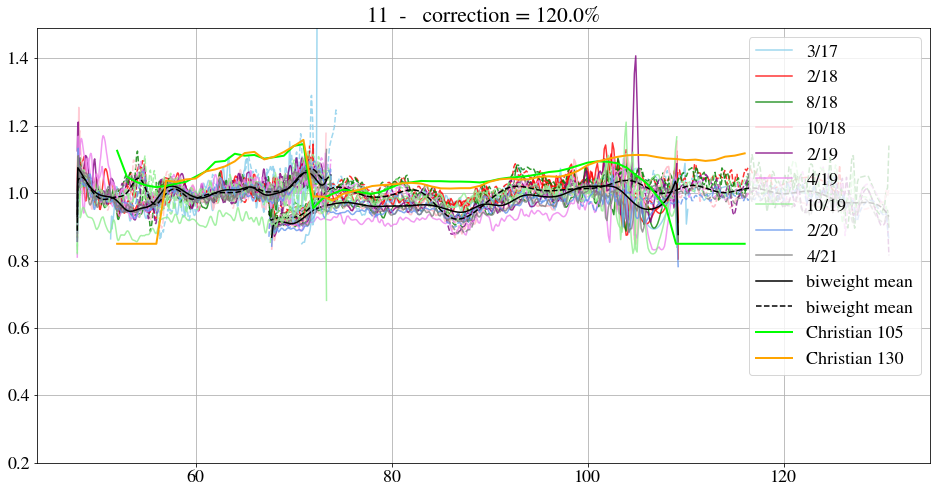

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

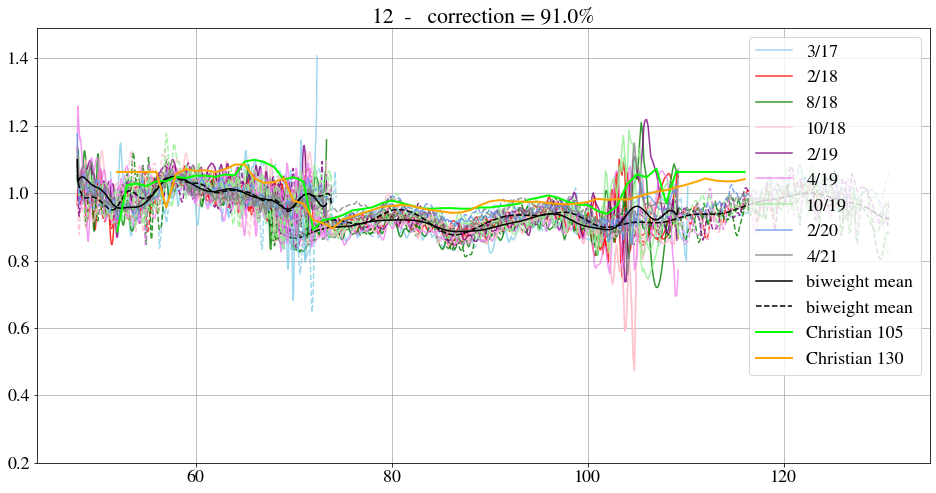

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

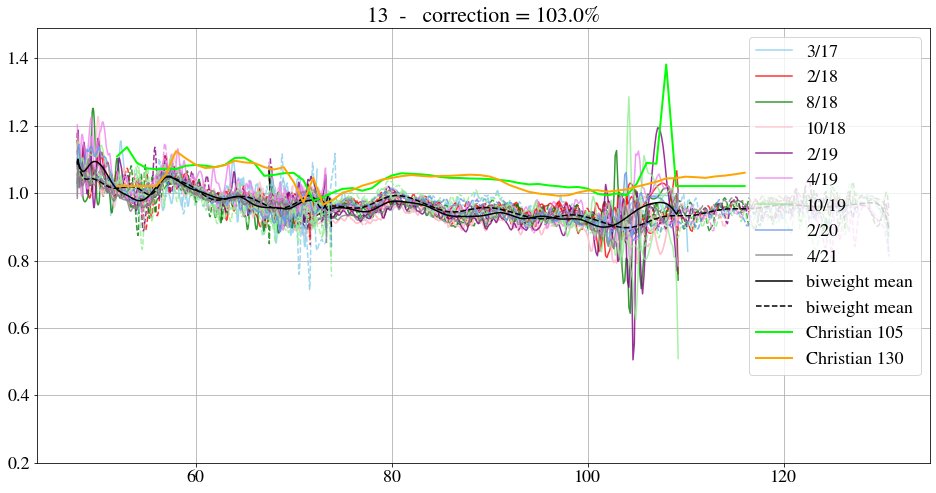

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

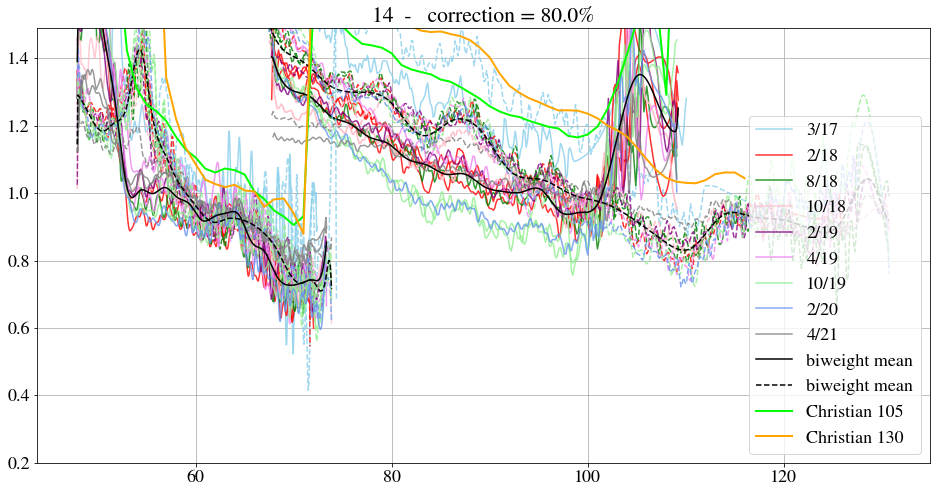

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

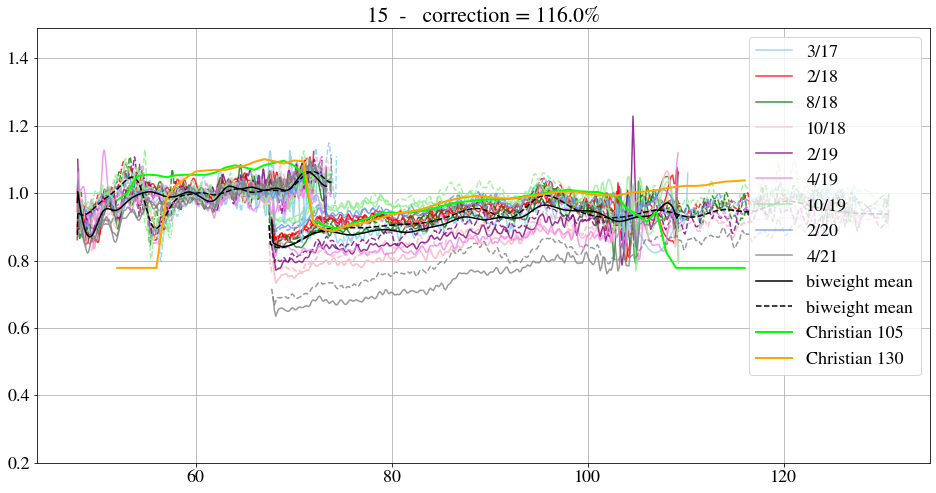

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

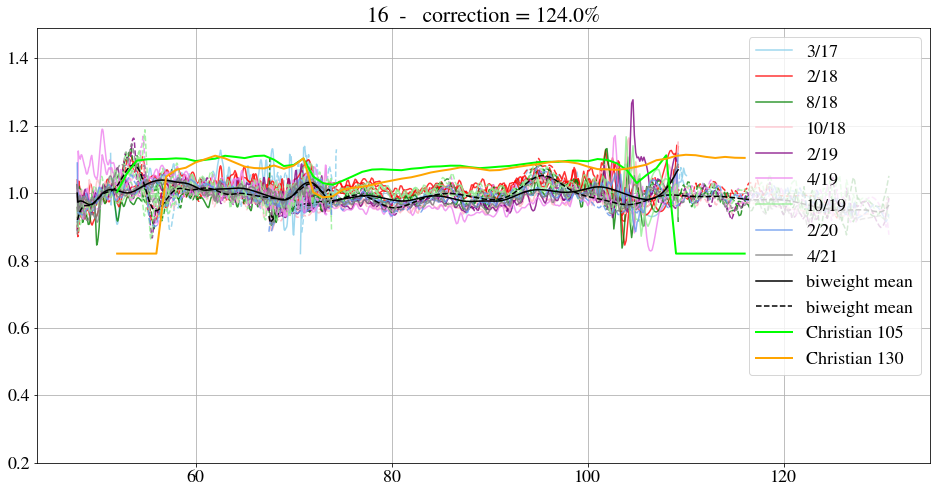

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

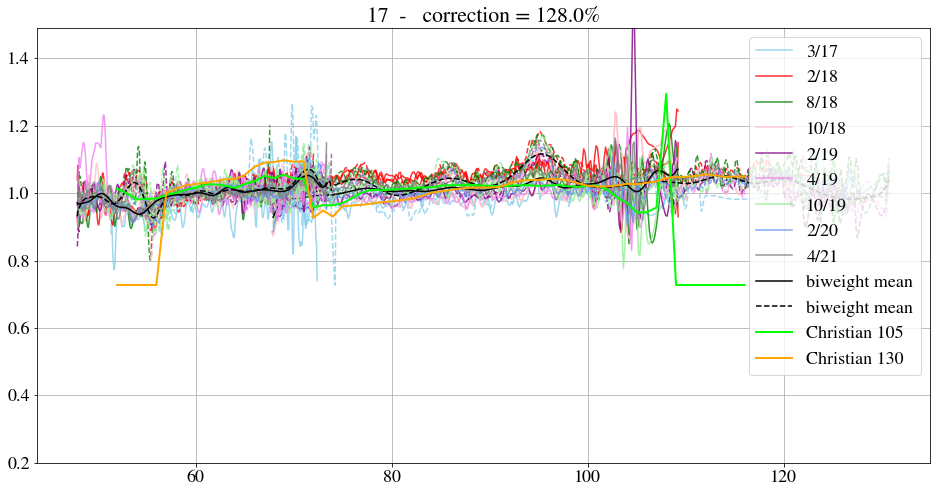

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

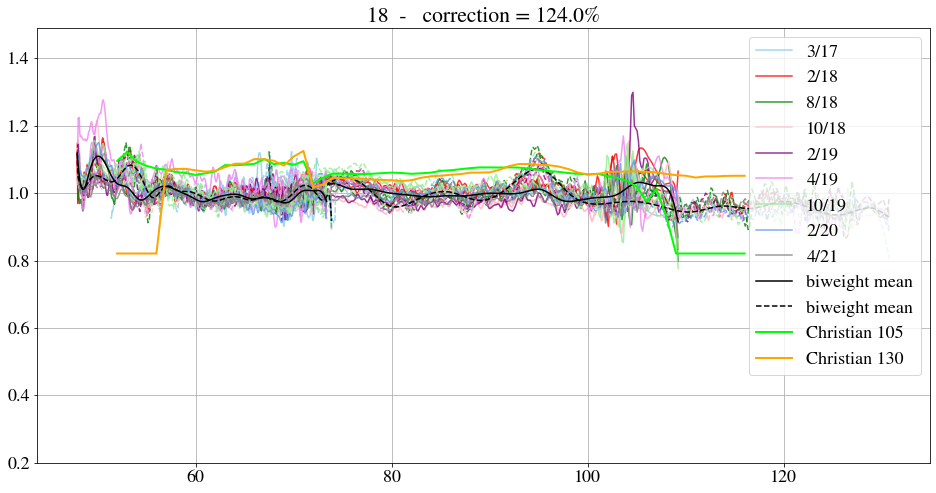

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

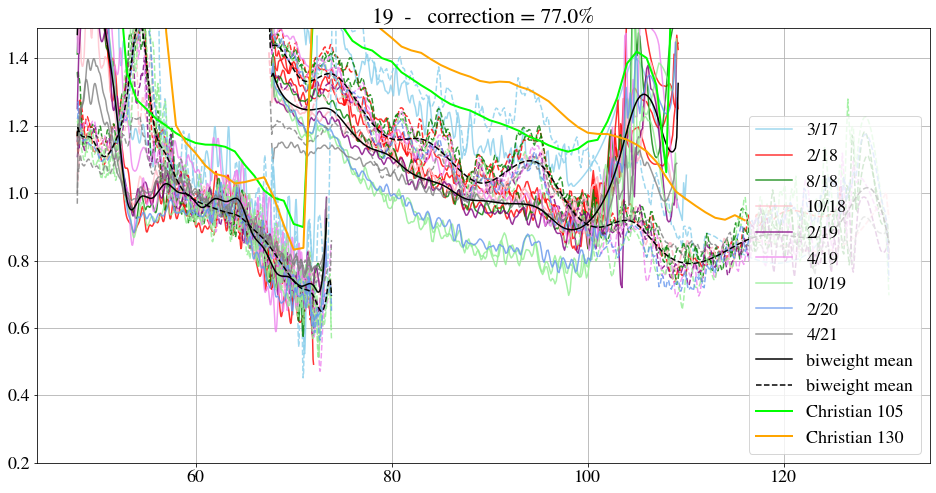

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

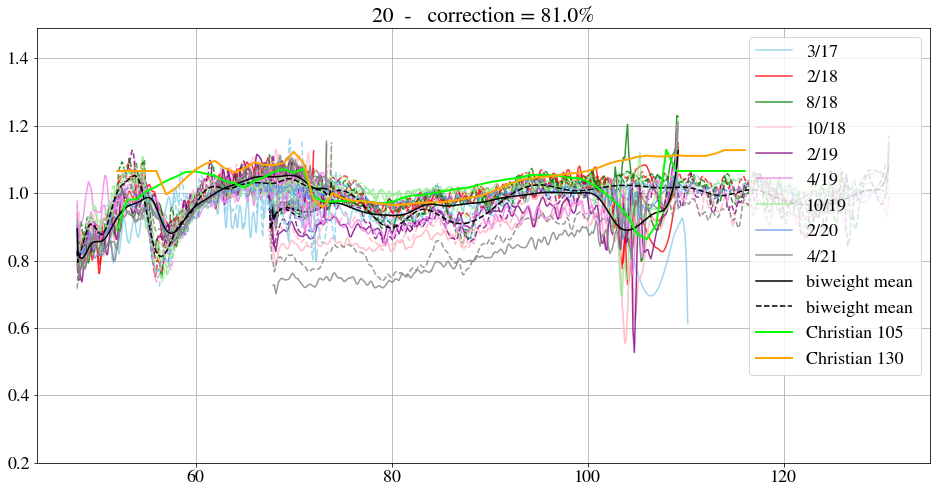

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

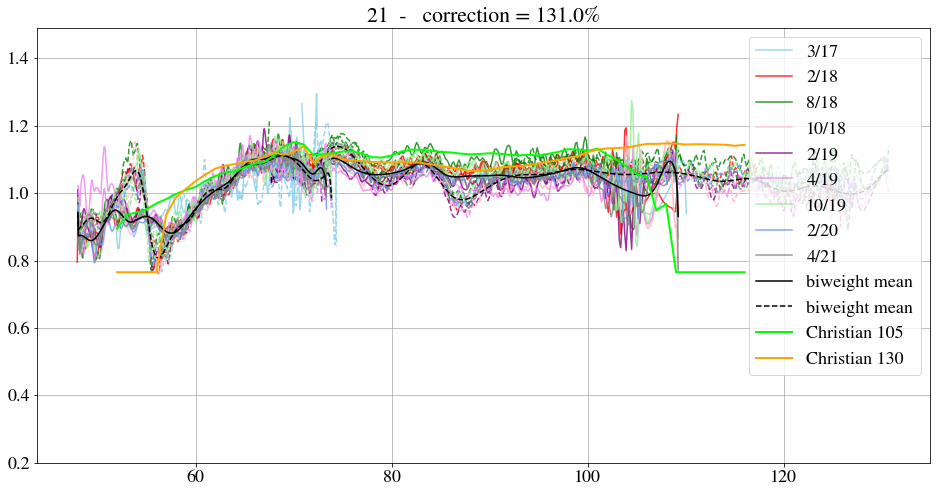

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

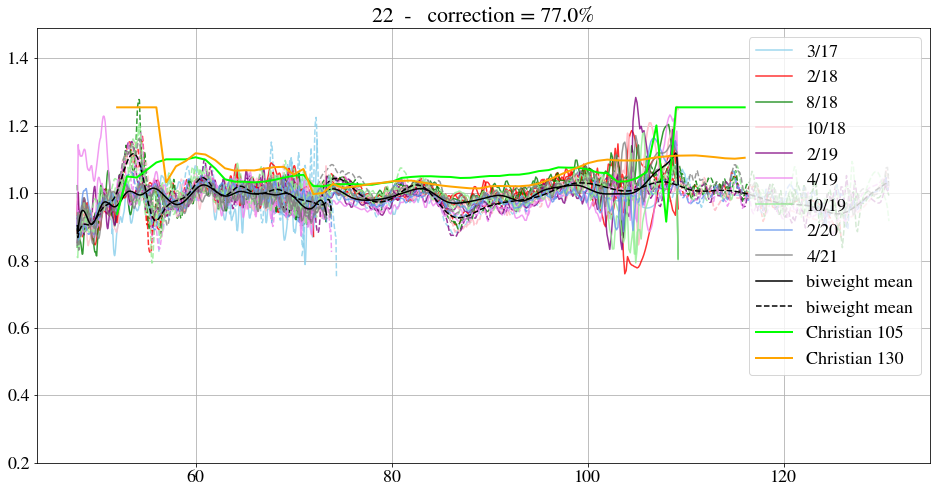

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

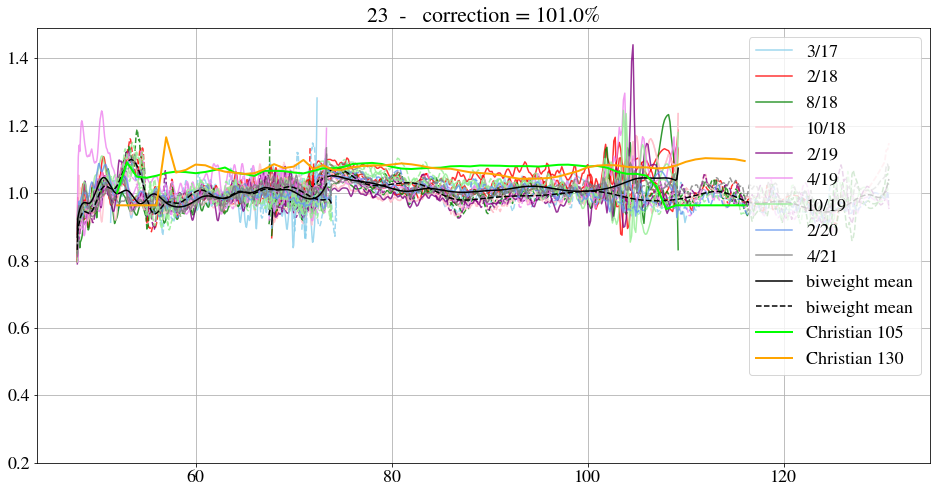

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

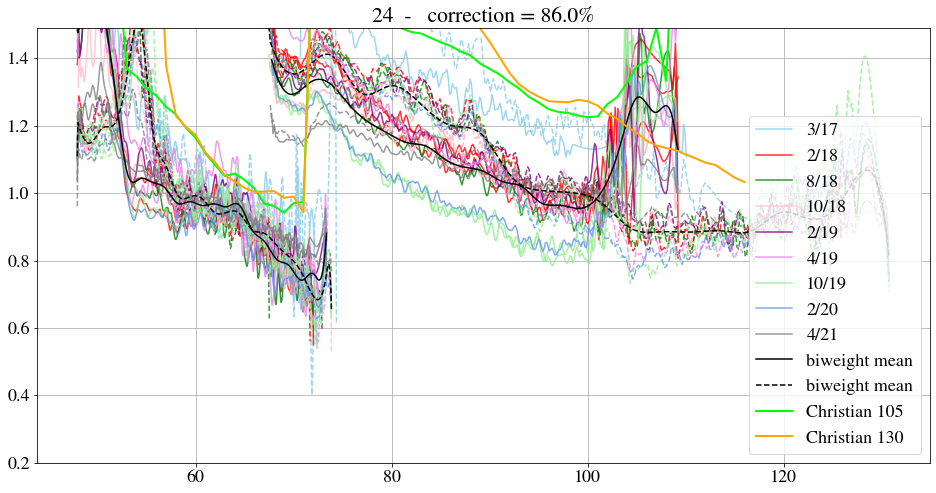

In [33]:
from fifipy.stats import biweight


def splineFitting(w, x):
    from scipy.interpolate import LSQUnivariateSpline
    idx = np.isfinite(x)
    bad = ~idx
    ww = w[idx]; xx = x[idx]
    #idx = np.argsort(ww)
    #ww=ww[idx]; xx=xx[idx]
    t = ww[np.arange(1,np.size(ww)-1,np.size(ww)//20)]
    curve = LSQUnivariateSpline(ww,xx,t)
    output = curve(w)
    #idx = np.isfinite(x)
    output[bad] = np.nan
    return output

spaxelSpectralFlat1A = []
spaxelSpectralFlat2A = []
spaxelSpectralFlat1B = []
spaxelSpectralFlat2B = []
#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,2,3,6,7,8,11,12,13,16,17,20,21,22]
#mask = range(25)

for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    specA = []
    specB = []
    dold=''
    for w, s, d, dic in zip(waves1, spatspectra1, dates1, dichroics1):
        meds,sigs = biweight(s[mask,:], axis = 0)
        for ud, si, c in zip(udates, ssi, colors):
            if d == ud:
                color = c
                ss = si
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        if d != dold:
            ax.plot(w, s[ispax,:]/meds/ss[ispax], line, label = d, color=color,alpha=0.8)
            dold = d
        else:
            ax.plot(w, s[ispax,:]/meds/ss[ispax], line, color=color,alpha=0.8) 
    specA = np.array(specA)
    ssf,sigs = biweight(specA, axis=0)
    # Should we smooth ?
    ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, color='black')
    spaxelSpectralFlat1A.append(ssf)
    specB = np.array(specB)
    ssf,sigs = biweight(specB, axis=0)
    # Should we smooth ?
    ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, '--', color='black')
    spaxelSpectralFlat1B.append(ssf)

    specA = []
    specB = []
    for w, s, d, dic in zip(waves2, spatspectra2, dates2, dichroics2):
        meds,sigs = biweight(s[mask,:], axis = 0)
        for ud, si, c in zip(udates, ssi, colors):
            if d == ud:
                color = c
                ss = si
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        ax.plot(w, s[ispax,:]/meds/ss[ispax], line, color=color,alpha=0.8)
    specA = np.array(specA)
    ssf,sigs = biweight(specA, axis=0)
    # Should we smooth ?
    ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, color='black',label='biweight mean')
    spaxelSpectralFlat2A.append(ssf)
    specB = np.array(specB)
    ssf,sigs = biweight(specB, axis=0)
    # Should we smooth ?
    ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, '--', color='black',label='biweight mean')
    spaxelSpectralFlat2B.append(ssf)
    ax.plot(wch, ff105[:,ispax]/ssi[0][ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax]/ssi[0][ispax],color='orange',label='Christian 130',linewidth=2)
    
    ax.legend()
    ax.set_title(str(ispax) + '  -   correction = ' + str(ss[ispax]*100//1) + '%')
    ax.set_ylim([0.2,1.49])
    ax.grid()
    plt.show()


In [20]:
print(dichroics)

[105 105 130 130 105 105 105 105 105 130 130 130 105 105 130 130 130 105
 105 105 130 130 130 105 105 130 130 105 105 105 130 130 105 105 105 130
 130 130 130 105 105 130 130 105 105 130 130 105 105 105 130 130]


# Step 3

Run the spectral flats after correcting for common spectral flat.

In [34]:
# Copy the spectra
corrSpectra = spectra.copy()

# Apply the corrections spaxelSpectralFlat
w = waves[0]
w1 = waves1[0]
w2 = waves2[0]
for s, o, d in zip(corrSpectra, orders, dichroics):
    # Choice of flat
    if o == 1:
        wi = w1
        if d == 105:
            sflat = spaxelSpectralFlat1A
        else:
            sflat = spaxelSpectralFlat1B
    else:
        wi = w2
        if d == 105:
            sflat = spaxelSpectralFlat2A
        else:
            sflat = spaxelSpectralFlat2B
    # Interpolation & flat
    for i, sf in enumerate(sflat):
        sfi = np.interp(w, wi, sf)
        for j in range(16):
            s[i*16+j,:] /= sfi

            
# Recompute spat spectra using the corrected spectra
spatspectra = []
for spectrum in corrSpectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

/Users/dfadda/Python/fifipy/fifipy/spectra.py:87: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:80: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))


In [35]:
# Check on spatspectra and update si (spatial flats)
w = waves[0]
for ispax in range(25):
    med = []
    for ss, date in zip(spatspectra, dates):
        smed,sigs = biweight(ss, axis=0)
        for ud, ssi_ in zip(udates, ssi):
            if date == ud:
                si = ssi_
        mmed, sigs = biweight(ss[ispax,:]/smed/si[ispax])
        med.append(mmed)
    med = np.array(med)
    if Test:
        print('Spaxel ', ispax+1)
    for ud, si in zip(udates, ssi):
        mi,sigs = biweight(med[dates == ud])
        si[ispax] *= mi
        if Test:
            print(mi)
    if Test:
        fig,ax = plt.subplots(figsize=(16,8))
        for ss, date in zip(spatspectra, dates):
            smed,sigs = biweight(ss, axis=0)
            for ud, ssi_ in zip(udates, ssi):
                if date == ud:
                    si = ssi_
            ax.plot(w, ss[ispax,:]/smed/si[ispax])
        ax.set_title('spaxel '+ str(ispax))
        ax.grid()
        ax.set_ylim(0,2)
        plt.show()

In [36]:
Test=True

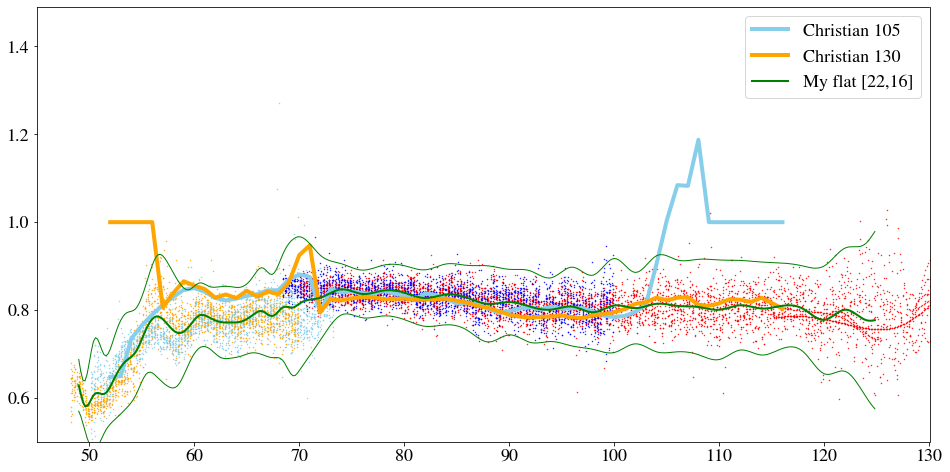

In [37]:
# TEST
%matplotlib inline
from matplotlib import rcParams
rcParams['font.family']='STIXGeneral'
rcParams['font.size']=18
rcParams['mathtext.fontset']='stix'
rcParams['legend.numpoints']=1
import matplotlib.pyplot as plt

from fifipy.spectra import computeFlatBlue
if Test:
    wdario = np.arange(49,125,0.2)
    ispax = 22-1
    ispex = 16-1
    fig,ax = plt.subplots(figsize=(16,8))
    flats = computeFlatBlue(waves,corrSpectra,spatspectra,ispax,ispex,minflat=0.5,maxflat=1.2,delta=2)
    for w,cs,ss,d,o in zip(waves, corrSpectra, spatspectra, dichroics, orders):
        if d == 105:
            if o == 1:
                color='blue'
            else:
                color='skyblue'
        else:
            if o == 1:
                color='red'
            else:
                color='orange'
        ax.plot(w,cs[ispax*16+ispex]/ss[ispax],'.',markersize=0.9,color=color,linewidth=0.5)
    ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=4)
    ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=4)
    if flats is not None:
        flat, eflat = flats
        f = flat(wdario)
        ef = eflat(wdario)
        ax.plot(wdario,f,color='green',label='My flat ['+str(ispax+1)+','+str(ispex+1)+']',linewidth=2.)
        ax.plot(wdario,f+3*ef, color='green', linewidth=1.)
        ax.plot(wdario,f-3*ef, color='green', linewidth=1.)
    ax.set_xlim([45,130])
    ax.set_ylim([0.5,1.49])
    ax.legend()
    plt.show()

In [11]:
# Only if badpixel mask has to be created for few files (one mission)
if BadPixels:
    corrSpectra = spectra.copy()

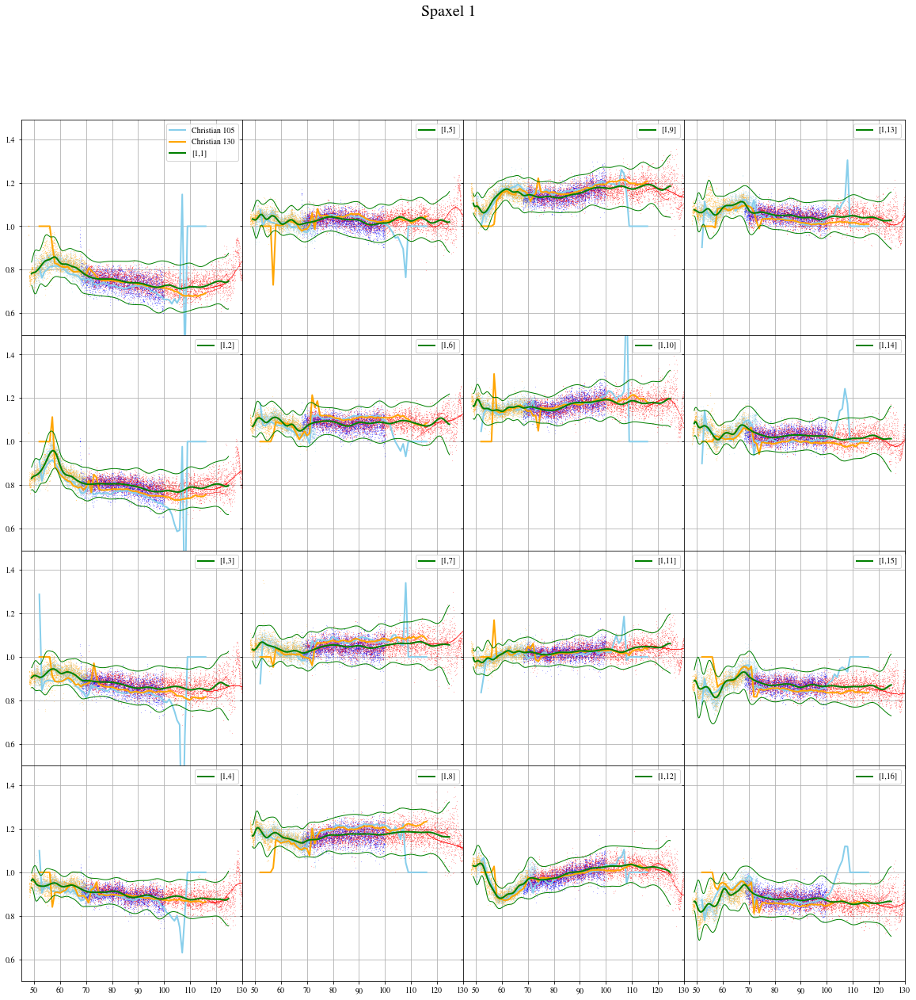

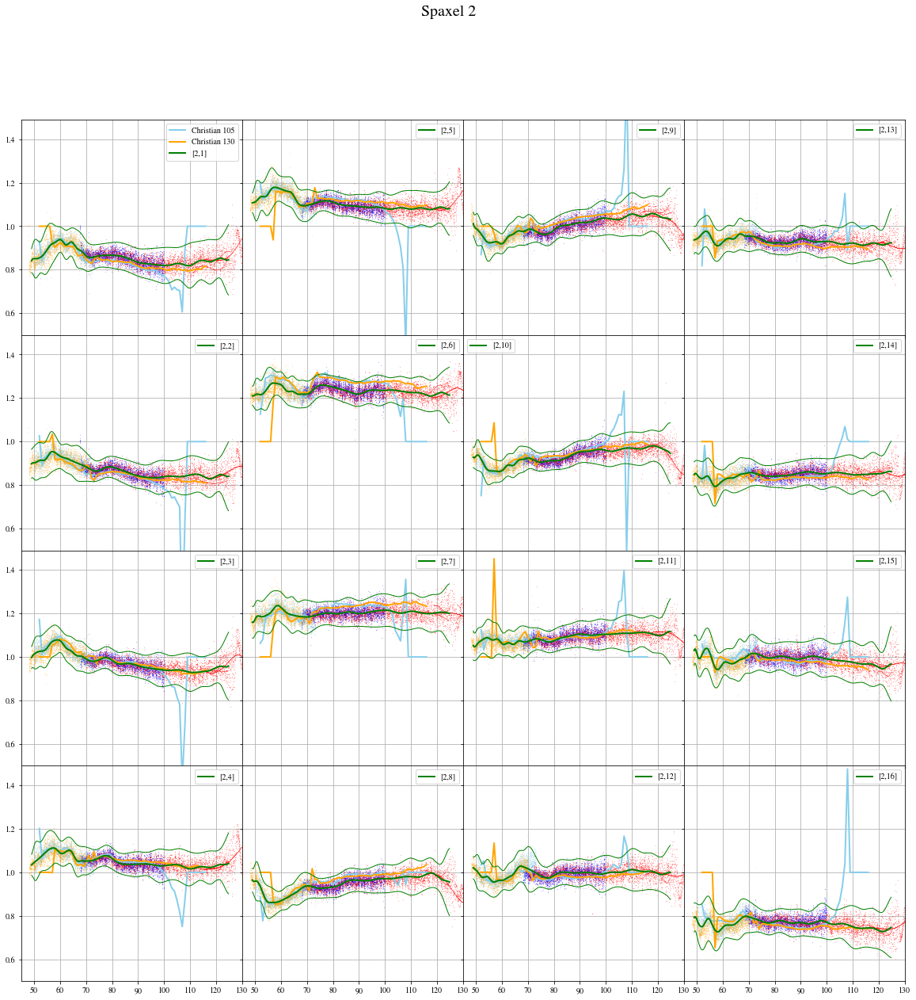

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


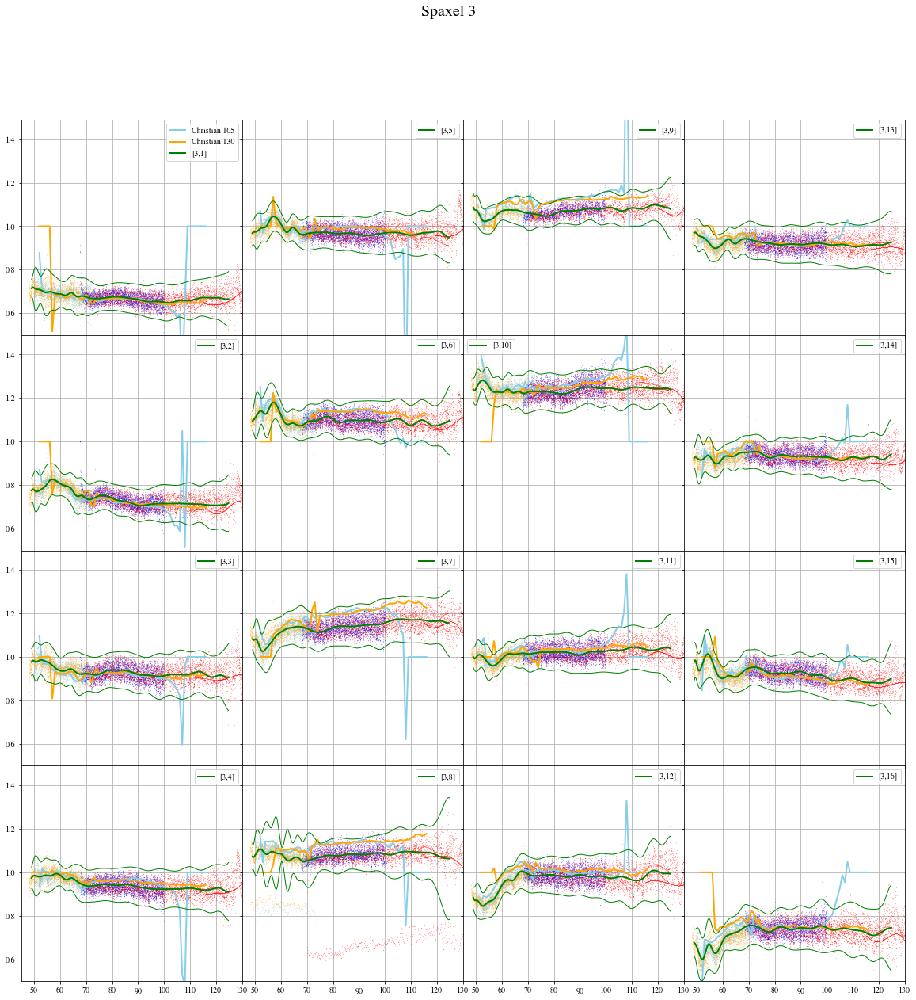

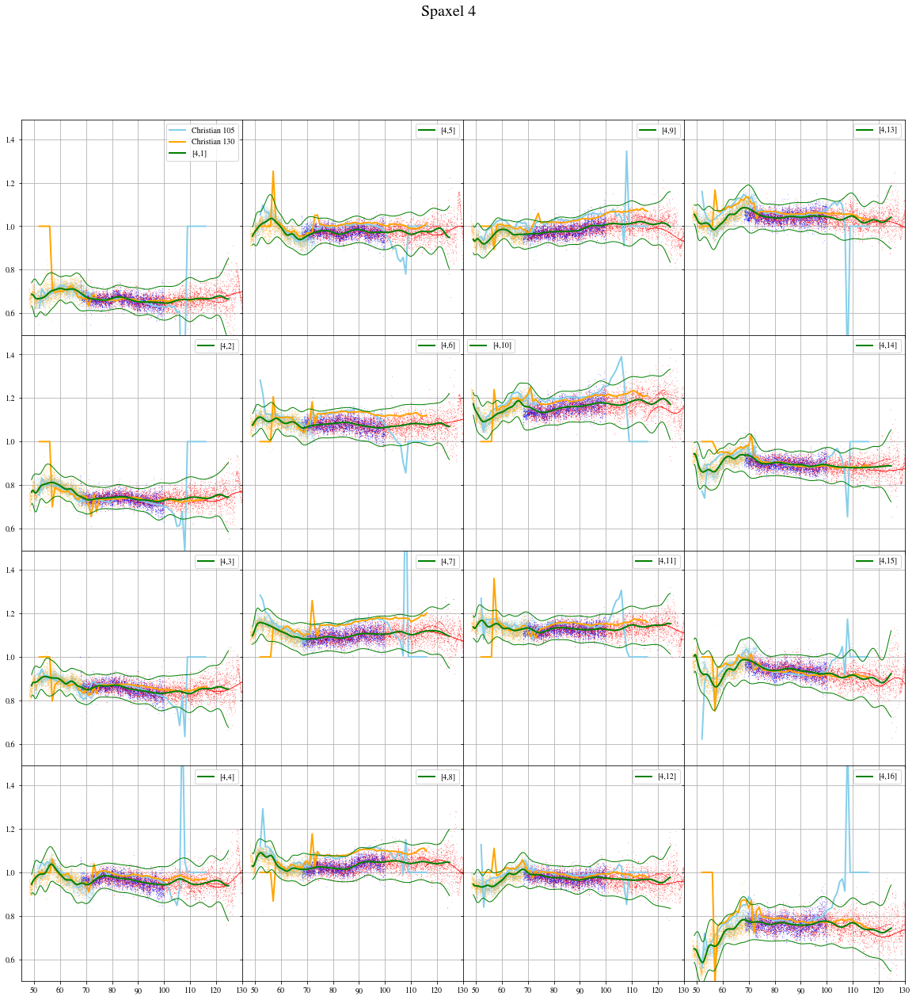

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


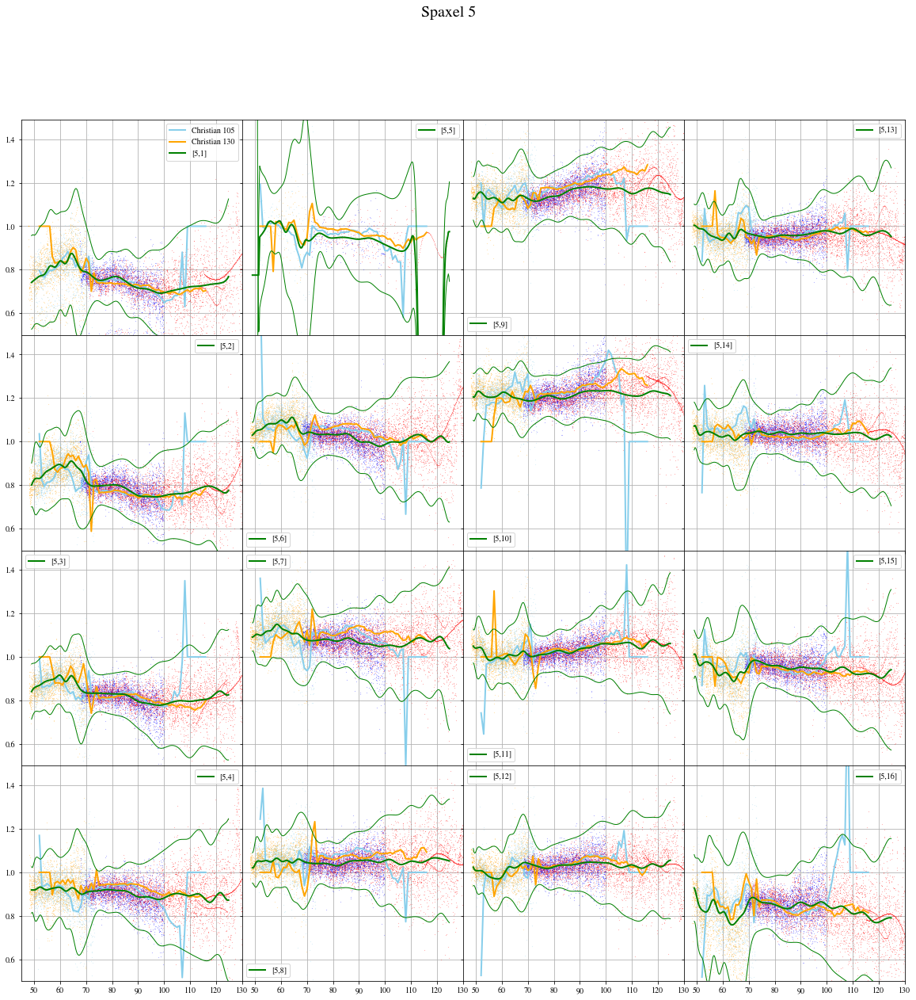

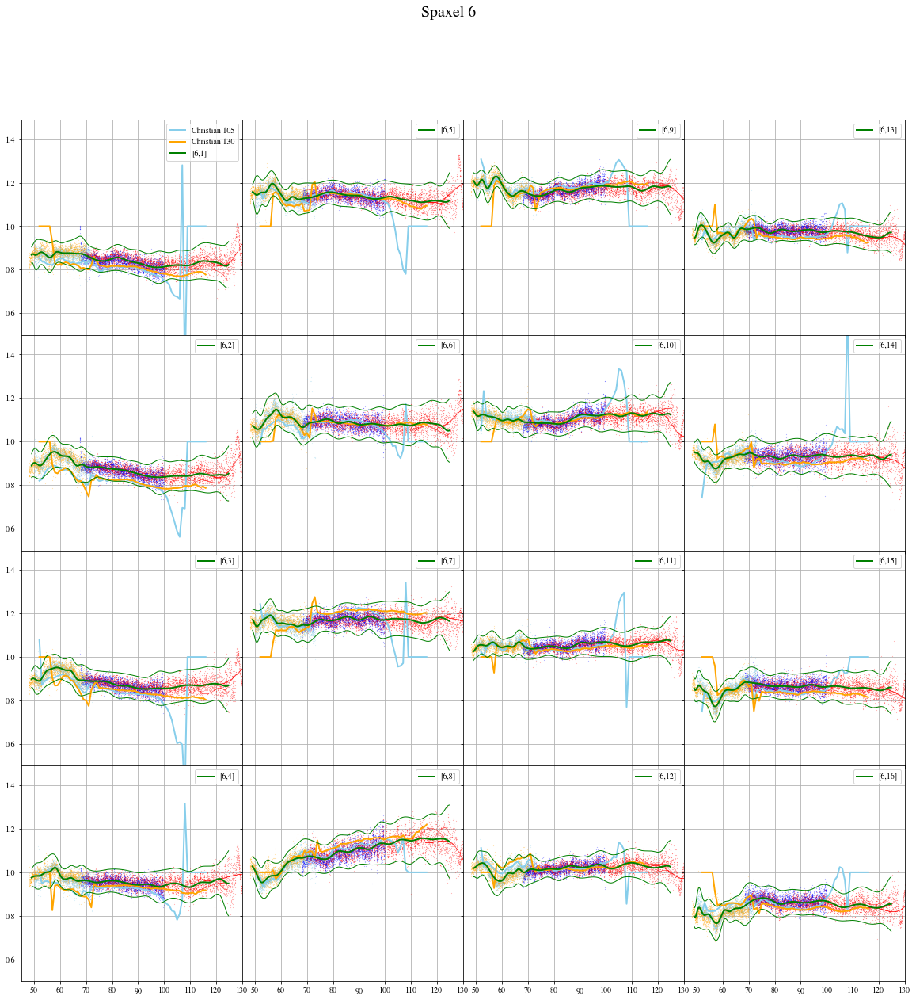

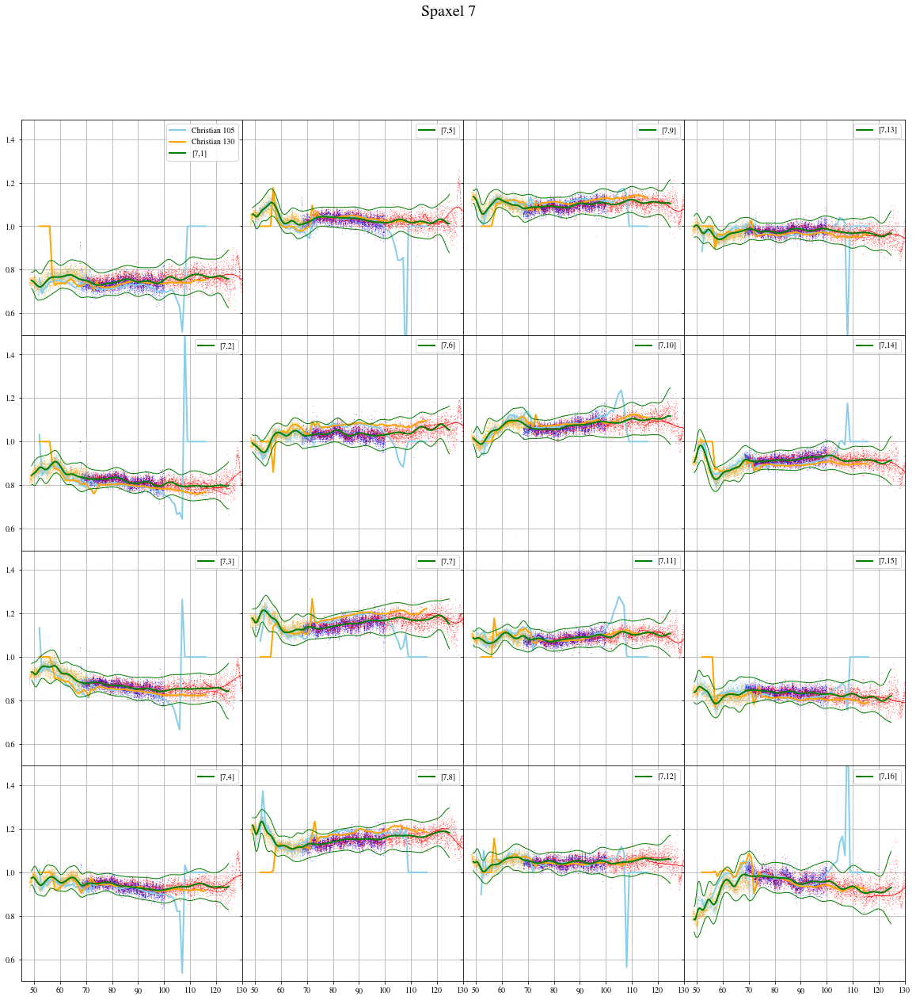

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


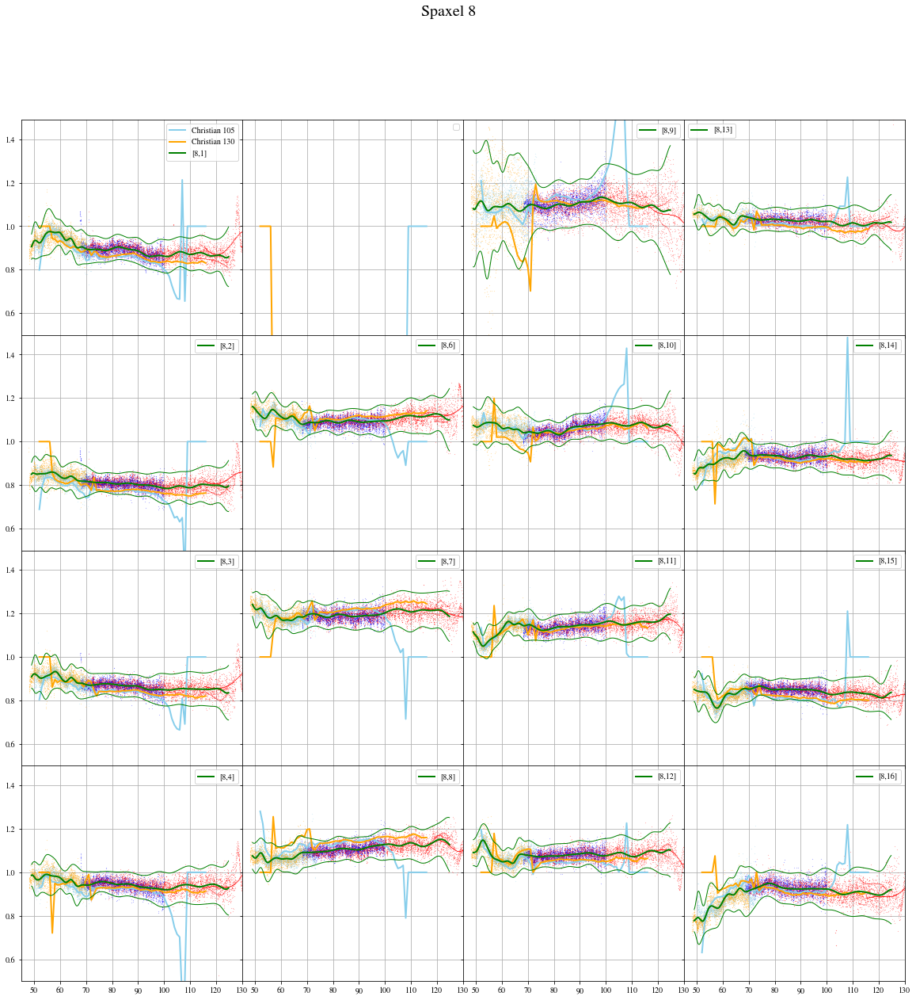

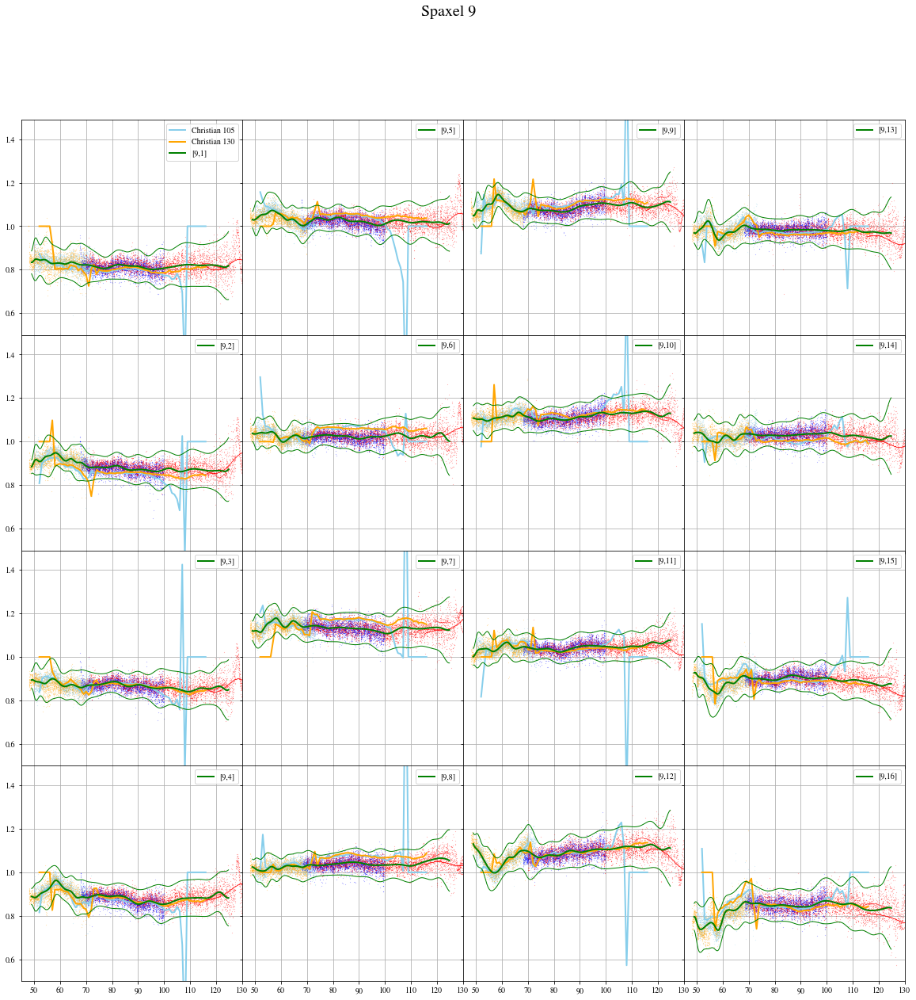

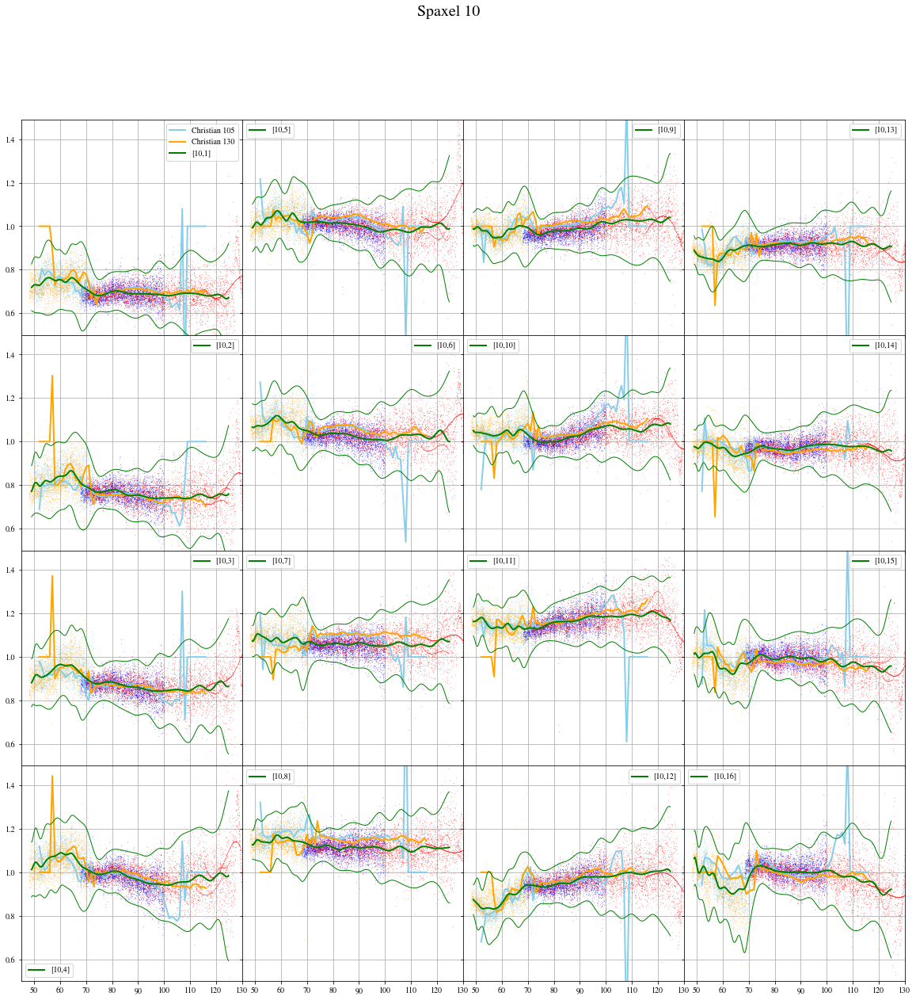

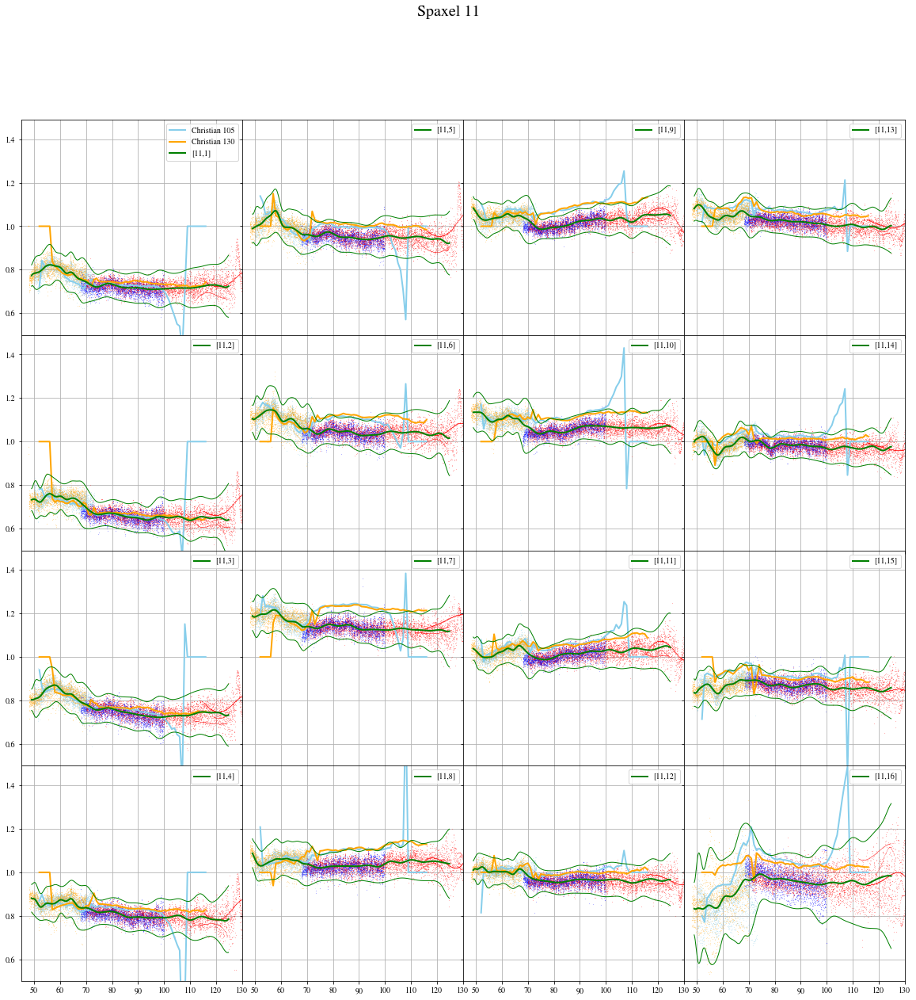

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


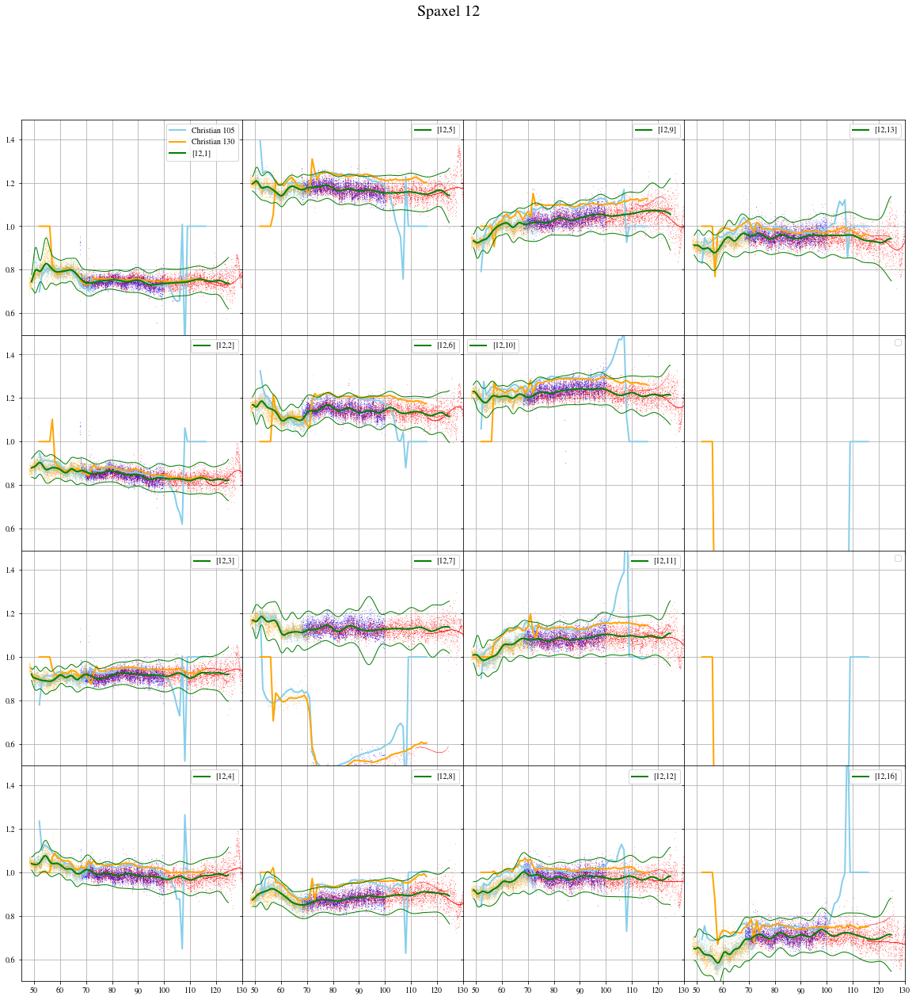

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


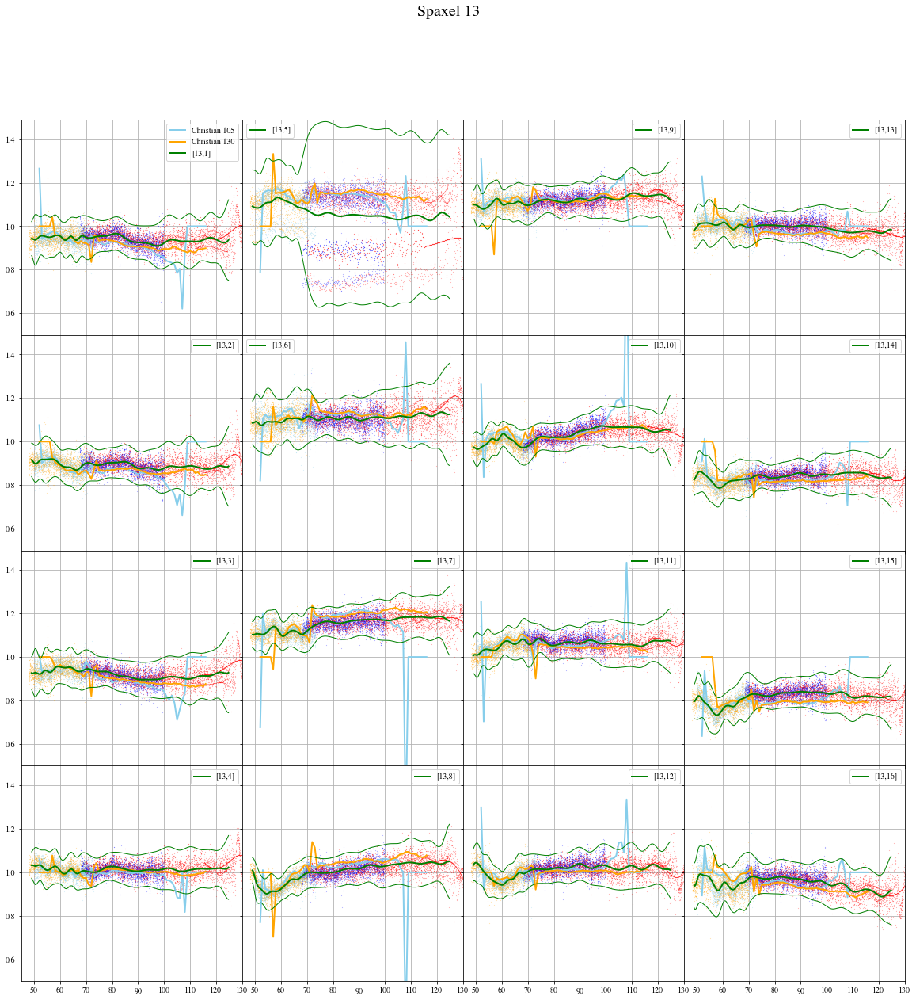

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


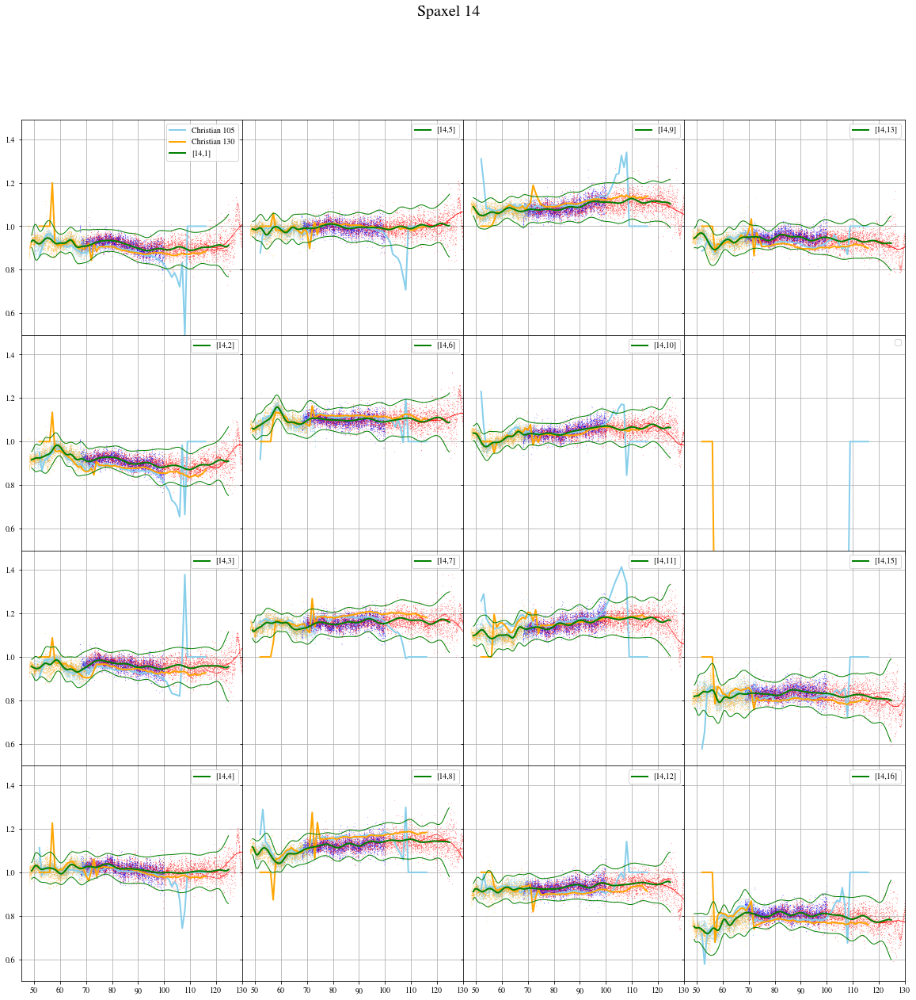

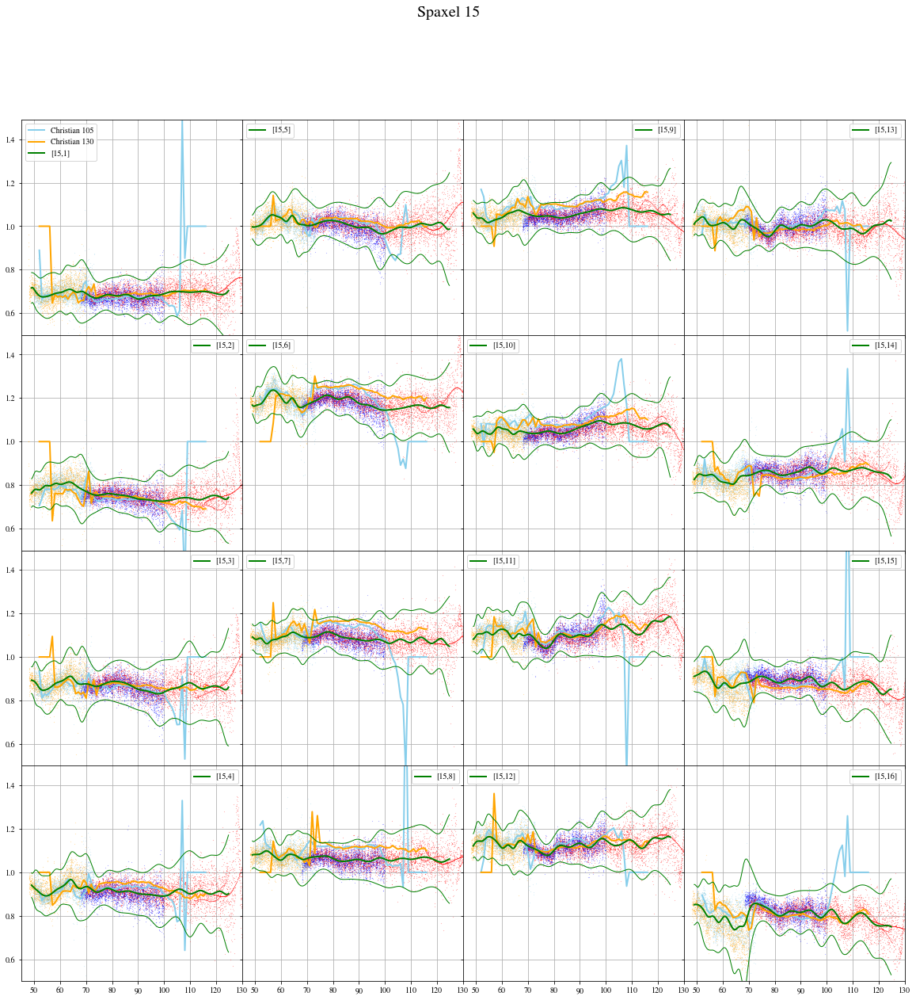

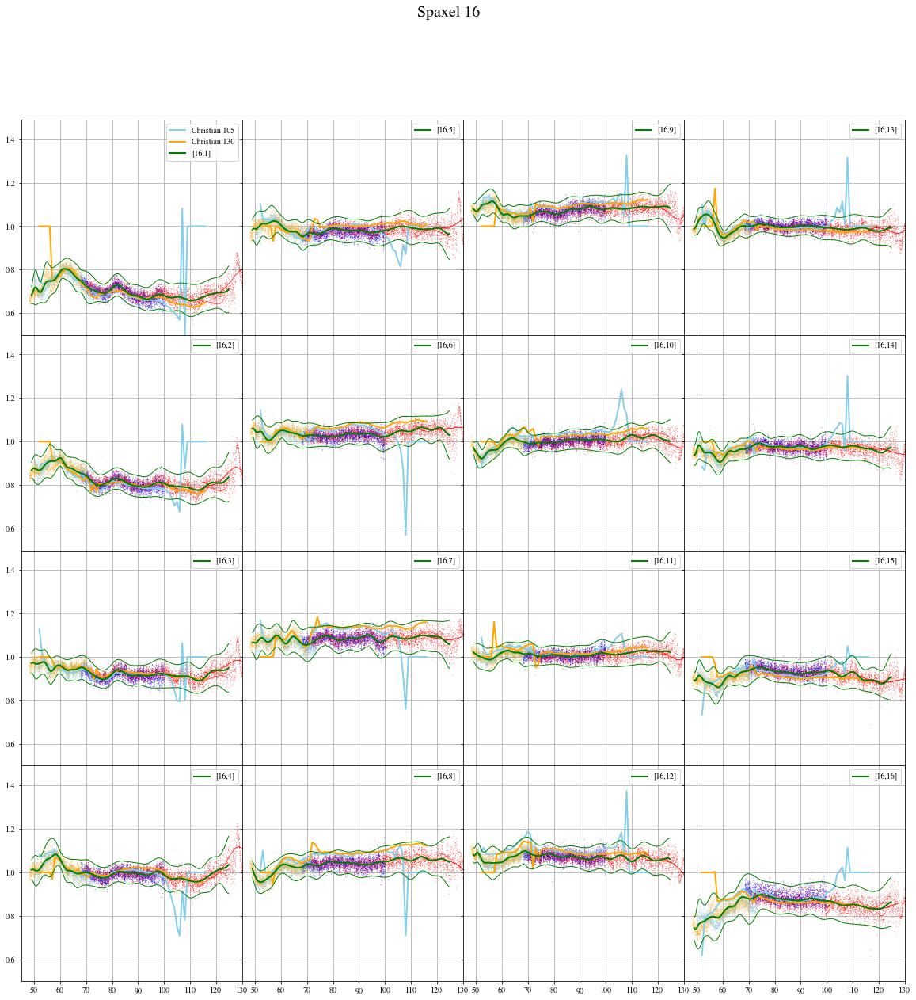

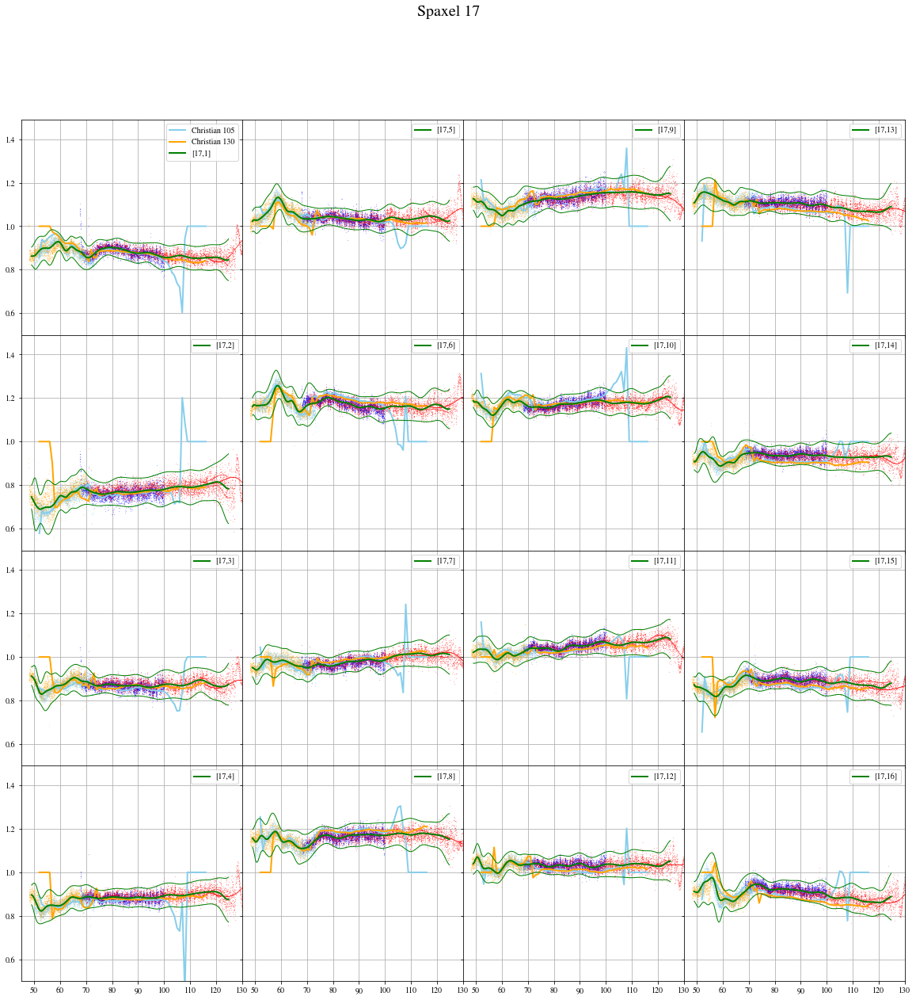

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


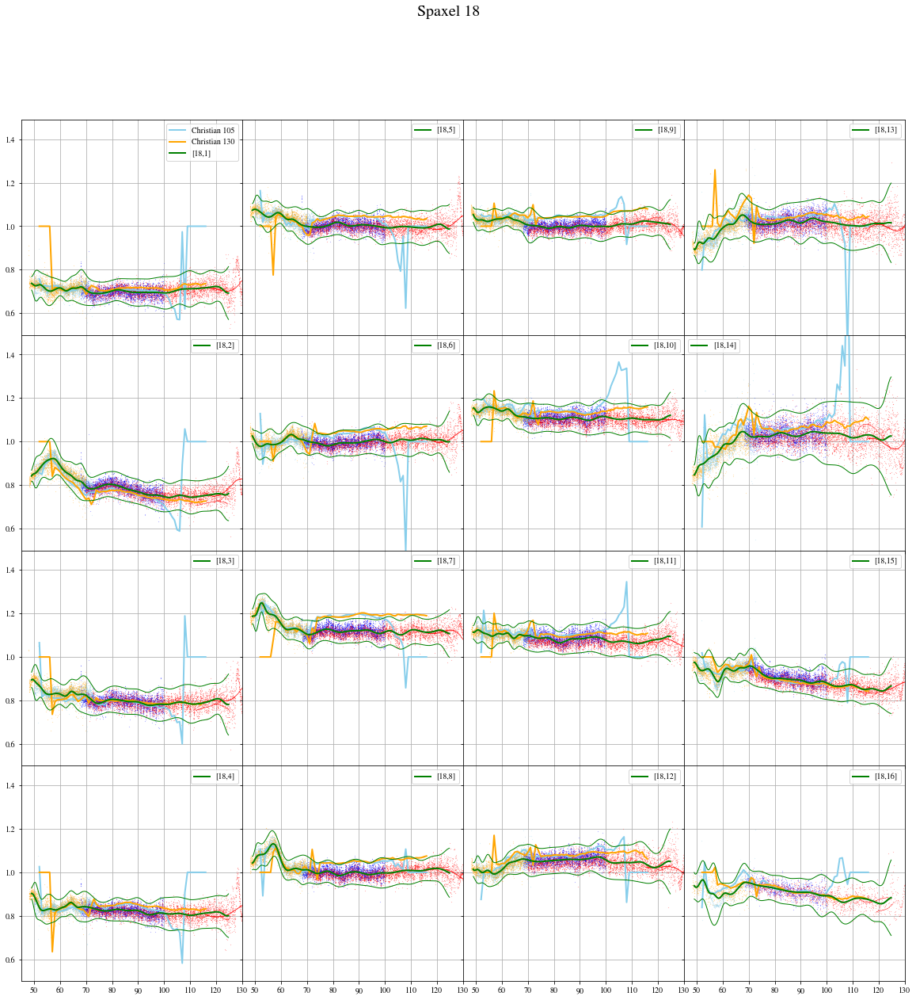

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


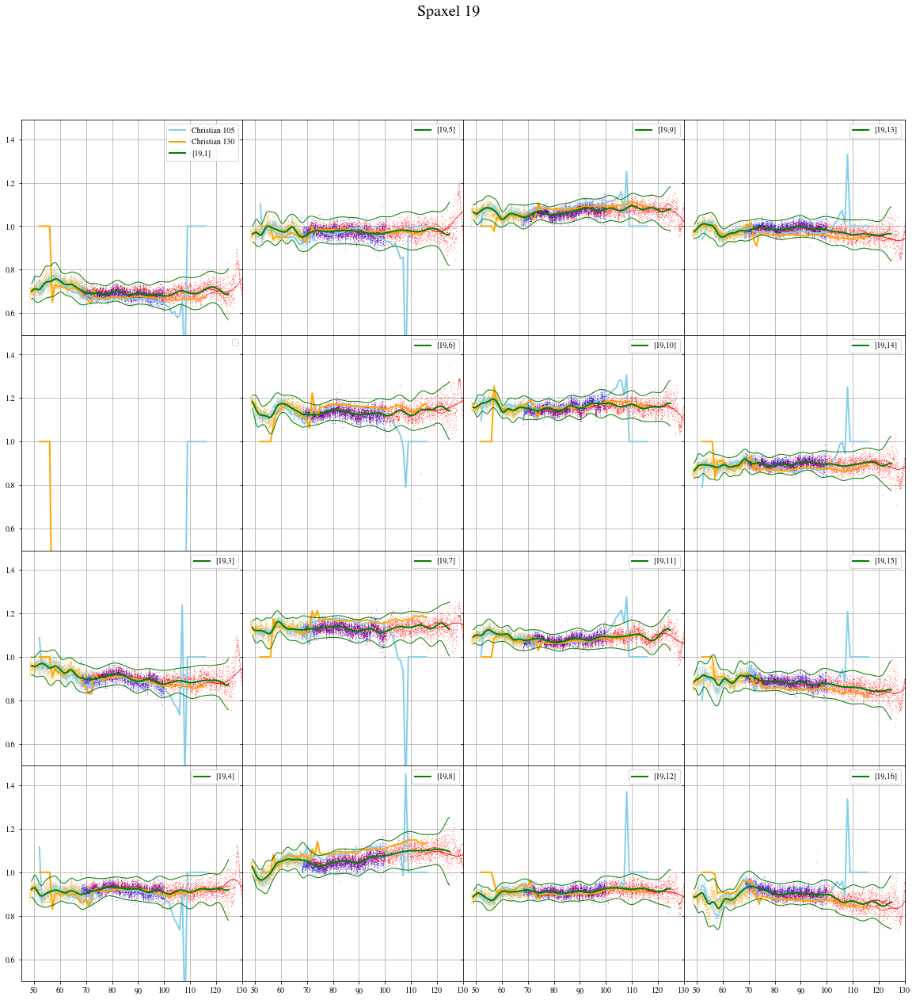

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


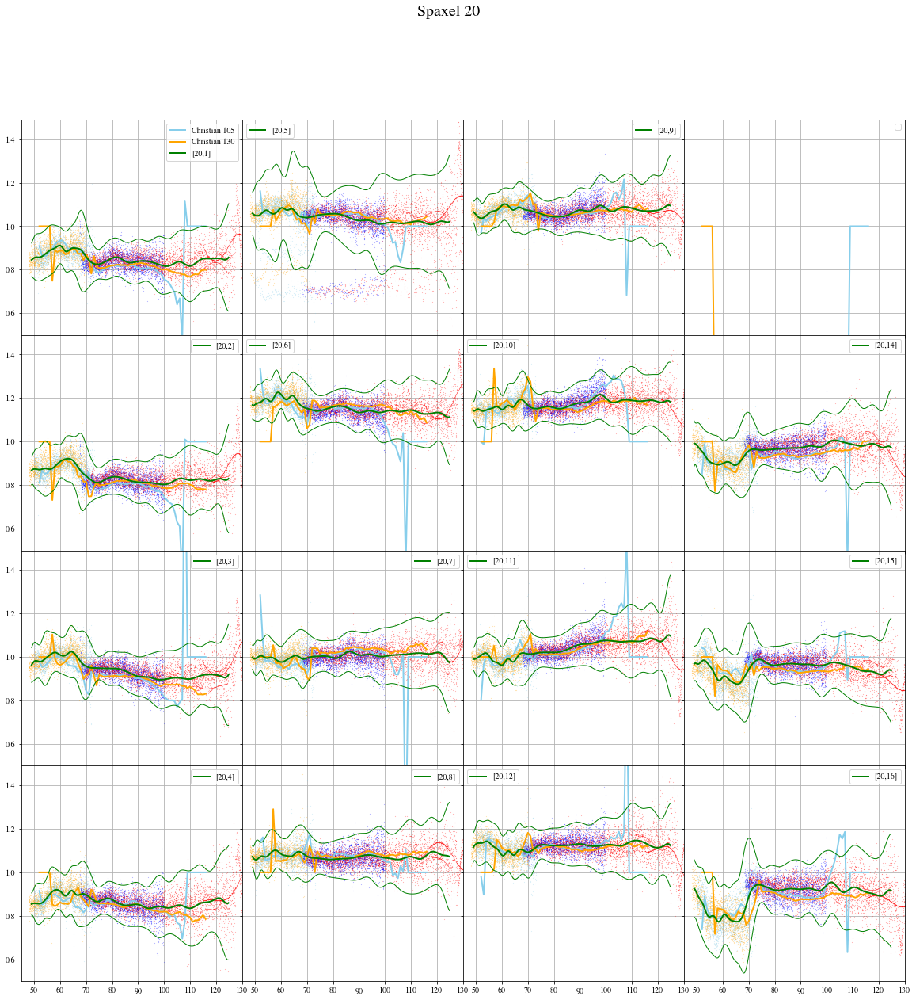

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


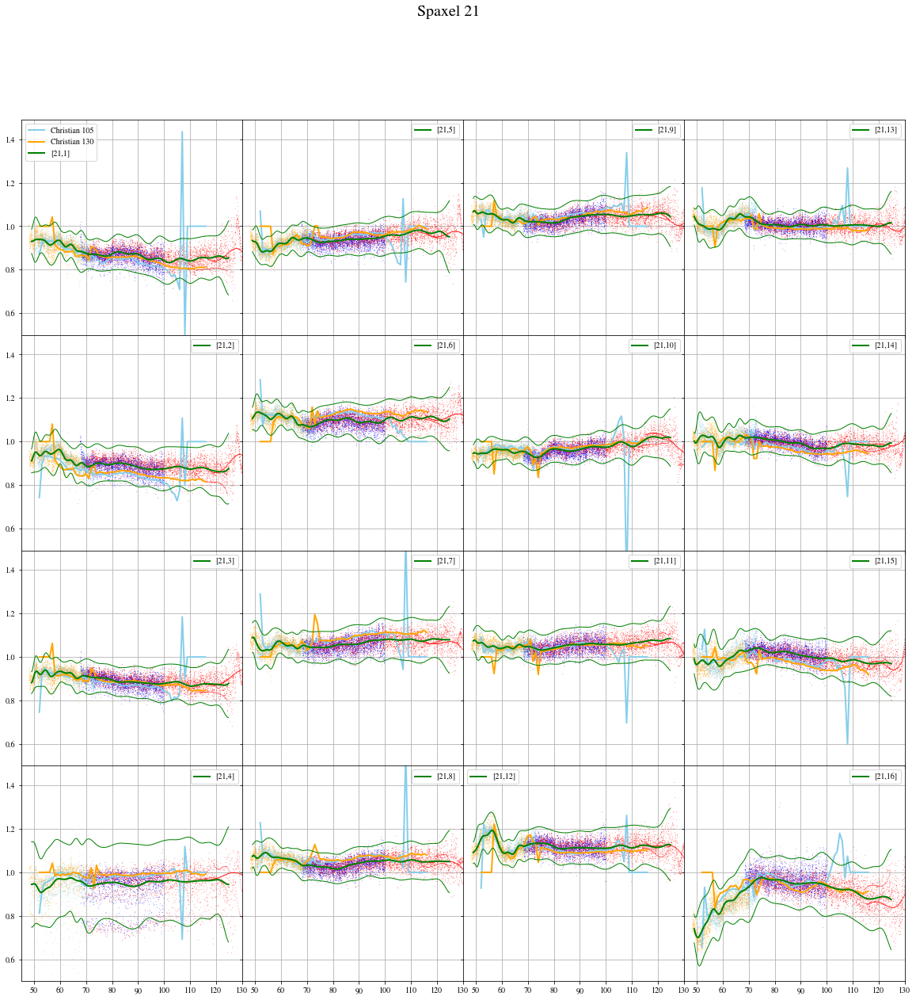

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


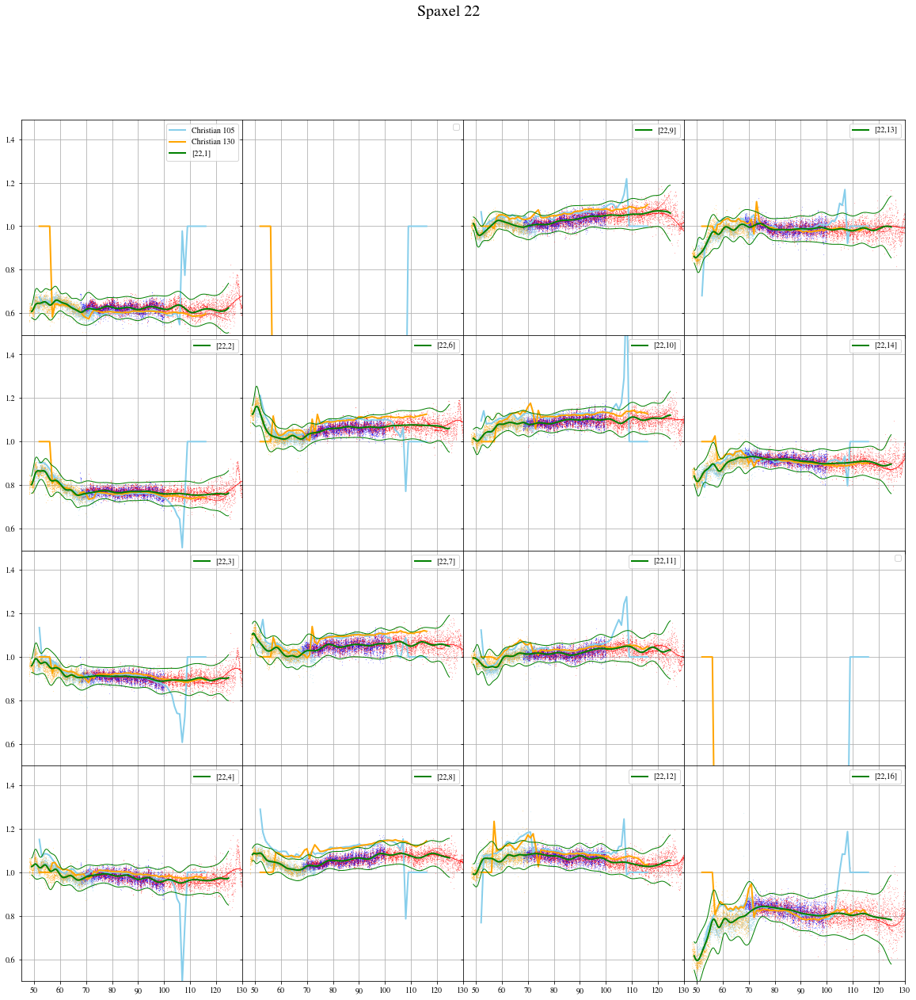

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)


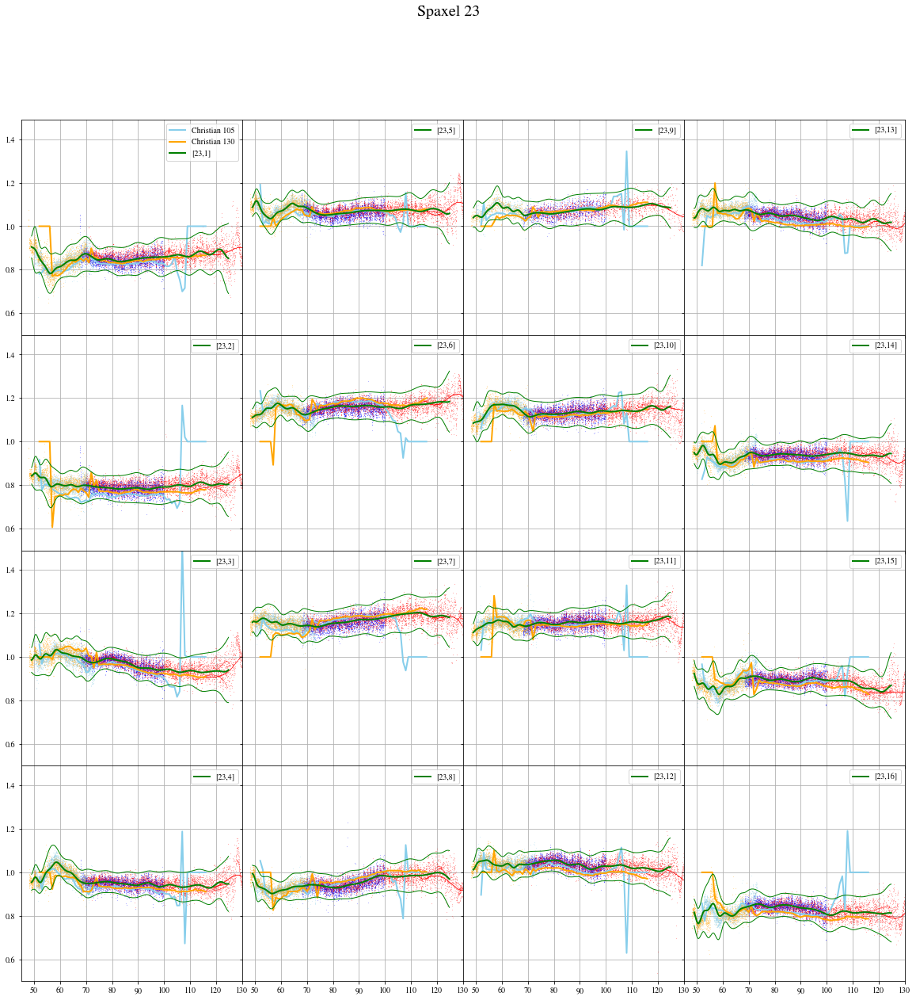

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
No handles with labels found to put in legend.


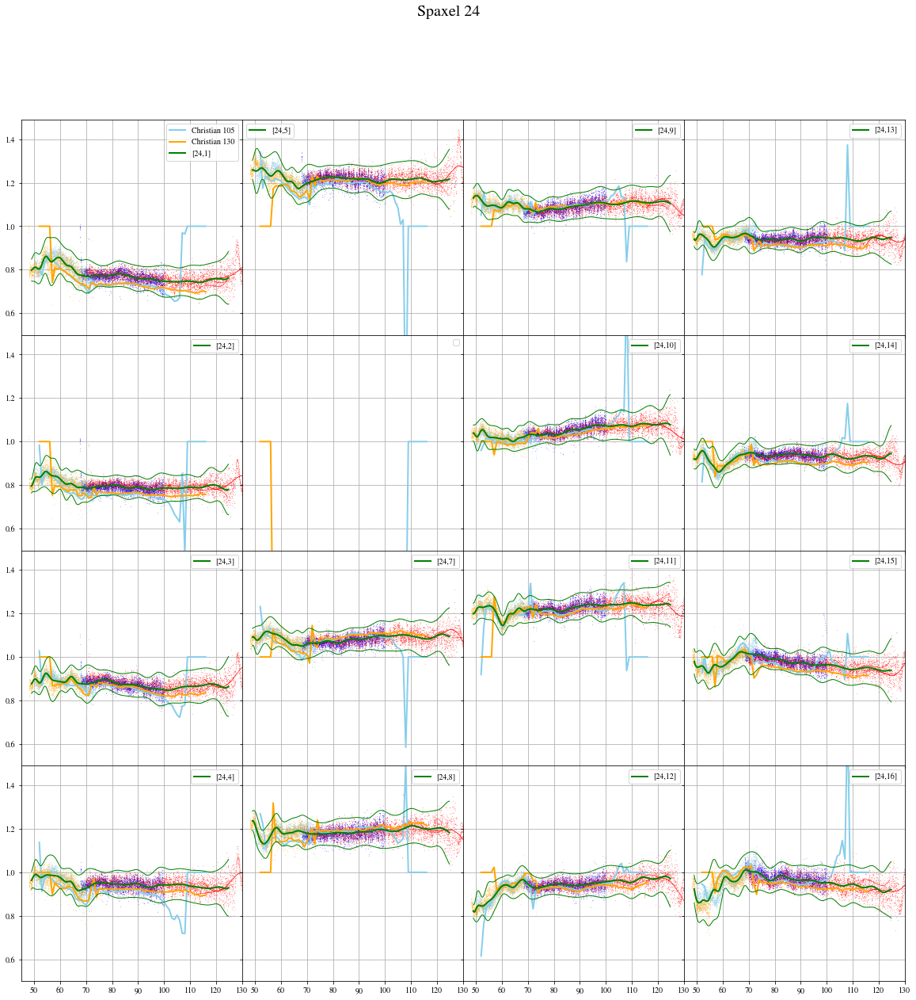

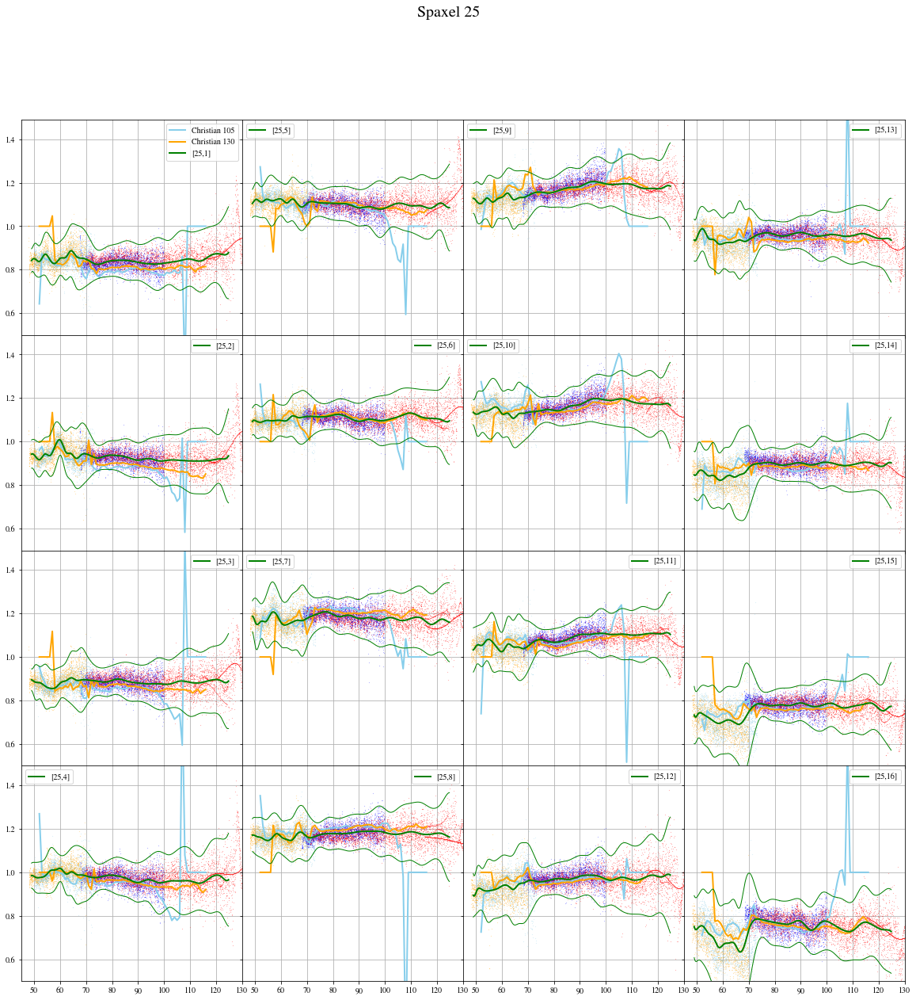

In [38]:
%matplotlib inline
from fifipy.spectra import computeFlatBlue
wdario = np.arange(49,125,0.2)
fdario = np.ones((np.size(wdario),25,16))
efdario = np.ones((np.size(wdario),25,16))
badpix = np.zeros((25,16))
noisepix = np.zeros((25,16))
for ispax in range(25):
    # Flats
    fig,axes = plt.subplots(4,4,figsize=(20,20), sharex=True, sharey=True)
    for ispex in range(16):
        #flats = computeFlatBlue(waves,corrSpectra,spatspectra,ispax,ispex,minflat=0.5,maxflat=1.3,delta=1.5)
        flats = computeFlatBlue(waves,corrSpectra,spatspectra,ispax,ispex,minflat=0.5,maxflat=1.3,delta=4)
        ax = axes[ispex % 4, ispex // 4] 
        for w,cs,ss,d,o in zip(waves, corrSpectra, spatspectra, dichroics, orders):
            if d == 105:
                if o == 1:
                    color='blue'
                else:
                    color='skyblue'
            else:
                if o == 1:
                    color='red'
                else:
                    color='orange'
            ax.plot(w,cs[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
        if ispex == 0:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
        else:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue', linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange', linewidth=2)
        if flats is not None:
            flat, eflat = flats
            f = flat(wdario)
            ef = eflat(wdario)
            ax.plot(wdario,f,color='green',label='['+str(ispax+1)+','+str(ispex+1)+']',linewidth=2.)
            ax.plot(wdario,f+3*ef, color='green', linewidth=1.)
            ax.plot(wdario,f-3*ef, color='green', linewidth=1.)
            fdario[:,ispax,ispex] = f
            efdario[:,ispax,ispex] = ef
        else:
            badpix[ispax,ispex] = 1
            #badpix.append((ispax+1, ispex+1))
        noisepix[ispax,ispex] = np.nanmean(f/ef)
        ax.set_xlim([45,130])
        ax.set_ylim([0.5,1.49])
        ax.legend()
        ax.grid()
    fig.suptitle('Spaxel '+str(ispax + 1), fontsize=20)
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

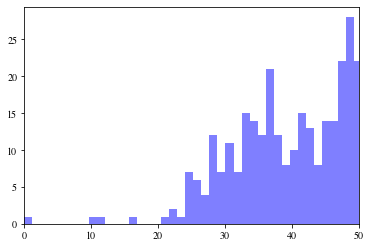

In [13]:
# This only for a series
# Histogram of signal/noise for flats
if BadPixels:
    snr = noisepix.ravel()
    #print(snr)
    idx = (snr < 0) | (snr > 100)
    snr[idx]=0
    n, bins, patches = plt.hist(snr,60, facecolor='blue', alpha=0.5)
    plt.xlim(0,50)
    plt.show()

In [14]:
if BadPixels:
    # Bad pixels
    print('Bad pixels')
    for ispax in range(25):
        for ispex in range(16):
            if badpix[ispax, ispex]:
                print('{:2d} {:2d}'.format(ispax+1,ispex+1))
                
    # Noisy pixels
    print('Noisy pixels')
    for ispax in range(25):
        for ispex in range(16):
            if noisepix[ispax, ispex] < 30:
                print('{:2d} {:2d}'.format(ispax+1,ispex+1))


Bad pixels
 1  6
 1  8
 1  9
 1 13
 1 14
 3  8
 3  9
 5  1
 5  5
 6  6
 6 11
 8  5
 8 13
11  7
12 14
12 15
13  5
14 14
18 16
19  2
20 13
21  4
22  5
22 15
23  9
23 13
24  6
Noisy pixels
 1  1
 1  2
 1  3
 1  4
 1  5
 1  6
 1  7
 1  8
 1  9
 1 10
 1 15
 1 16
 5  2
 5  3
 5  4
 5  5
 5  6
 5  8
 5 16
 6  3
 6  5
 6  6
 6  8
 6 10
 6 11
10  1
10  2
11  1
11  2
11  3
11  4
11 16
15  1
15  2
15  3
15  4
16  4
18 14
20  2
20  4
20  5
20  7
21 16
22 16


In [126]:
for j in [1,5,10,15,20,25]:
    for i in range(1,26,1):
        print('{:2d} {:2d}'.format(j,i))

 1  1
 1  2
 1  3
 1  4
 1  5
 1  6
 1  7
 1  8
 1  9
 1 10
 1 11
 1 12
 1 13
 1 14
 1 15
 1 16
 1 17
 1 18
 1 19
 1 20
 1 21
 1 22
 1 23
 1 24
 1 25
 5  1
 5  2
 5  3
 5  4
 5  5
 5  6
 5  7
 5  8
 5  9
 5 10
 5 11
 5 12
 5 13
 5 14
 5 15
 5 16
 5 17
 5 18
 5 19
 5 20
 5 21
 5 22
 5 23
 5 24
 5 25
10  1
10  2
10  3
10  4
10  5
10  6
10  7
10  8
10  9
10 10
10 11
10 12
10 13
10 14
10 15
10 16
10 17
10 18
10 19
10 20
10 21
10 22
10 23
10 24
10 25
15  1
15  2
15  3
15  4
15  5
15  6
15  7
15  8
15  9
15 10
15 11
15 12
15 13
15 14
15 15
15 16
15 17
15 18
15 19
15 20
15 21
15 22
15 23
15 24
15 25
20  1
20  2
20  3
20  4
20  5
20  6
20  7
20  8
20  9
20 10
20 11
20 12
20 13
20 14
20 15
20 16
20 17
20 18
20 19
20 20
20 21
20 22
20 23
20 24
20 25
25  1
25  2
25  3
25  4
25  5
25  6
25  7
25  8
25  9
25 10
25 11
25 12
25 13
25 14
25 15
25 16
25 17
25 18
25 19
25 20
25 21
25 22
25 23
25 24
25 25


 1  9
 3  8
 3  9
 5  1
 5  5
 6  7
 8  5
 8 13
12 14
12 15
13  5
14 14
15 12
18 16
19  2
20 13
21  4
22  5
22 15
23  9
24  6
0.0544295874200935


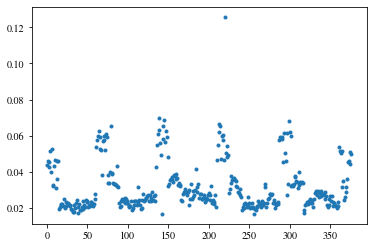

In [72]:
if BadPixels:
    totnoise = []
    for ispax in range(25):
        for ispex in range(16):
            noise = np.nanmean(efdario[:,ispax,ispex])
            if noise == 1:
                #print(ispax+1, ispex+1, 'bad')
                print("{0:2d} {1:2d}".format(ispax+1, ispex+1))
            elif noise > 0.095:
                #print(ispax+1, ispex+1, noise)
                print("{0:2d} {1:2d}".format(ispax+1, ispex+1))
                totnoise.append(noise)
            elif noise > 0.01:
                totnoise.append(noise)
                #print('noise ', noise)
    plt.plot(totnoise,'.')
    print(np.median(totnoise)+2*np.std(totnoise))


In [39]:
# Combine spectral flats (per spexal) with spectral flat (per spexel)
# to obtain total spexel spectral flats and respective wavelength arrays

# B1 - D105
idx = np.isfinite(spaxelSpectralFlat1A[20])
w1min = np.nanmin(w1[idx])
w1max = np.nanmax(w1[idx])
print('min max w1 ', w1min, w1max)
idx, = np.where( (wdario >= w1min) & (wdario <= w1max))
w105b1 = wdario[idx]
spexelSpectralFlatB1D105 = fdario[idx,:,:].copy()
efB1D105 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB1D105))
for ispax, sft in enumerate(spaxelSpectralFlat1A):
    sft_ = np.interp(w105b1, w1, sft)
    for ispex in range(16):
        #pass
        spexelSpectralFlatB1D105[:,ispax,ispex] *= sft_
# B1 - D130
idx = np.isfinite(spaxelSpectralFlat1B[20])
w1min = np.nanmin(w1[idx])
w1max = np.nanmax(w1[idx])
print('min max w1 ', w1min, w1max)
idx, = np.where( (wdario >= w1min) & (wdario <= w1max))
w130b1 = wdario[idx]
spexelSpectralFlatB1D130 = fdario[idx,:,:].copy()
efB1D130 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB1D130))
for ispax, sft in enumerate(spaxelSpectralFlat1B):
    sft_ = np.interp(w130b1, w1, sft)
    for ispex in range(16):
        #pass
        spexelSpectralFlatB1D130[:,ispax,ispex] *= sft_   
# B2 - D105
idx = np.isfinite(spaxelSpectralFlat2A[20])
w2min = np.nanmin(w2[idx])
w2max = np.nanmax(w2[idx])
print('min max w2 ', w2min, w2max)
idx, = np.where( (wdario >= w2min) & (wdario <= w2max))
w105b2 = wdario[idx]
spexelSpectralFlatB2D105 = fdario[idx,:,:].copy()
efB2D105 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB2D105))
for ispax, sft in enumerate(spaxelSpectralFlat2A):
    sft_ = np.interp(w105b2, w2, sft)
    for ispex in range(16):
        #pass
        spexelSpectralFlatB2D105[:,ispax,ispex] *= sft_

# B2 - D130
idx = np.isfinite(spaxelSpectralFlat2B[20])
w2min = np.nanmin(w2[idx])
w2max = np.nanmax(w2[idx])
print('min max w2 ', w2min, w2max)
idx, = np.where( (wdario >= w2min) & (wdario <= w2max))
w130b2 = wdario[idx]
spexelSpectralFlatB2D130 = fdario[idx,:,:].copy()
efB2D130 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB2D130))
for ispax, sft in enumerate(spaxelSpectralFlat2B):
    sft_ = np.interp(w130b2, w2, sft)
    for ispex in range(16):
        #pass
        spexelSpectralFlatB2D130[:,ispax,ispex] *= sft_


min max w1  67.76194102174387 109.21717251287177
(208, 25, 16)
min max w1  67.4827812137228 130.71247773049365
(287, 25, 16)
min max w2  47.93434735126109 73.35241570713816
(122, 25, 16)
min max w2  47.93434735126109 73.85976238090817
(125, 25, 16)


In [40]:
# Save the spectral flats
import os
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'

from fifipy.io import saveSpecFlats
saveSpecFlats(w105b1, spexelSpectralFlatB1D105, efB1D105,'BLUE', 1, 105, caldir+'spectralFlatsB1D105.fits')
saveSpecFlats(w130b1, spexelSpectralFlatB1D130, efB1D130,'BLUE', 1, 130, caldir+'spectralFlatsB1D130.fits')
saveSpecFlats(w105b2, spexelSpectralFlatB2D105, efB2D105,'BLUE', 2, 105, caldir+'spectralFlatsB2D105.fits')
saveSpecFlats(w130b2, spexelSpectralFlatB2D130, efB2D130,'BLUE', 2, 130, caldir+'spectralFlatsB2D130.fits')

In [41]:
# Save spatial flats for the different missions
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'
longdates = []
for ud in udates:
    ud_ = str.split(ud,'/')
    longdates.append('20'+ud_[1]+'{:0>2}'.format(ud_[0])+'01')
longdates = np.array(longdates)
idx = np.argsort(longdates)
sld = longdates[idx]
sss = [ssi[i] for i in idx]

sld = list(sld)
sld.append('99999999')

caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'
# Save spatial flats in a txt file
title = np.array(['date','p0','p1','p2','p3','p4','p5','p6','p7','p8','p9','p10','p11','p12','p13','p14','p15','p16',
         'p17','p18','p19','p20','p21','p22','p23','p24'])
separator='\t'
with open(caldir+'spatialFlatB.txt','wb') as f:
    np.savetxt(f, [separator.join(title)],fmt='%s')
    for ud,si in zip(sld[1:], sss):
        #np.savetxt(f,['\n'],fmt='%s')
        sf = [str(ud)]
        sf.extend(["{:10.8f}".format(fi) for fi in si])
        np.savetxt(f, [separator.join(sf)],fmt='%s')

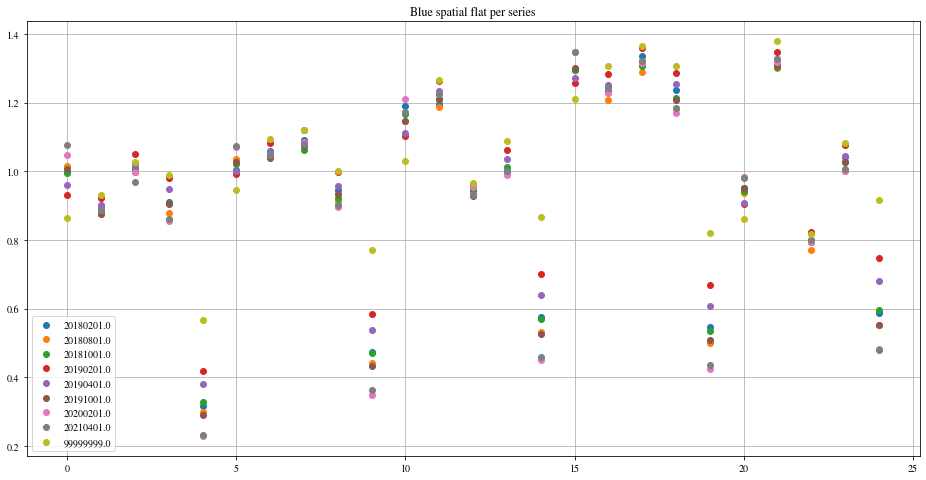

In [42]:
# Check on saved flats
#from astropy.io import fits
#hdl = fits.open('/Users/dfadda/sofia/FIFI-LS/SpectralFlats/spatialFlatB.fits')
##hdl.info()
#dates = hdl['DATES'].data
#flats = hdl['SPATFLAT'].data
#hdl.close()
data = np.loadtxt('/Users/dfadda/sofia/FIFI-LS/SpectralFlats/spatialFlatB.txt', skiprows=1)
dates = data[:,0]
flats = data[:,1:]
#print(dates)
fig,ax = plt.subplots(figsize=(16,8))
for f, date in zip(flats, dates):
    ax.plot(f,'o',label=str(date))
ax.grid()
ax.legend()
ax.set_title('Blue spatial flat per series')
plt.show()

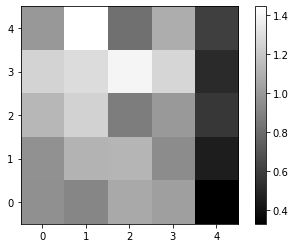

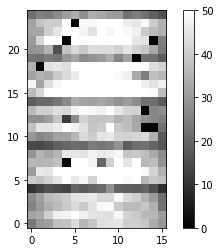

In [102]:
# Spatial illumination
if Test:
    spaflat2d = np.reshape(ssi[5],(5,5))
    plt.imshow(spaflat2d, cmap='gray', origin='lower')
    plt.colorbar()
    plt.show()

    # Error per spexel (note that vignetted spaxels have larger errors)
    ef = np.nanmedian(fdario/efdario, axis=0)
    plt.imshow(ef, cmap='gray', origin='lower')
    plt.colorbar()
    plt.clim(0,50)
    plt.show()

# Blue Order 1

# Blue Order 2

# Blue    Order 2 - Filter 1

In May 2019, a new combination has been used to observe Titan. The order 2 has been coupled with the filter of order 1. The information is not recorded in the header (which reports the order 1) and is not processed by the pipeline. A series of calibration observations in the lab has been done after the series to estimate flats for this observation.
In flight, Callisto was observed to provide a flux calibration.


In [89]:
BadPixels = False

In [64]:
%matplotlib inline
import matplotlib.pyplot as plt
from fifipy.io import readSlopeFits
from fifipy.spectra import computeMedianSpatialSpectra, computeSplineFits
import numpy as np

caldirs = [
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2019/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2019/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2020/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2020/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2021/'
          ]
signs = [ -1, -1, 1, 1, 1]
cfiles = [
          ['D105M2F1'],
        ['D105M2F1_1','D105M2F1_2','D105M2F1_3','D105M2F1_4','D105M2F1_5','D105M2F1_6'],
        ['D105M2F1_1'],
        ['D105M2F1_1'],
        ['D105M2F1_1']
         ]
orders = [[2],
         [2,2,2,2,2,2],
          [2],
          [2],
          [2]
         ]
dichroics = [[105],
             [105,105,105,105,105,105],
            [105],
             [105],
             [105]
            ]
dates = [
         ['4/19']*1,
        ['10/19']*6,
        ['2/20']*1,
        ['8/20']*1,
        ['4/21']*1
        ]

# To inspect badpixels
if BadPixels:
    cfiles = cfiles[:2]
    caldirs = caldirs[:2]
    signs = signs[:2]
    dates = dates[:2]
    orders = orders[:2]
    dichroics = dichroics[:2]

wmin = 80
wmax = 80
wmin2 = 60
wmax2 = 60
wmin1 = 80
wmax1 = 80
for files, caldir, order_ in zip(cfiles, caldirs, orders):
    for file, order in zip(files, order_):
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        wmin_ = np.nanmin(w); wmax_ = np.nanmax(w)
        if wmin_ < wmin: wmin = wmin_
        if wmax_ > wmax: wmax = wmax_
        if order == 1:
            if wmin_ < wmin1: wmin1 = wmin_
            if wmax_ > wmax1: wmax1 = wmax_
        else:
            if wmin_ < wmin2: wmin2 = wmin_
            if wmax_ > wmax2: wmax2 = wmax_      

print('w min ', wmin, ' w max ', wmax)
print('w min 1 ', wmin1, ' w max 1', wmax1)
print('w min 2 ', wmin2, ' w max 2', wmax2)
waves1 = []
spectra1 = []
waves2 = []
spectra2 = []
waves = []
spectra = []
# Compute wavelength grid
wave, spectrum = computeSplineFits(w,dw,s,'B2', wmin, wmax, delta=0.3)
for files, caldir, sign, order, dichroic in zip(cfiles, caldirs, signs, orders, dichroics):
    print('files ', files)
    for file, o, d in zip(files, order, dichroic):
        print(file, o, d)
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        if o == 1:
            mode = 'B1'
            wmin_ = wmin1
            wmax_ = wmax1
        else:
            mode = 'B2'
            wmin_ = wmin2
            wmax_ = wmax2
        wave_, spectrum_ = computeSplineFits(w, dw, s, mode, wmin_, wmax_, delta=0.3)
        # Interpolate on grid
        spectrum = np.full([400,len(wave)], np.nan)
        idx, = np.where((wave > np.nanmin(wave_)) & (wave < np.nanmax(wave_)))
        for i in range(400):
            spectrum[i,idx] = np.interp(wave[idx], wave_, spectrum_[i,:])
                
        #print('length of wave ',len(wave))
        # Filter low signal parts
        if o == 1:
            if d == 105:
                idx = (wave < 65) | (wave > 100)
                spectrum[:,idx] = np.nan
            else:
                idx = (wave < 70)
                spectrum[:,idx] = np.nan                
        else:
            if d == 105:
                idx = (wave < 50) | (wave > 75)
                spectrum[:,idx] = np.nan
            else:
                #idx = ((wave > 53) & (wave < 58)) | (wave > 70)
                idx = wave > 70
                spectrum[:,idx] = np.nan
        waves.append(wave)
        spectra.append(spectrum * sign)
        if o == 1:
            waves1.append(wave_)
            spectra1.append(spectrum_ * sign)
        else:
            waves2.append(wave_)
            spectra2.append(spectrum_ * sign)
            
spectra = np.array(spectra)
spectra1 = np.array(spectra1)
spectra2 = np.array(spectra2)

spatspectra = []
for spectrum in spectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

spatspectra1 = []
for spectrum in spectra1:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra1.append(spatspectrum)
spatspectra1 = np.array(spatspectra1)
spatspectra2 = []
for spectrum in spectra2:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra2.append(spatspectrum)
spatspectra2 = np.array(spatspectra2)


# Concatenate
orders = np.concatenate(orders)
dichroics = np.concatenate(dichroics)
dates = np.concatenate(dates)

idx = orders == 1
dichroics1 = dichroics[idx]
dichroics2 = dichroics[~idx]
dates1 = dates[idx]
dates2 = dates[~idx]

w min  65.87880677320491  w max  80
w min 1  80  w max 1 80
w min 2  60  w max 2 74.44993353160852
files  ['D105M2F1']
D105M2F1 2 105
files  ['D105M2F1_1', 'D105M2F1_2', 'D105M2F1_3', 'D105M2F1_4', 'D105M2F1_5', 'D105M2F1_6']
D105M2F1_1 2 105
D105M2F1_2 2 105
D105M2F1_3 2 105
D105M2F1_4 2 105
D105M2F1_5 2 105
D105M2F1_6 2 105
files  ['D105M2F1_1']
D105M2F1_1 2 105
files  ['D105M2F1_1']
D105M2F1_1 2 105
files  ['D105M2F1_1']
D105M2F1_1 2 105


/Users/dfadda/Python/fifipy/fifipy/spectra.py:87: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:80: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))


dates  ['4/19' '10/19' '10/19' '10/19' '10/19' '10/19' '10/19' '2/20' '8/20'
 '4/21']
dates2  ['4/19' '10/19' '10/19' '10/19' '10/19' '10/19' '10/19' '2/20' '8/20'
 '4/21']
unique dates ['10/19' '2/20' '4/19' '4/21' '8/20']
(10, 336) (10, 25, 336) 10 10
date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 0


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

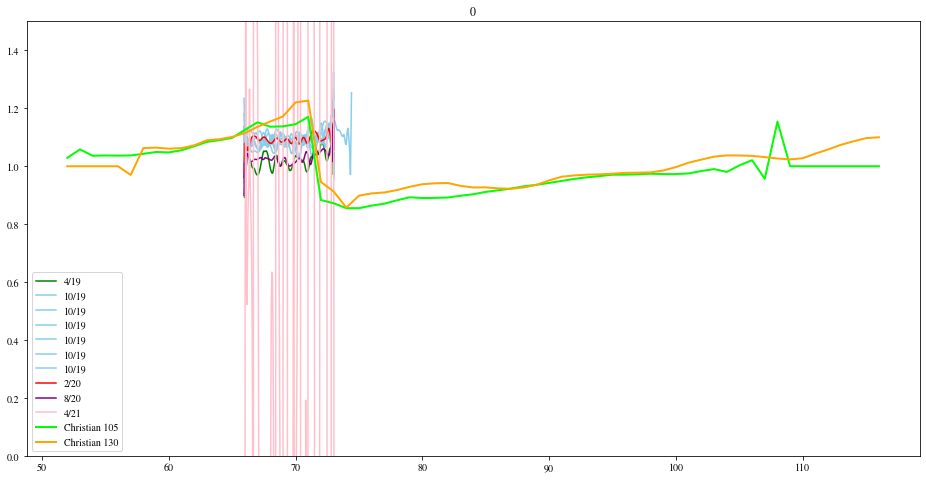

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 1


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

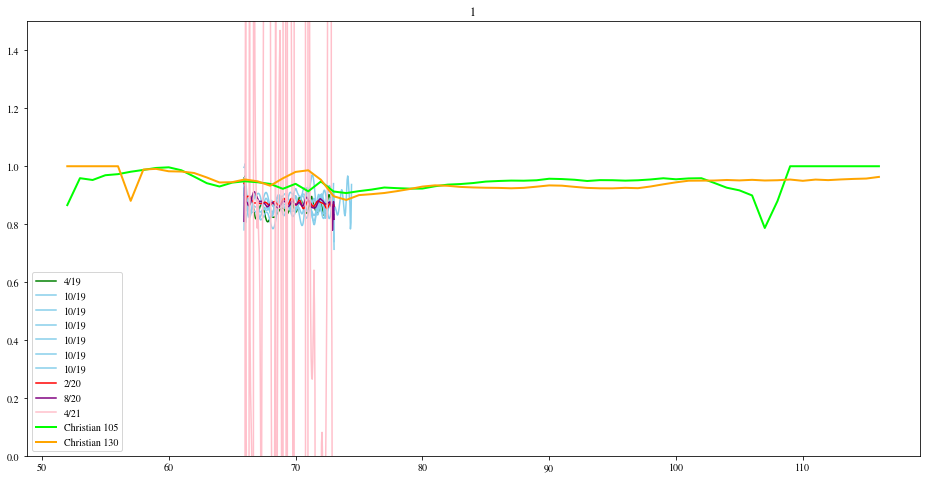

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 2


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

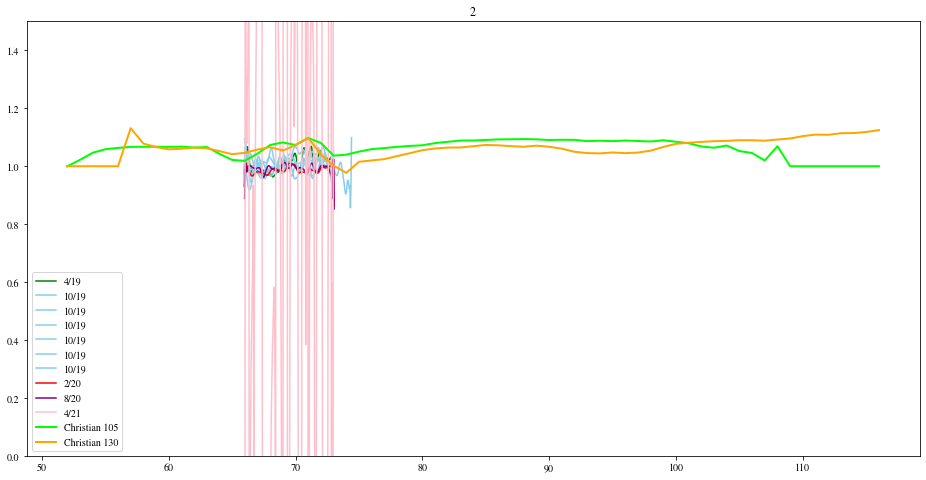

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 3


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

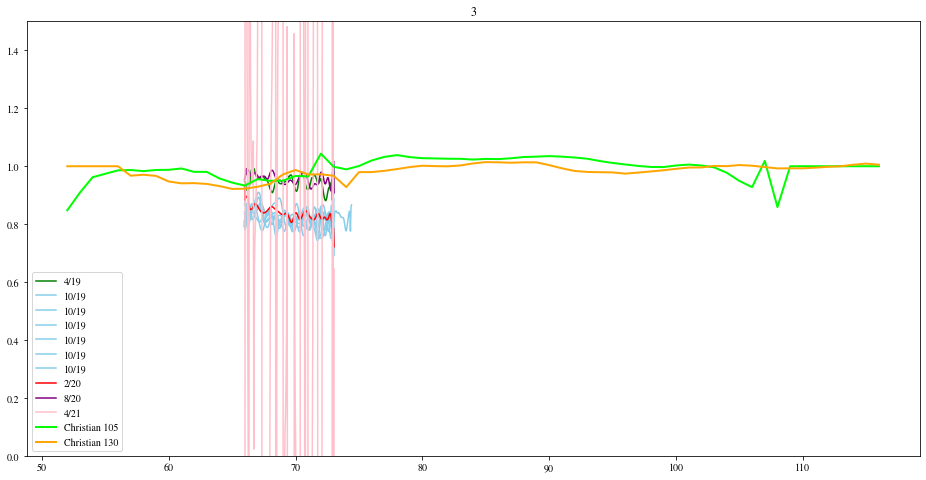

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 4


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

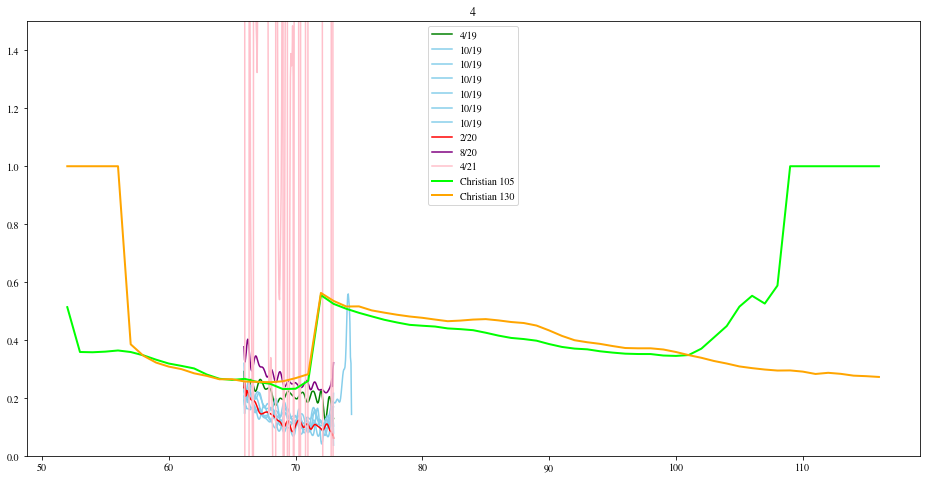

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 5


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

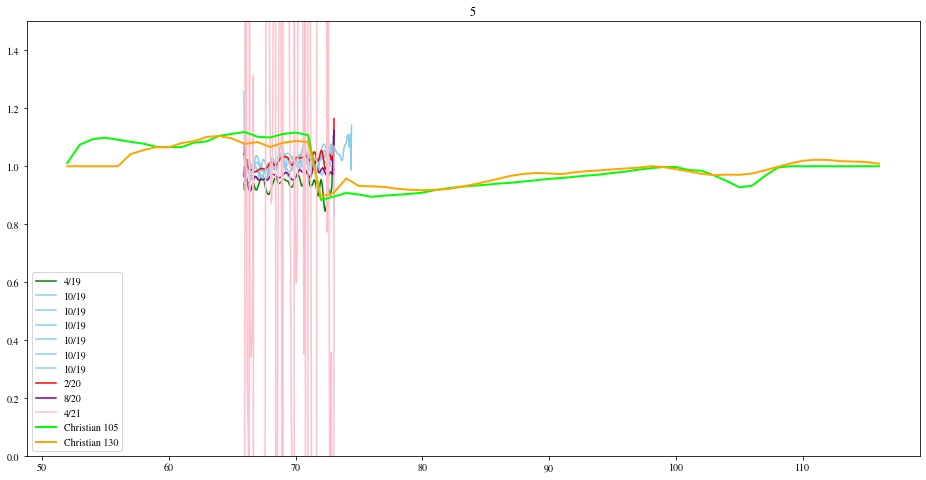

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 6


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

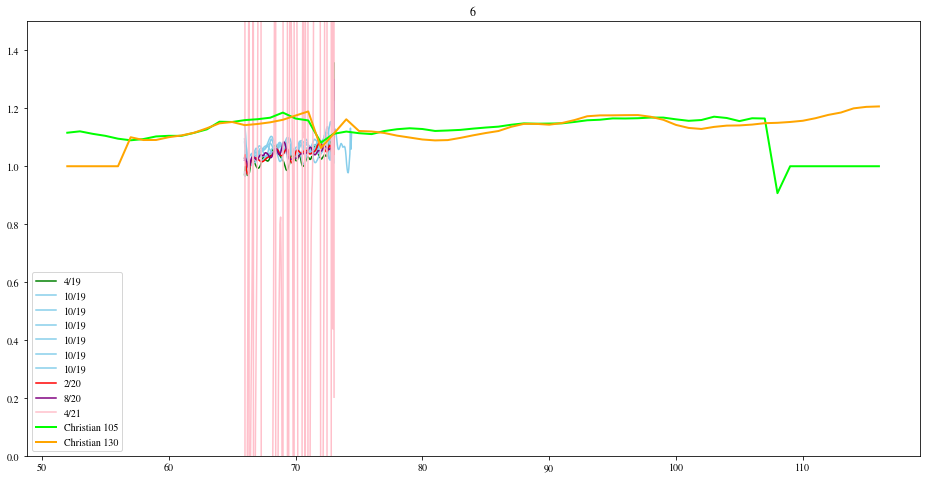

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 7


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

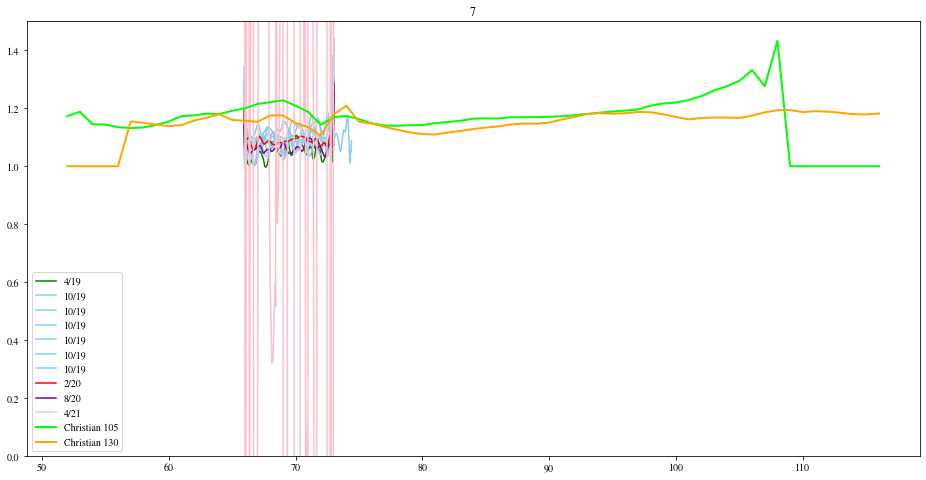

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 8


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

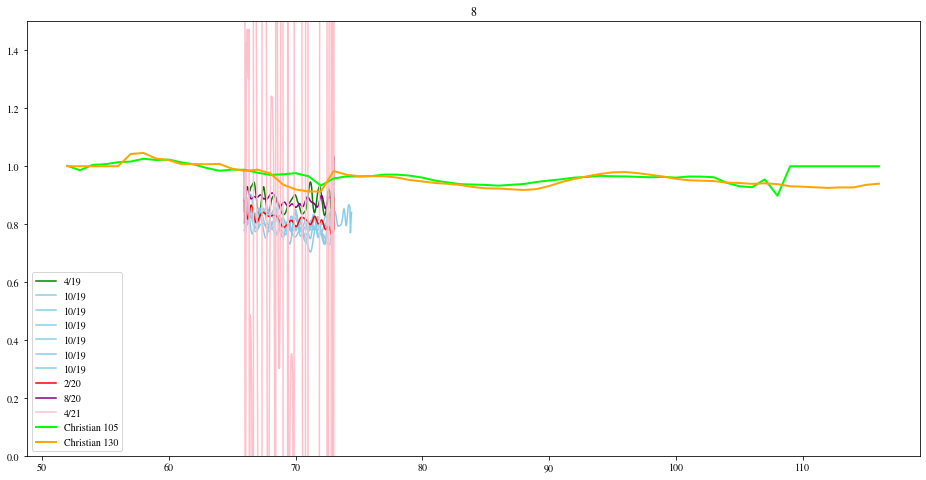

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 9


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

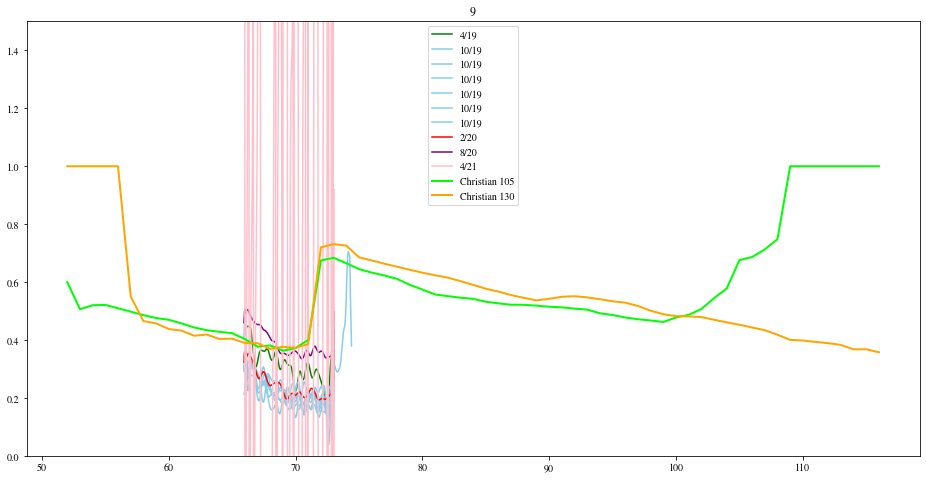

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 10


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

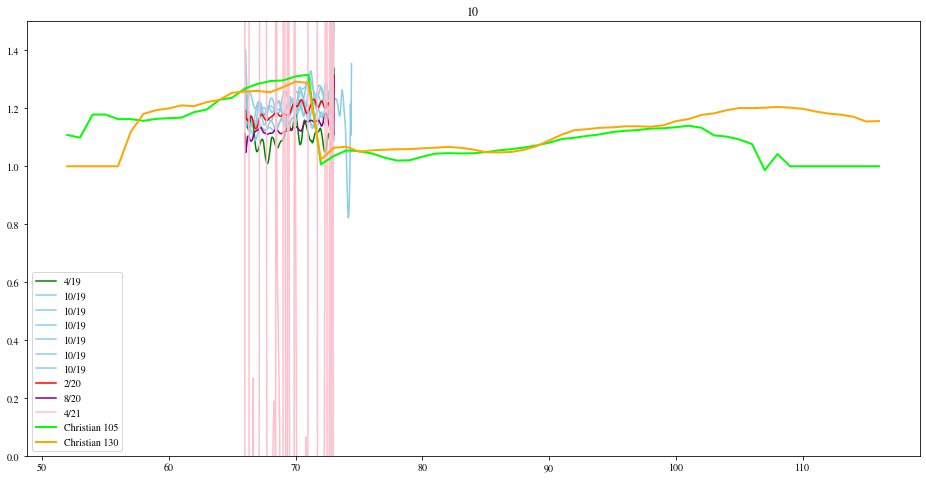

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 11


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

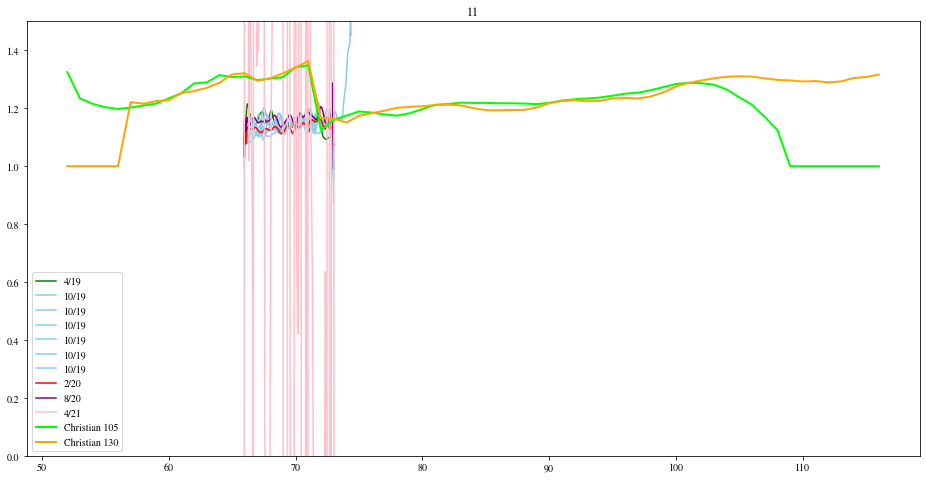

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 12


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

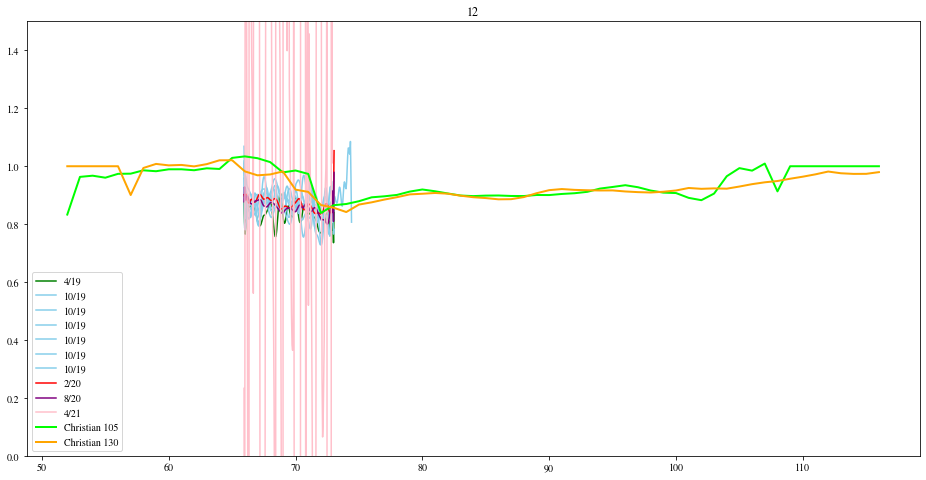

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 13


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

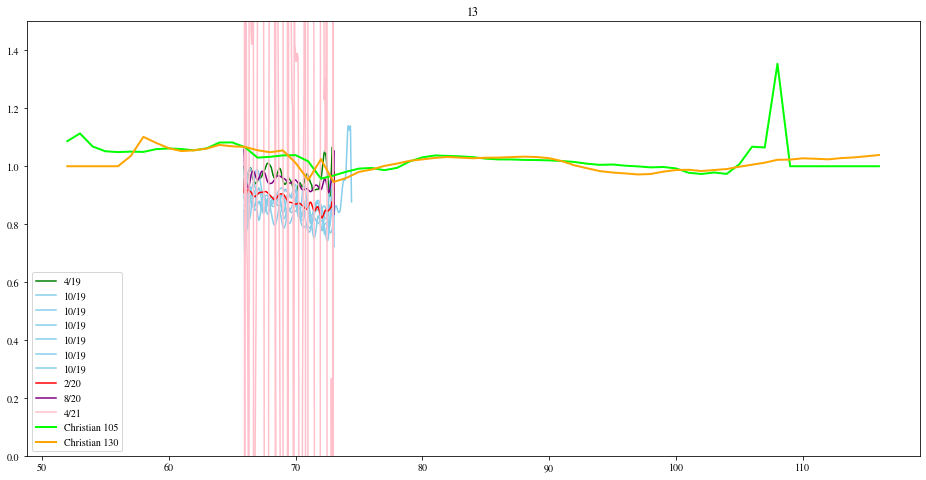

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 14


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

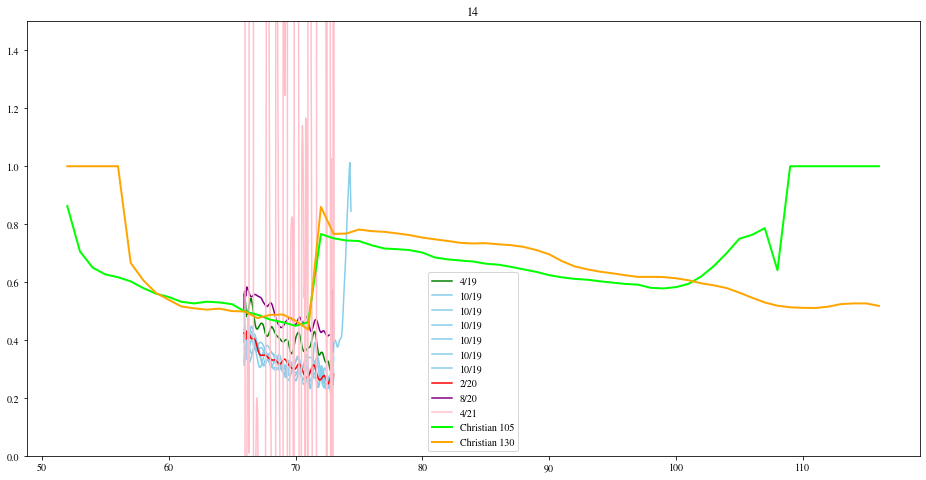

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 15


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

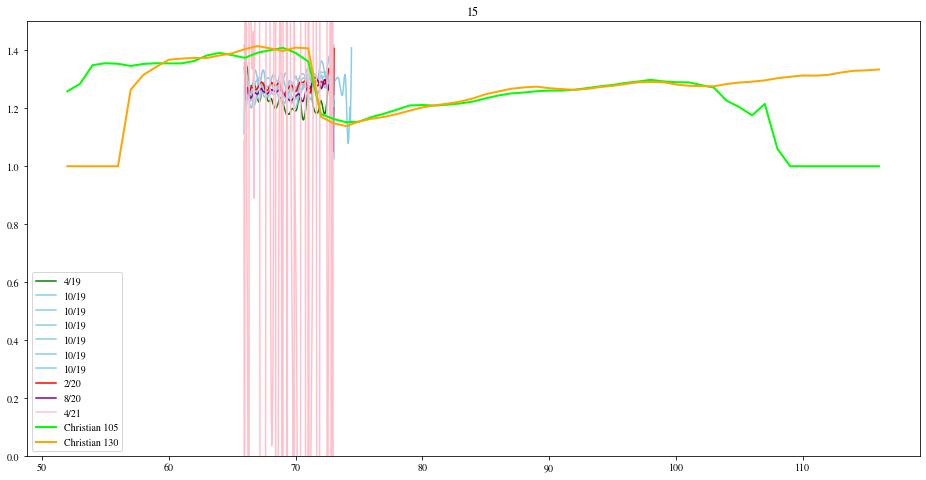

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 16


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

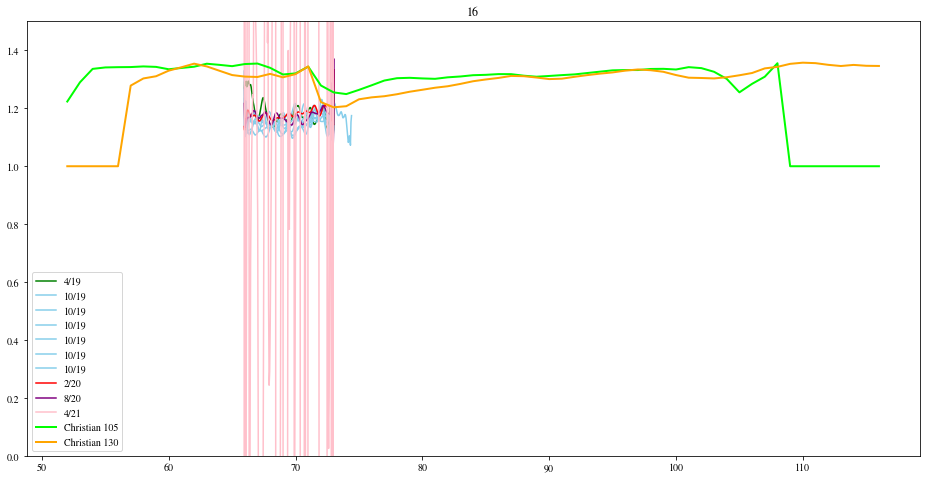

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 17


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

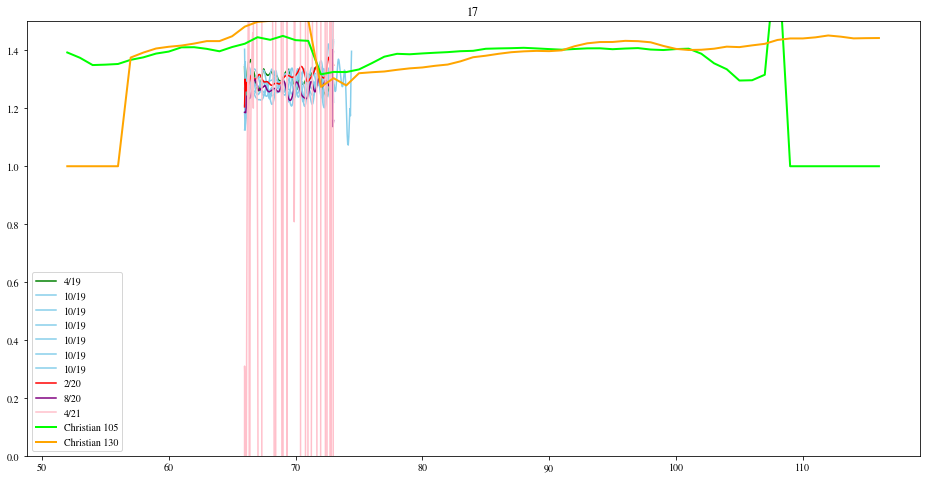

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 18


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

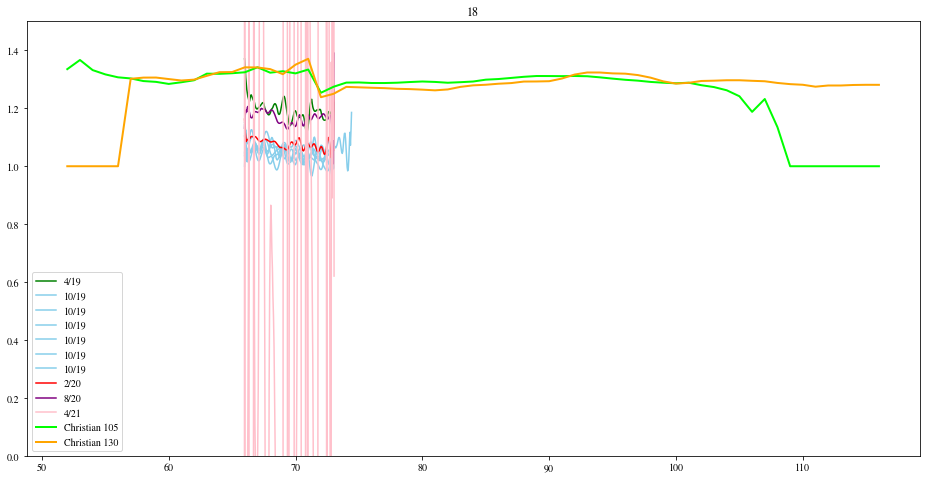

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 19


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

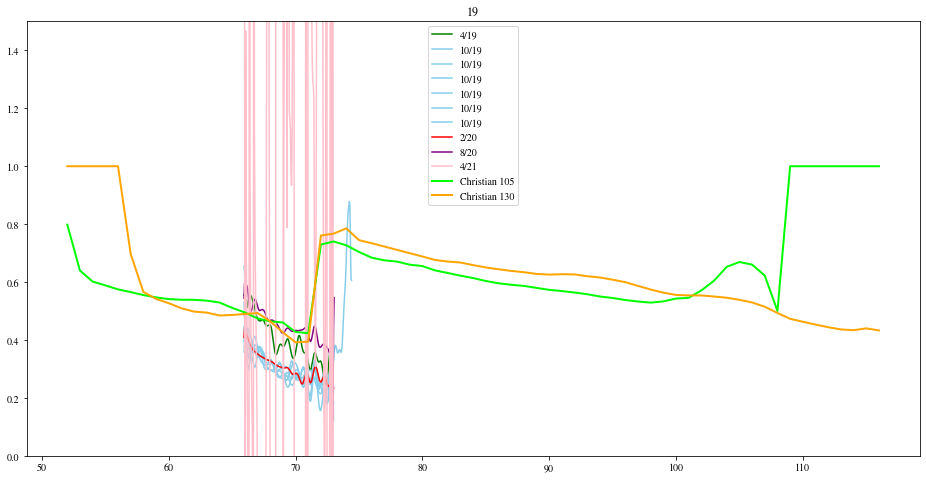

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 20


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

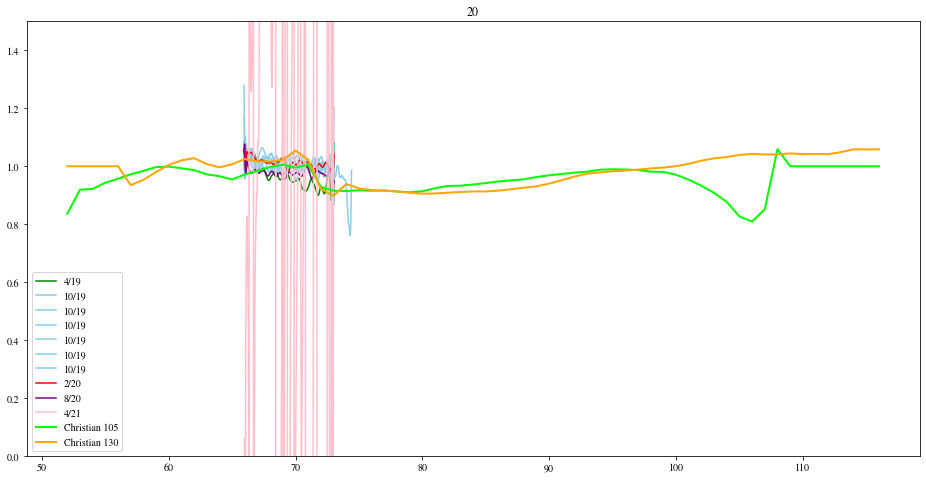

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 21


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

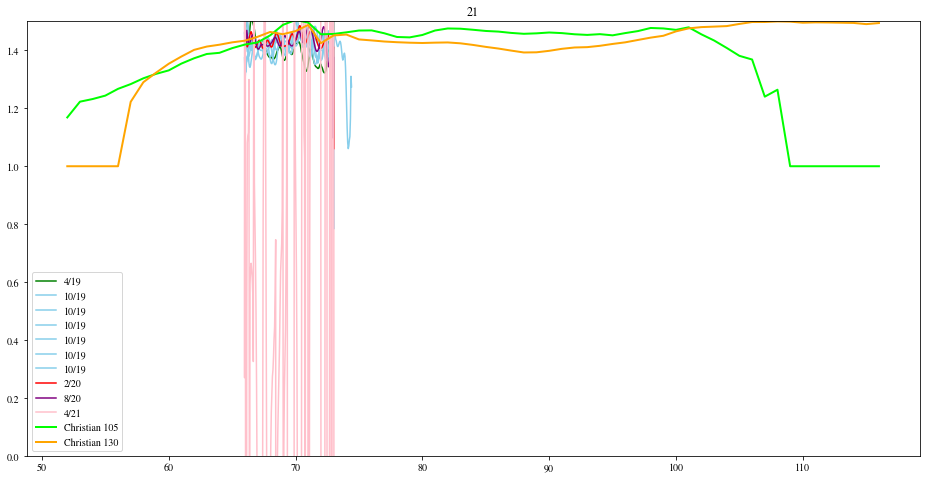

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 22


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

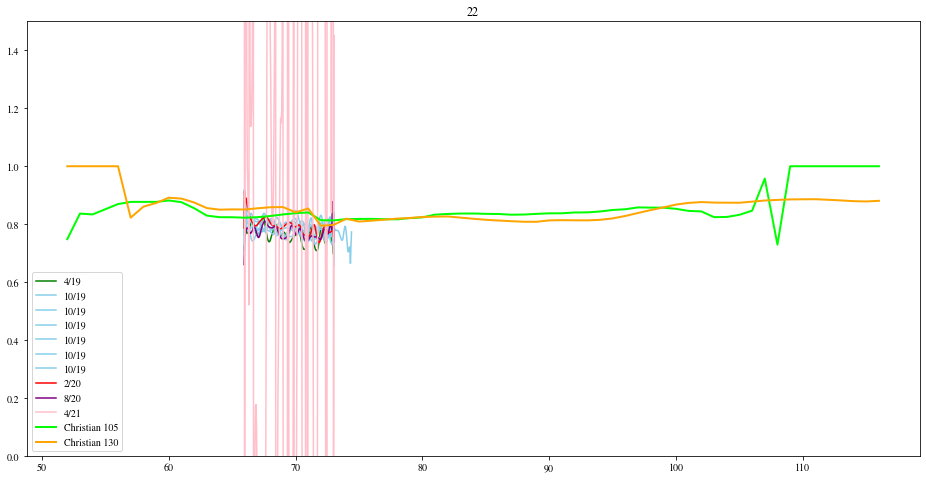

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 23


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

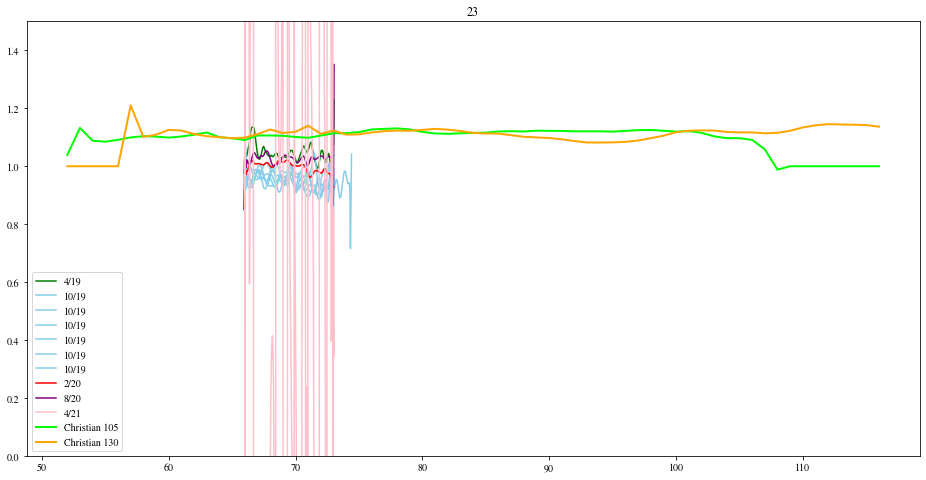

date  4/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  10/19
date  2/20
date  8/20
date  4/21
plotting spaxel 24


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

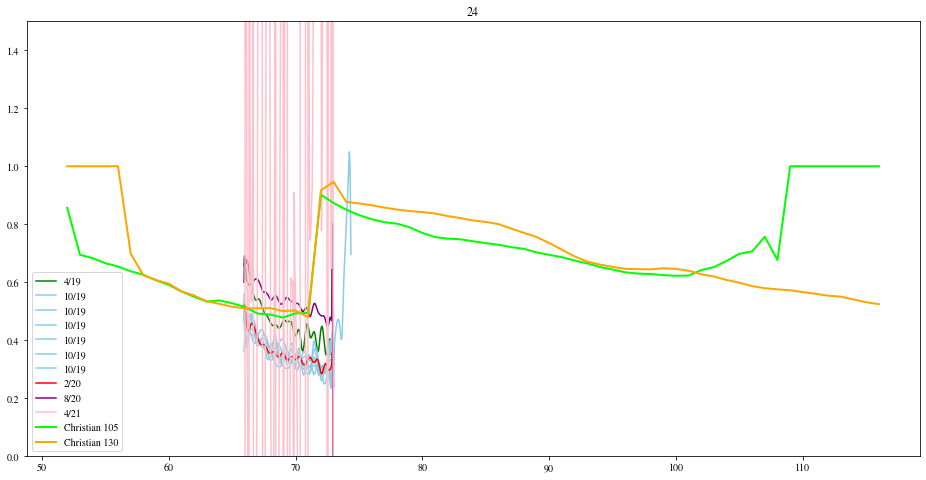

In [65]:
# Plot of  median spaxel spectra over median total spectra (except bad illuminated column)
from fifipy.stats import biweightLocation

colors = ['skyblue','red','green','pink','purple','violet','black']
print('dates ' , dates)
print('dates2 ', dates2)
udates = np.unique(dates)
print('unique dates', udates)
ndates = len(udates)
ssi = []
for i in range(ndates):
    ssi.append(np.ones(25))

print(np.shape(waves2), np.shape(spatspectra2), len(dates2), len(dichroics2))
    
#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,2,3,6,7,8,11,12,13,16,17,20,21,22]
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    mm = []
    for i in range(ndates):
        mm.append([])
    for w, s, d, dic in zip(waves2, spatspectra2, dates2, dichroics2):
        print('date ',d)
        meds = biweightLocation(s[mask,:], axis = 0)
        idw = (w > 60) & (w < 80)
        #print('medw ',meds[idw])
        m = biweightLocation(s[ispax,idw]/meds[idw])
        #print('m is ',m)
        for ud, mi, c in zip(udates, mm, colors):
            if d == ud:
                color = c
        if dic == 105:
            line = '-'
        else:
            line = '--'
        ax.plot(w, s[ispax,:]/meds, line, label = d, color=color)
    ax.plot(wch, ff105[:,ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax],color='orange',label='Christian 130',linewidth=2)
    ax.legend()
    print('plotting spaxel '+str(ispax))
    ax.set_title(str(ispax))
    for m, col, s in zip(mm,colors,ssi):
        m = np.array(m)
        medm = np.nanmedian(m)
        if np.isfinite(medm):
            ax.set_ylim(medm-0.5, medm+0.5)
            ax.plot(w, np.full(len(w), medm), color=col)
            s[ispax] = medm
        else:
            s[ispax] = 1.
    plt.ylim(0.,1.5)
    plt.show()


In [42]:
dec = 0.011
print('+'*(dec >=0))

+


In [49]:
from astropy.coordinates import SkyCoord
from astropy import units as u
xdec =  -(0+28/60+44/3600.)
xra = 15*(10+2/60.+30/3600.)
c = SkyCoord(ra=xra, dec=xdec, unit="deg")
sra = c.ra.to_string(unit=u.hourangle, sep=' ', precision=2, pad=True)
sdec = c.dec.to_string(sep=' ', precision=1, alwayssign=True, pad=True)
print(sra, sdec)

10 02 30.00 -00 28 44.0
